In [ ]:
# We install darts
!pip install u8darts[torch] --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.6/200.6 kB 16.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.1/823.1 kB 48.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.4/354.4 kB 30.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 52.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 41.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 38.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Necessary imports to read the datasets
import pandas as pd
import zipfile
import os
import numpy as np
import matplotlib.pyplot as plt
import joblib
from darts import TimeSeries
from darts.models import RNNModel
from darts.dataprocessing.transformers import Scaler
import torch

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import joblib

# Load the saved data
loaded_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_train_standard.pkl')

# Extract the components
scaled_train_series = loaded_data['train']        # dict of TimeSeries objects
scaled_val_series = loaded_data['validation']     # dict of TimeSeries objects
scalers = loaded_data['scalers']                  # dict of Scaler objects

# Get the sorted meter IDs
meter_ids = sorted(scaled_train_series.keys())

# Build aligned lists
train_series_scaled = [scaled_train_series[meter_id] for meter_id in meter_ids]
val_series_scaled = [scaled_val_series[meter_id] for meter_id in meter_ids]

print(f"Loaded {len(train_series_scaled)} time series for training.")
print(f"Loaded {len(val_series_scaled)} time series for validation.")

Loaded 908 time series for training.
Loaded 908 time series for validation.


In [ ]:
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

# We sstop training when validation loss does not decrease more than 0.05 (`min_delta`) over
# a period of 5 epochs (`patience`)
my_stopper = EarlyStopping(
    monitor="val_loss",
    patience=15,
    min_delta=1e-4,
    mode="min"
)

In [ ]:
from darts.models import RNNModel
from darts.utils.likelihood_models import QuantileRegression

quantiles = [0.05, 0.5, 0.95]

gru_model = RNNModel(
    model="GRU",
    input_chunk_length=60,
    training_length=67,
    hidden_dim=32,
    n_rnn_layers=2,
    dropout=0.1,
    batch_size=32,
    n_epochs=20,
    optimizer_kwargs={'lr': 1e-3},
    model_name="gru_7day_forecast",
    likelihood=QuantileRegression(quantiles=quantiles),
    force_reset=True,
    save_checkpoints=True,
    pl_trainer_kwargs={
        "accelerator": "gpu",
        "devices": 1,
        "callbacks": [my_stopper]
    }
)


In [ ]:
gru_model.fit(
    series=train_series_scaled,
    val_series=val_series_scaled,
    verbose=True
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | MSELoss          | 0      | train
1 | train_criterion | MSELoss          | 0      | train
2 | val_criterion   | MSELoss          | 0      | train
3 | train_metrics   | MetricCollection | 0      | train
4 | val_metrics     | MetricCollection | 0      | train
5 | rnn             | GRU              | 9.7 K  | train
6 | V               | Linear           | 99     | train
-------------------------------------------------------------
9.8 K     Trainable params
0         Non-trainable p

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


RNNModel(model=GRU, hidden_dim=32, n_rnn_layers=2, dropout=0.1, training_length=67, input_chunk_length=60, batch_size=32, n_epochs=20, optimizer_kwargs={'lr': 0.001}, model_name=gru_7day_forecast, likelihood=QuantileRegression(quantiles=[0.05, 0.5, 0.95], prior_strength=1.0), force_reset=True, save_checkpoints=True, pl_trainer_kwargs={'accelerator': 'gpu', 'devices': 1, 'callbacks': [<pytorch_lightning.callbacks.early_stopping.EarlyStopping object at 0x7be9aeac7390>]})

In [ ]:
val_loss = gru_model.model.trainer.logged_metrics['val_loss'].item()
print("Final validation loss:", val_loss)


Final validation loss: 0.30211406615333025


In [ ]:
gru_model.save("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/rnnGRU/simple/rnnGRU_model_standard.pkl")

In [ ]:
# Let's load the model
from darts.models import RNNModel

# Load the trained GRU model
gru_model = RNNModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/rnnGRU/simple/rnnGRU_model_standard.pkl")

In [ ]:
# Let's train more epochs, because we ran out of GPU
gru_model.n_epochs = 15  # new number of epochs for this round
gru_model.force_reset = False  # prevent reinitialization
gru_model.pl_trainer_kwargs = {
    "accelerator": "gpu",
    "devices": 1
}

gru_model.fit(
    series=train_series_scaled,
    val_series=val_series_scaled,
    verbose=True
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

RNNModel(model=GRU, hidden_dim=64, n_rnn_layers=2, dropout=0.1, training_length=67, input_chunk_length=60, batch_size=32, n_epochs=15, optimizer_kwargs={'lr': 0.001}, model_name=gru_7day_forecast, likelihood=QuantileRegression(quantiles=[0.05, 0.5, 0.95], prior_strength=1.0), random_state=42, force_reset=True, save_checkpoints=True, pl_trainer_kwargs={'accelerator': 'gpu', 'devices': 1, 'callbacks': [<pytorch_lightning.callbacks.early_stopping.EarlyStopping object at 0x7f9091ca1890>]})

In [ ]:
gru_model.save("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/rnnGRU/simple/rnnGRU_model_standard.pkl")

In [ ]:
# Let's start testing with the min max scaling

In [ ]:
from darts import concatenate, metrics
from darts.models import RNNModel
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)


In [ ]:
model = RNNModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/rnnGRU/simple/rnnGRU_model.pkl")
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test.pkl')
print(test_data.keys())

# We extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [ ]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# Loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=1,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=1,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})
    print(f"\nResults for meter {meter_id}:\n", df_results)

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801501002_Badalona:
    Interval  Coverage      Width
0       0.9  0.928571  15.806639


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801503008_Badalona:
    Interval  Coverage      Width
0       0.9  0.892857  21.467086


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801901042_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  3.232819


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  1.616068


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902037_Barcelona:
    Interval  Coverage    Width
0       0.9  0.982143  2.33135


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902052_Barcelona:
    Interval  Coverage     Width
0       0.9  0.464286  2.459891


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902102_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  2.034363


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903006_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  2.507059


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  0.565096


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903040_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  0.801196


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903048_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  3.455939


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903060_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  3.560545


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903067_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  0.770785


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903081_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  1.901443


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904008_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  5.584755


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904030_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  2.891232


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905054_Barcelona:
    Interval  Coverage      Width
0       0.9  0.910714  12.519896


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905091_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  4.644448


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906002_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  1.997771


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906010_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  5.735088


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906041_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  5.022778


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907003_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  1.385548


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907011_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  2.632464


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907013_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  1.715648


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907025_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  6.169718


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  3.360502


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907084_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  7.551192


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907088_Barcelona:
    Interval  Coverage    Width
0       0.9      0.75  4.85534


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907115_Barcelona:
    Interval  Coverage      Width
0       0.9  0.928571  12.843222


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908002_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  2.652622


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908022_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  1.911972


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908043_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  0.596831


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908046_Barcelona:
    Interval  Coverage     Width
0       0.9  0.714286  2.128143


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908049_Barcelona:
    Interval  Coverage      Width
0       0.9  0.910714  12.562216


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908061_Barcelona:
    Interval  Coverage    Width
0       0.9  0.839286  0.94106


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908088_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  3.772902


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908111_Barcelona:
    Interval  Coverage     Width
0       0.9  0.767857  7.127796


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801909015_Barcelona:
    Interval  Coverage     Width
0       0.9       0.5  4.127561


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801909017_Barcelona:
    Interval  Coverage     Width
0       0.9  0.982143  6.914041


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910053_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  4.416731


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910054_Barcelona:
    Interval  Coverage     Width
0       0.9  0.714286  2.351257


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910080_Barcelona:
    Interval  Coverage     Width
0       0.9  0.660714  0.956992


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910092_Barcelona:
    Interval  Coverage     Width
0       0.9     0.625  1.026306


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910119_Barcelona:
    Interval  Coverage     Width
0       0.9  0.803571  0.680743


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910235_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  0.701772


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  5.641454


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101041_Hospitalet:
    Interval  Coverage     Width
0       0.9       1.0  2.916828


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.678571  4.744743


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102008_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  1.947178


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102017_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  4.364686


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102033_Hospitalet:
    Interval  Coverage      Width
0       0.9  0.785714  10.255167


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  7.733881


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  3.607179


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104040_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.821429  1.20109


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105003_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  0.588329


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105026_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  3.739843


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105032_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  4.176895


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106012_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  1.630658


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106013_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  1.893309


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  1.596044


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")


Mean Coverage: 0.8589
Mean Width: 4.1721


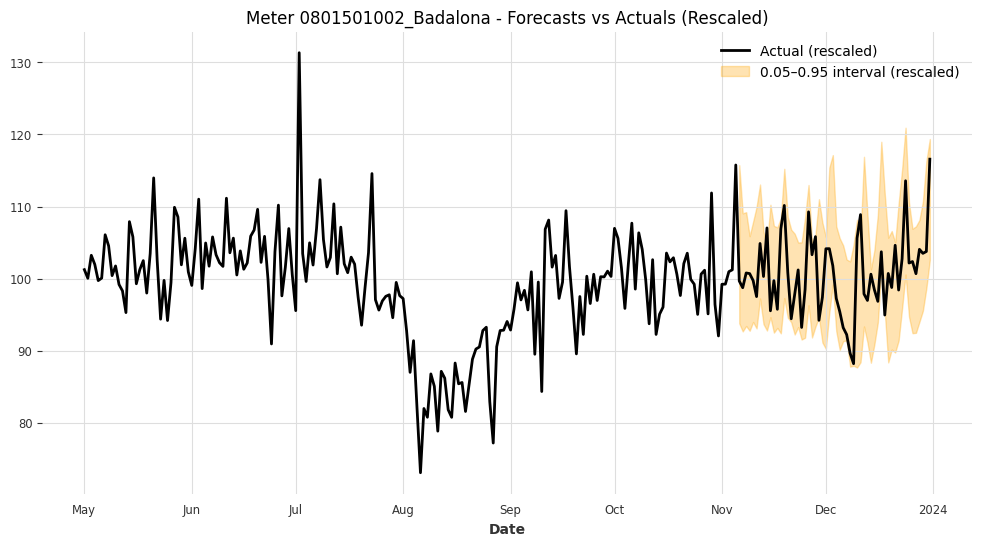

Meter 0801501002_Badalona - Coverage: 0.9286, Mean Interval Width (rescaled): 15.8066



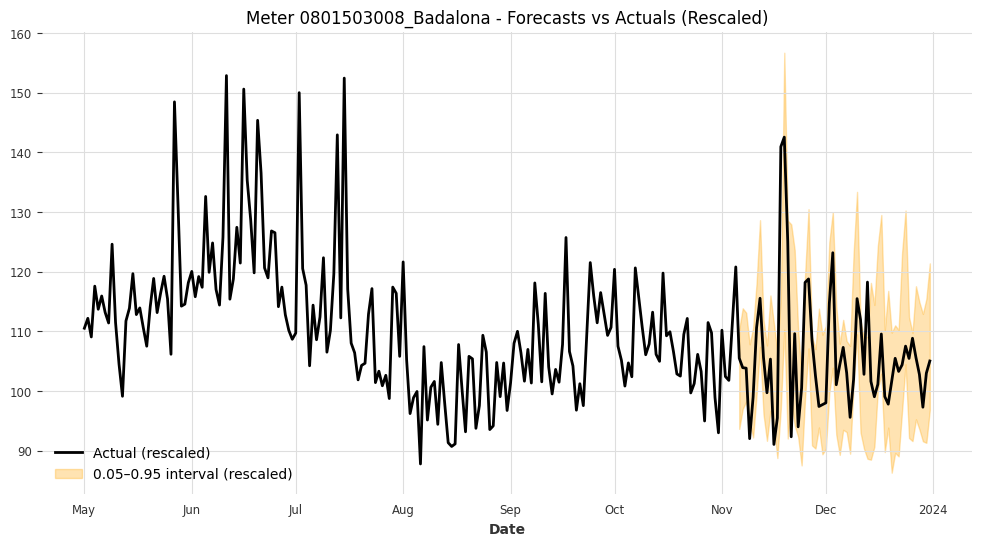

Meter 0801503008_Badalona - Coverage: 0.8929, Mean Interval Width (rescaled): 21.4671



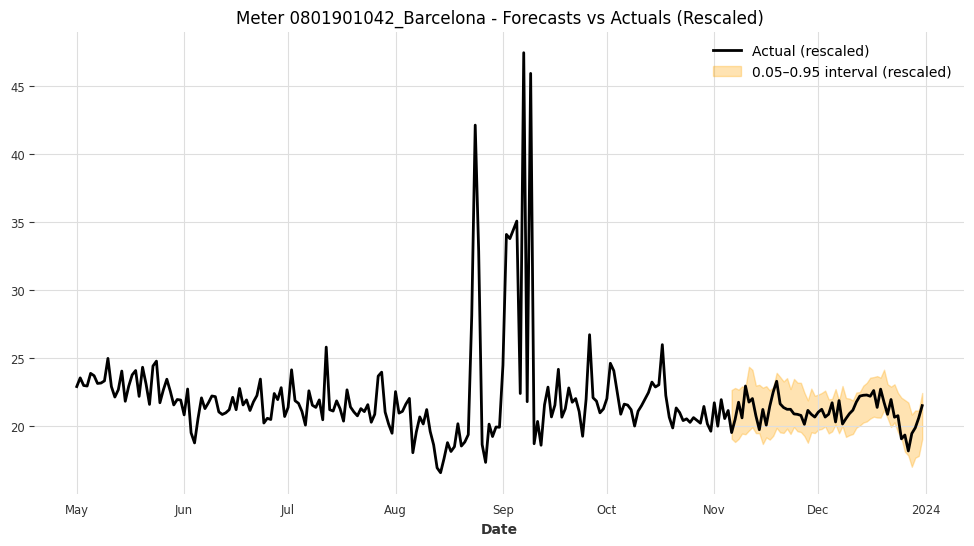

Meter 0801901042_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 3.2328



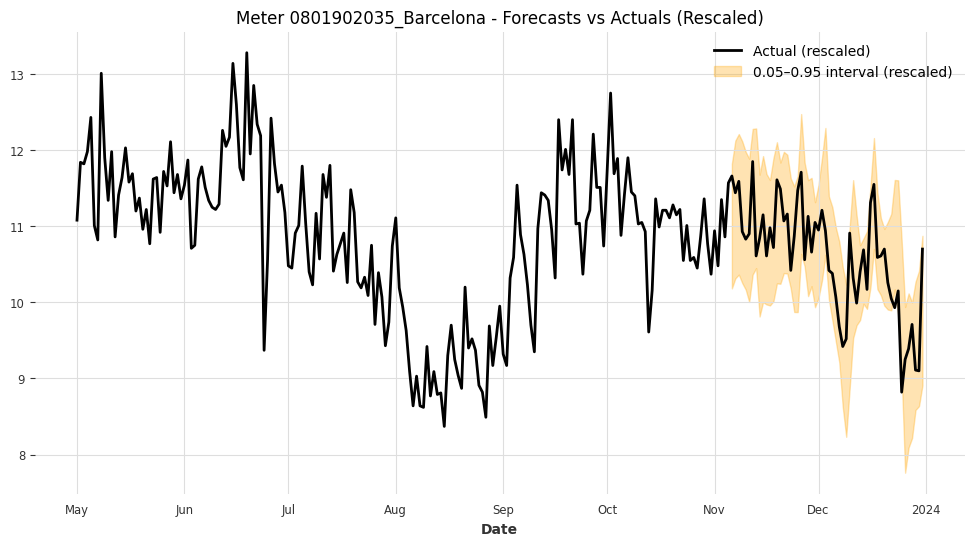

Meter 0801902035_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 1.6161



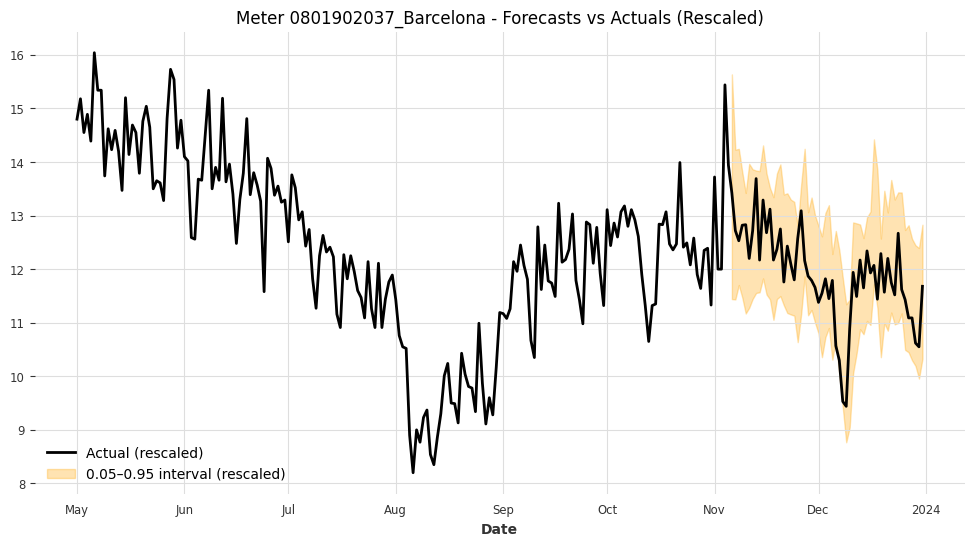

Meter 0801902037_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 2.3313



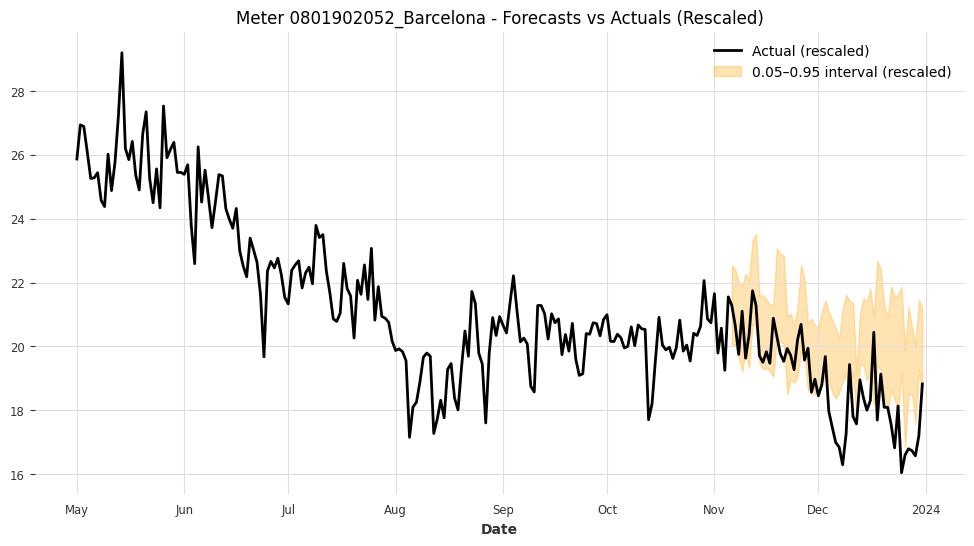

Meter 0801902052_Barcelona - Coverage: 0.4643, Mean Interval Width (rescaled): 2.4599



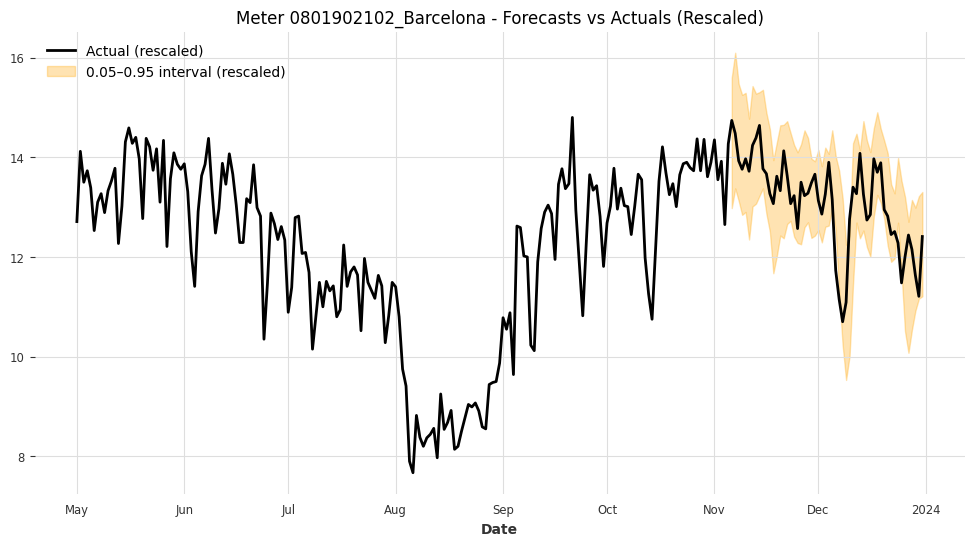

Meter 0801902102_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 2.0344



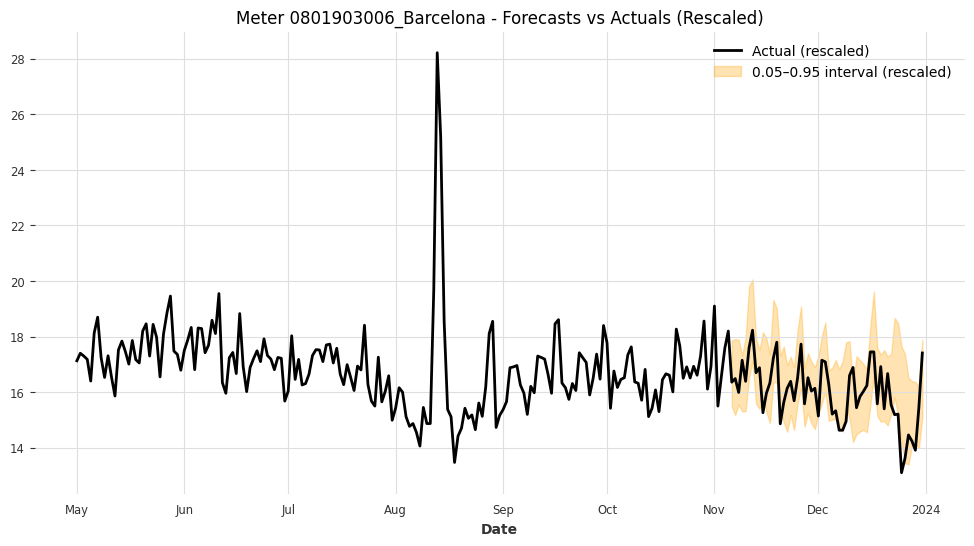

Meter 0801903006_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 2.5071



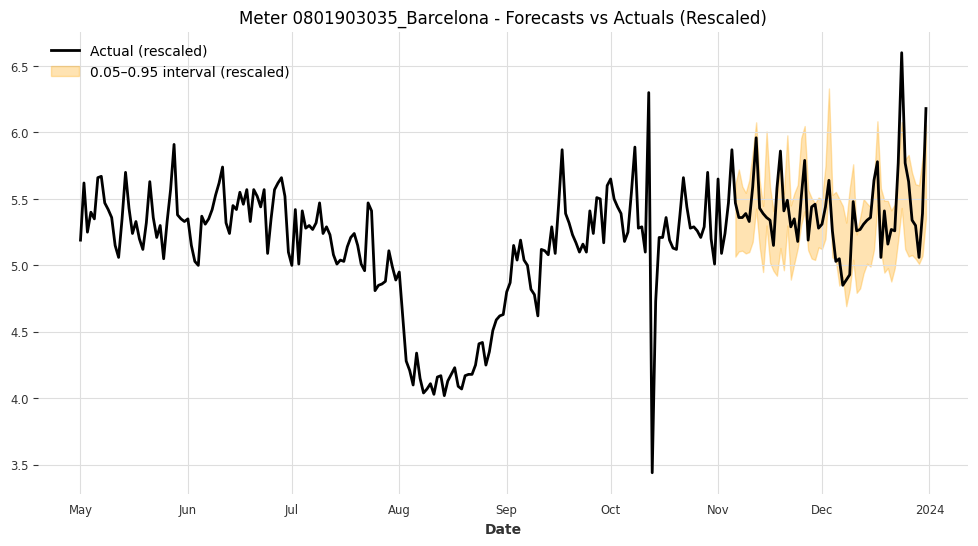

Meter 0801903035_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 0.5651



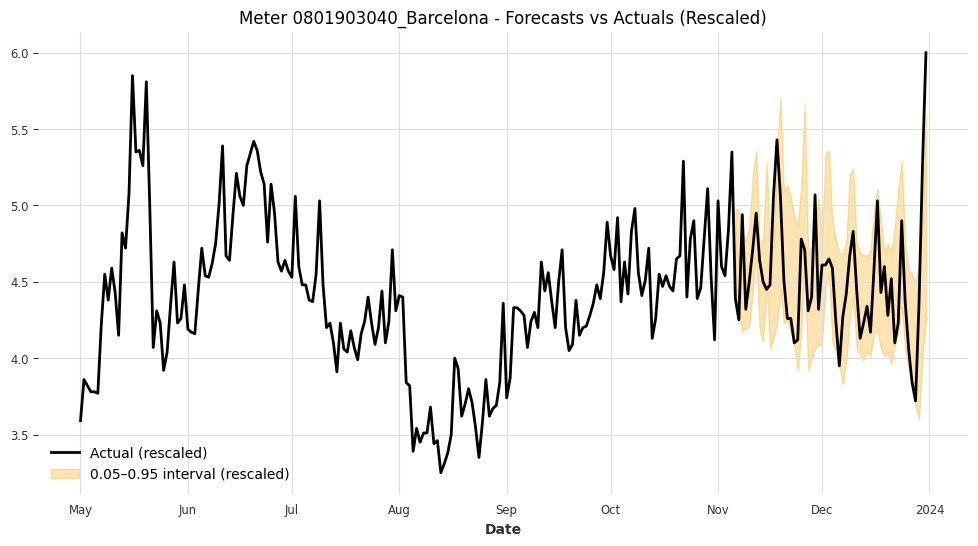

Meter 0801903040_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 0.8012



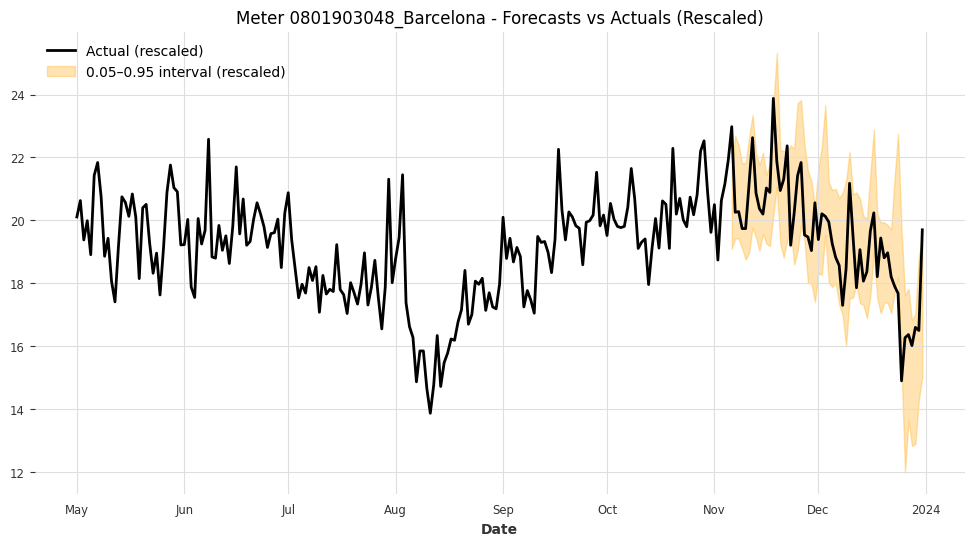

Meter 0801903048_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 3.4559



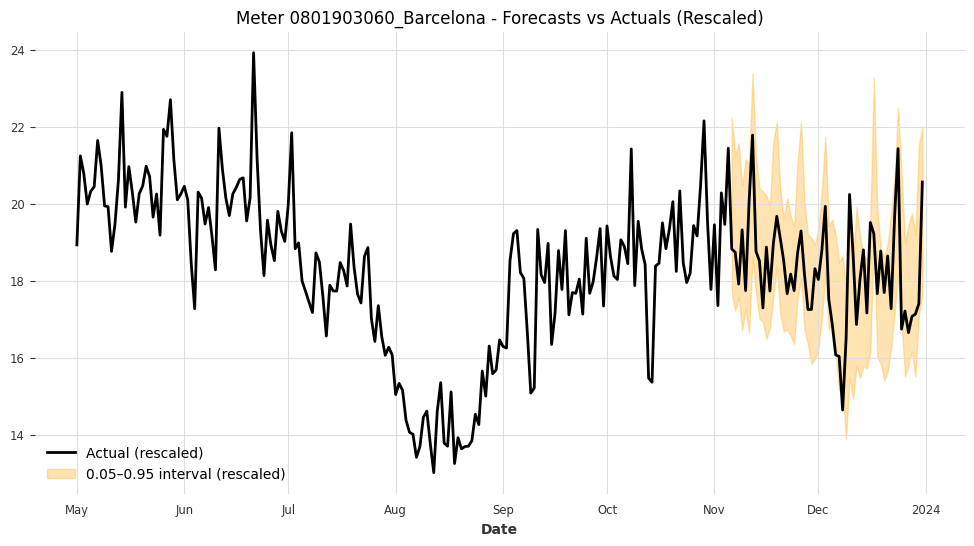

Meter 0801903060_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 3.5605



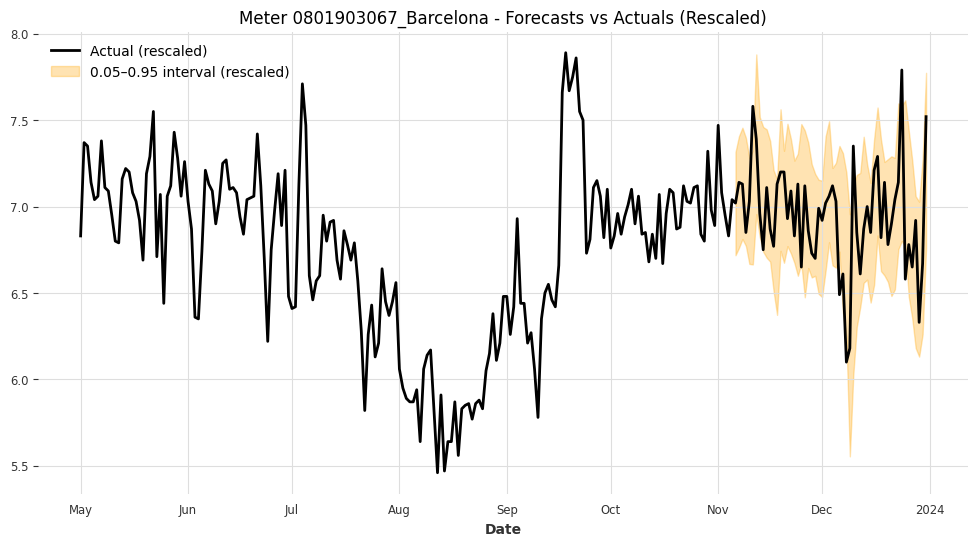

Meter 0801903067_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 0.7708



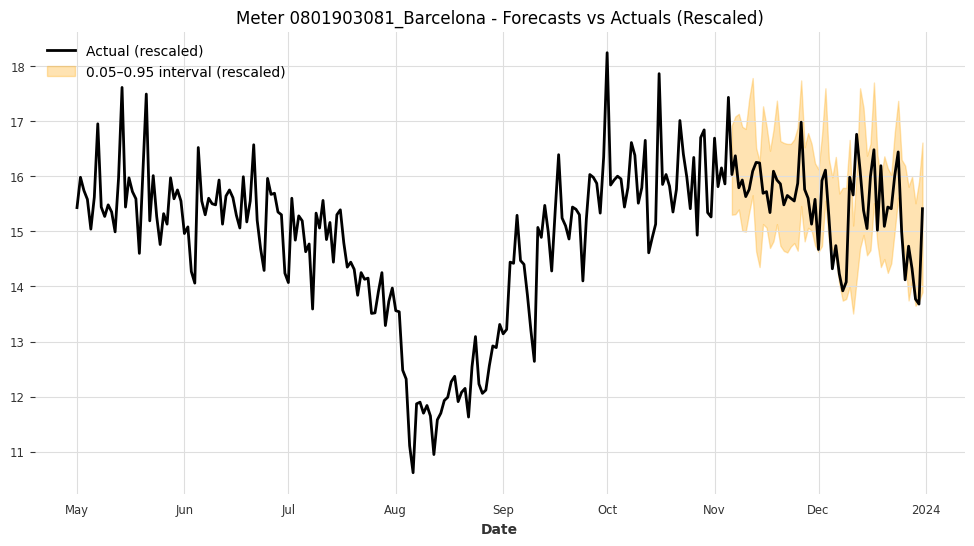

Meter 0801903081_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 1.9014



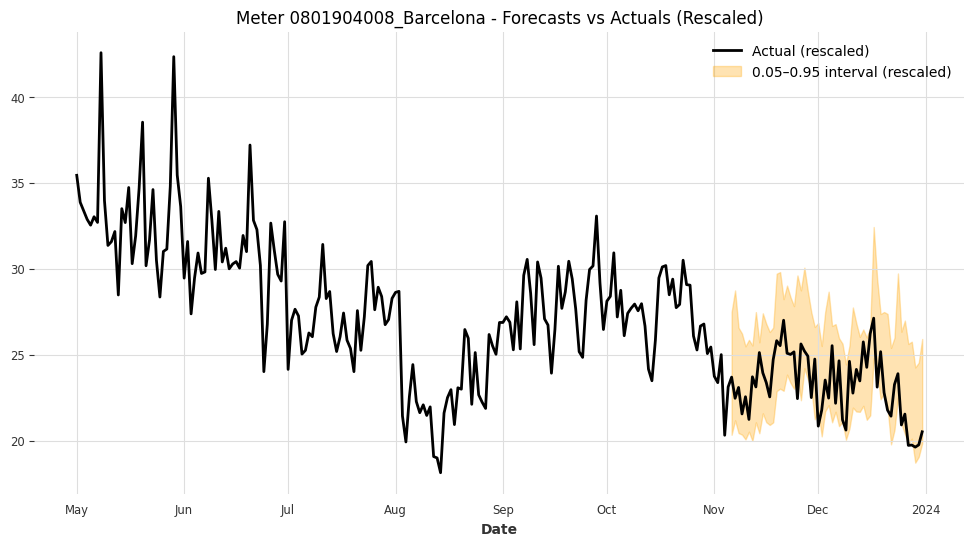

Meter 0801904008_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 5.5848



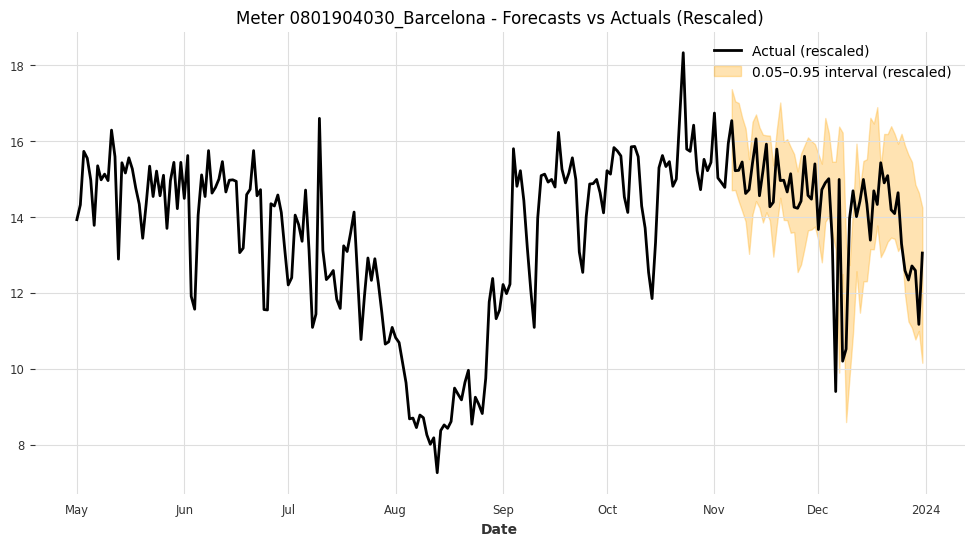

Meter 0801904030_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 2.8912



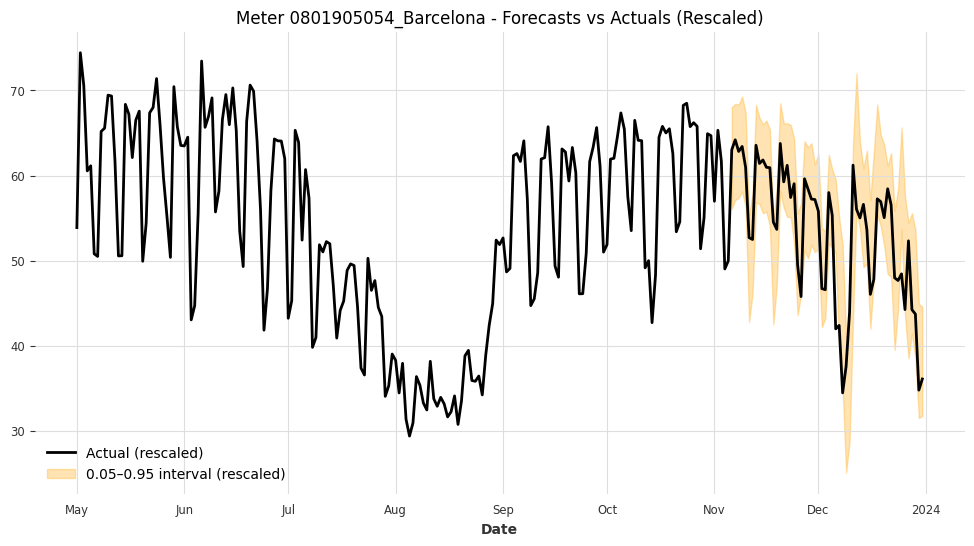

Meter 0801905054_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 12.5199



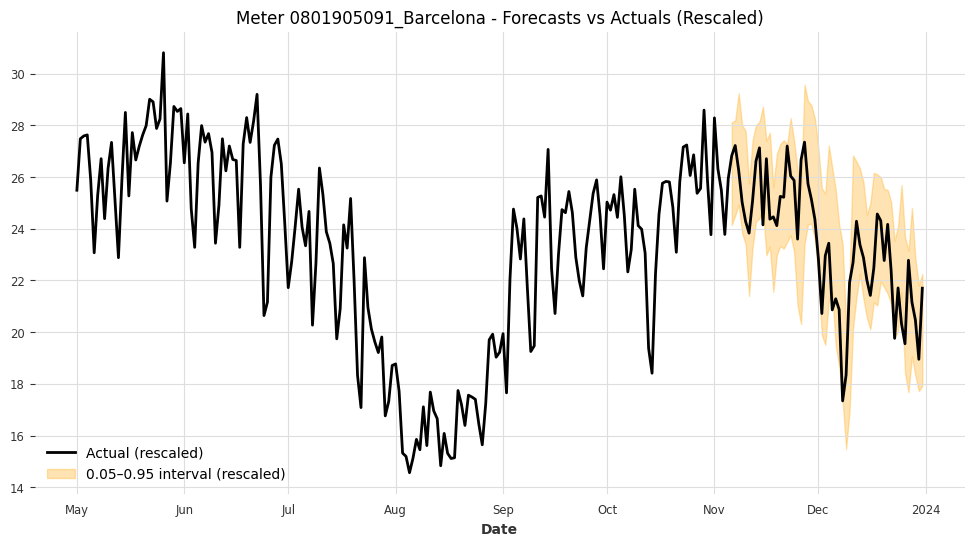

Meter 0801905091_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 4.6444



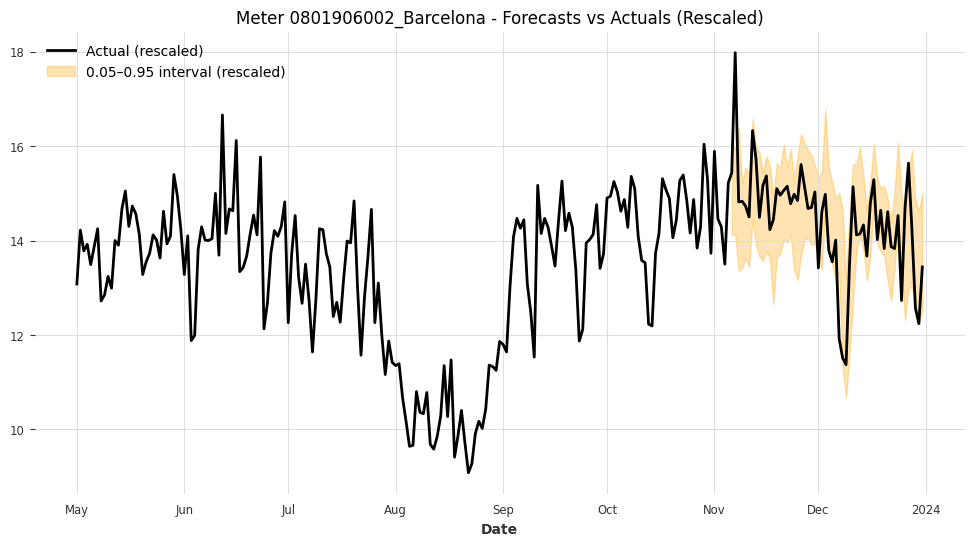

Meter 0801906002_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 1.9978



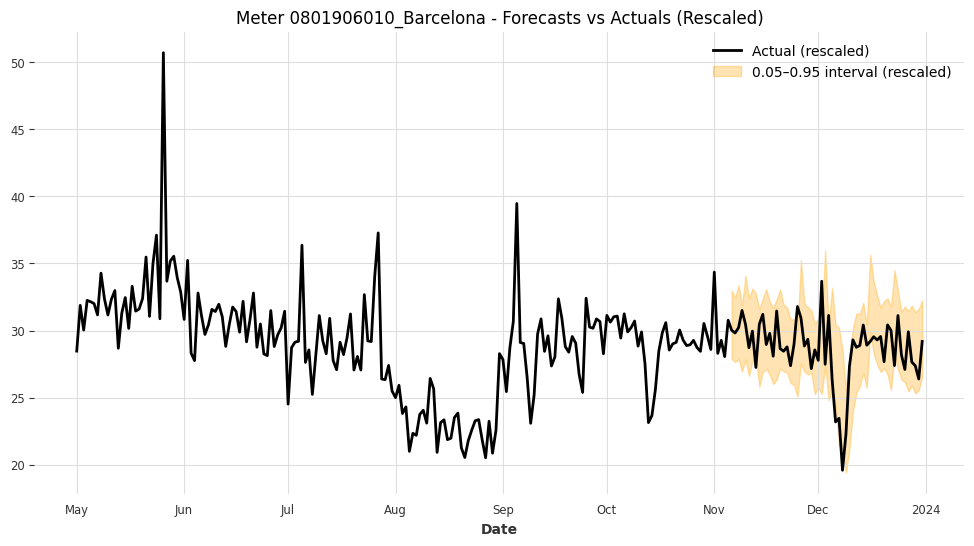

Meter 0801906010_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 5.7351



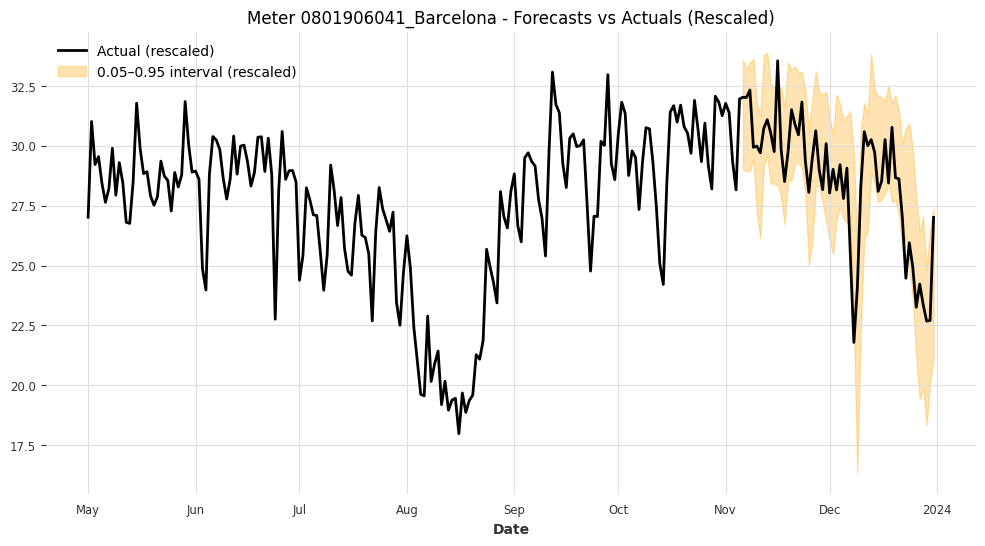

Meter 0801906041_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 5.0228



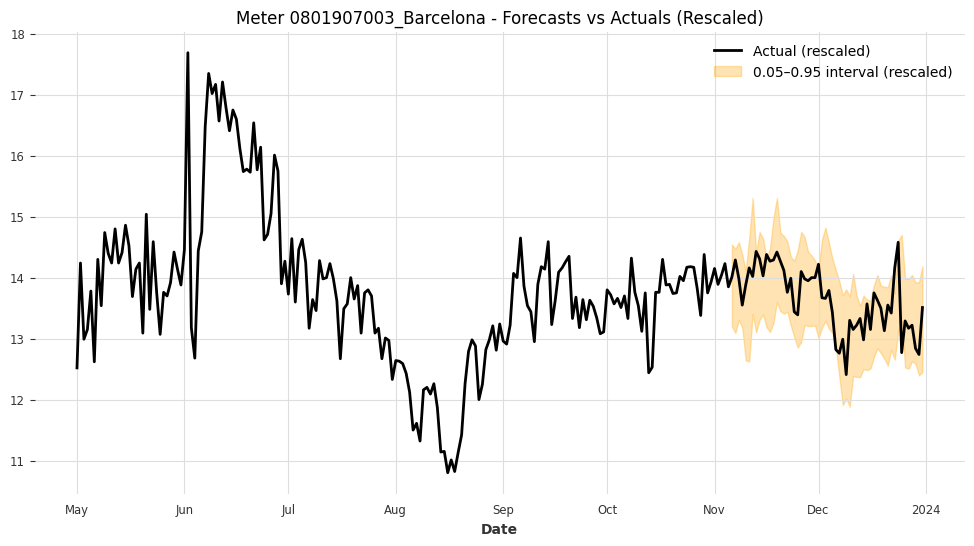

Meter 0801907003_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 1.3855



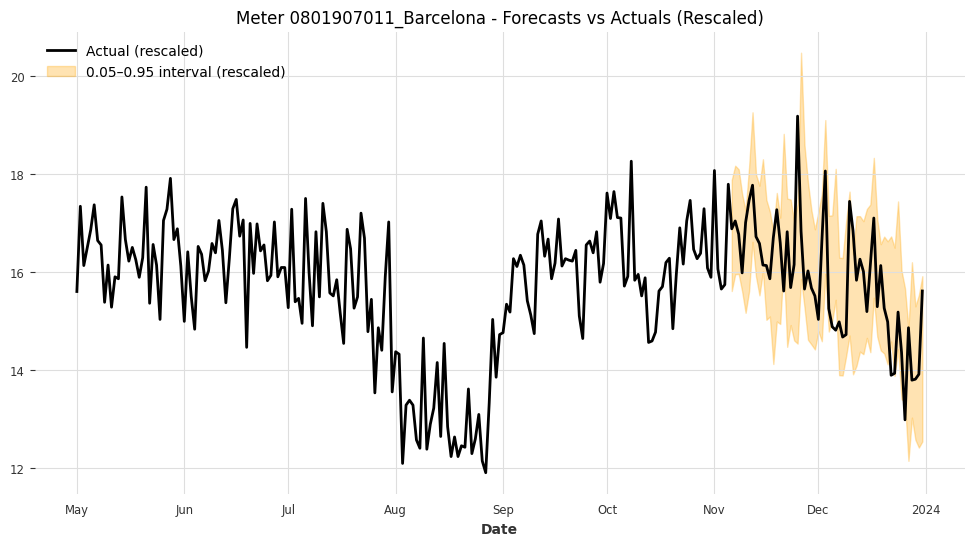

Meter 0801907011_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 2.6325



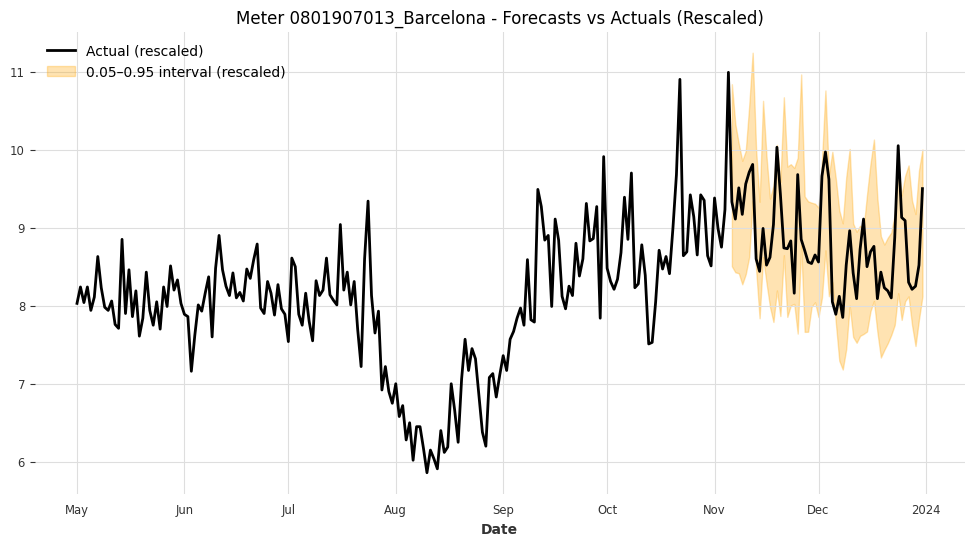

Meter 0801907013_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 1.7156



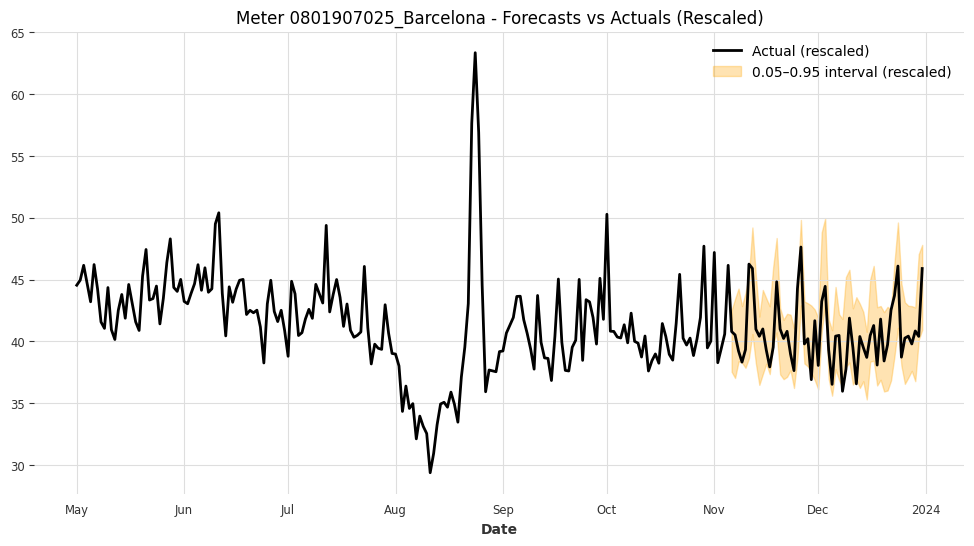

Meter 0801907025_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 6.1697



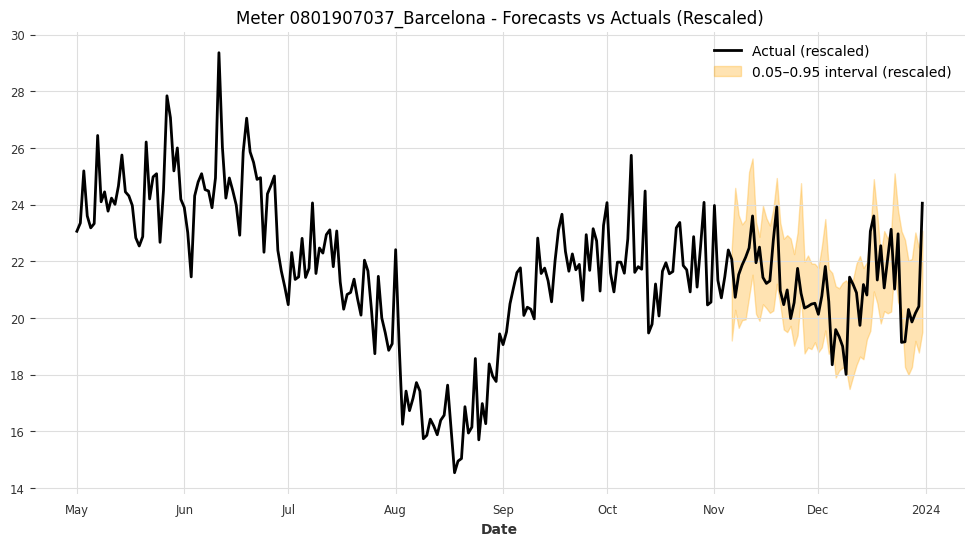

Meter 0801907037_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 3.3605



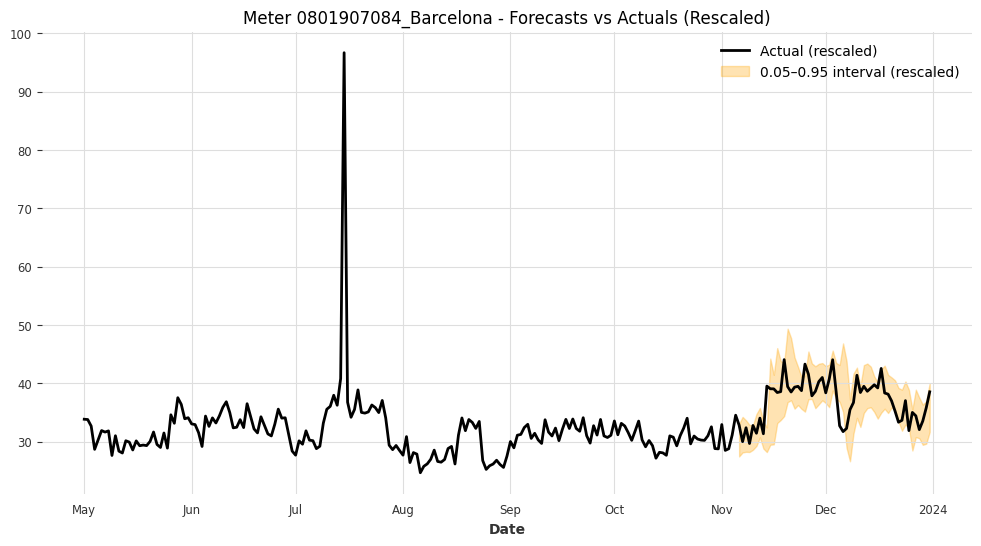

Meter 0801907084_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 7.5512



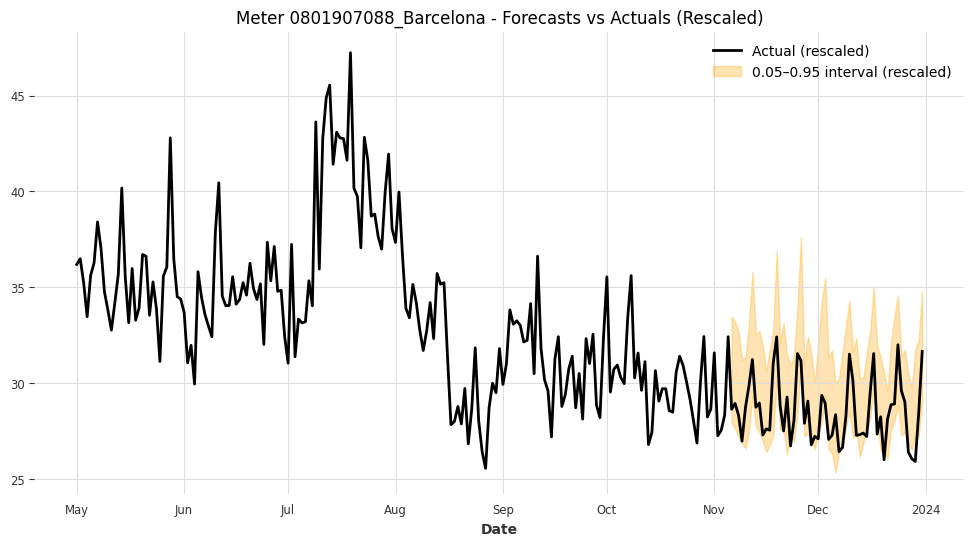

Meter 0801907088_Barcelona - Coverage: 0.7500, Mean Interval Width (rescaled): 4.8553



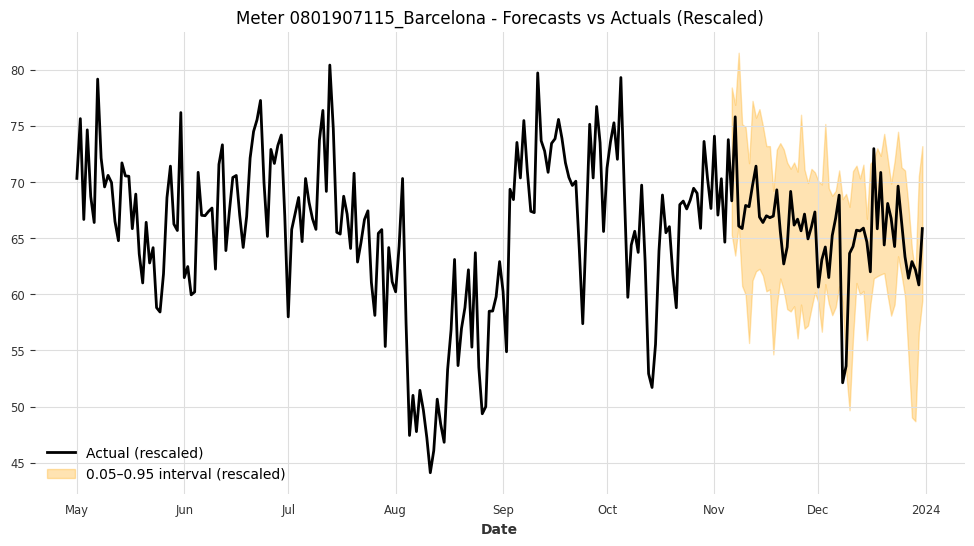

Meter 0801907115_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 12.8432



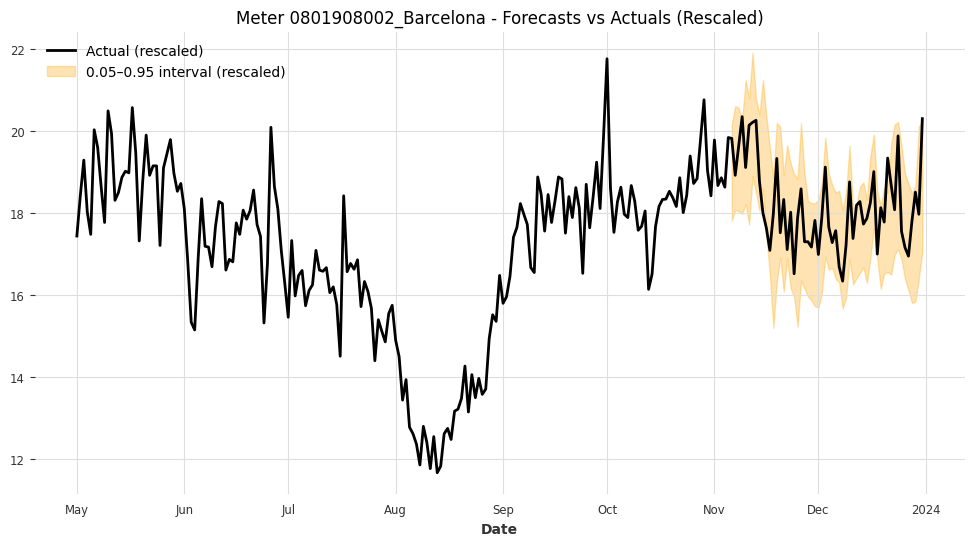

Meter 0801908002_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 2.6526



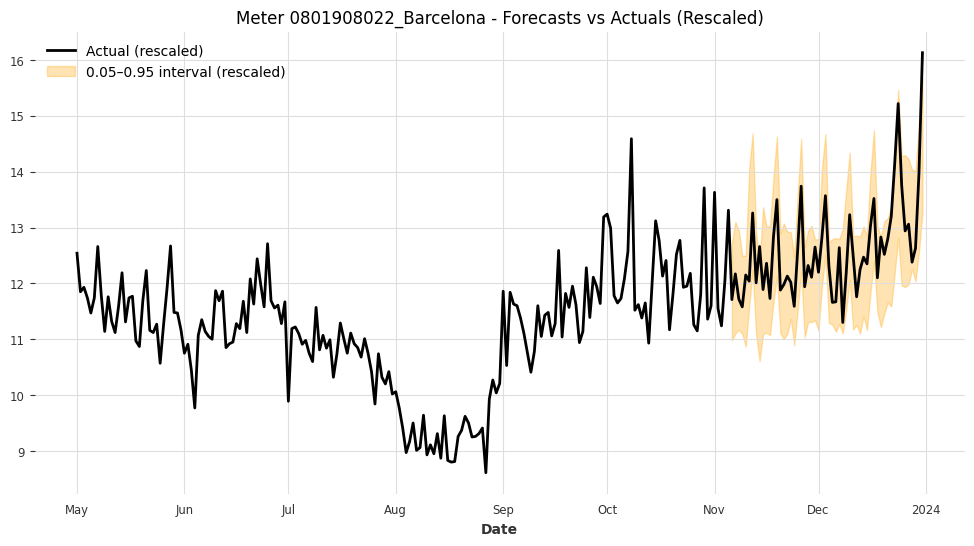

Meter 0801908022_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 1.9120



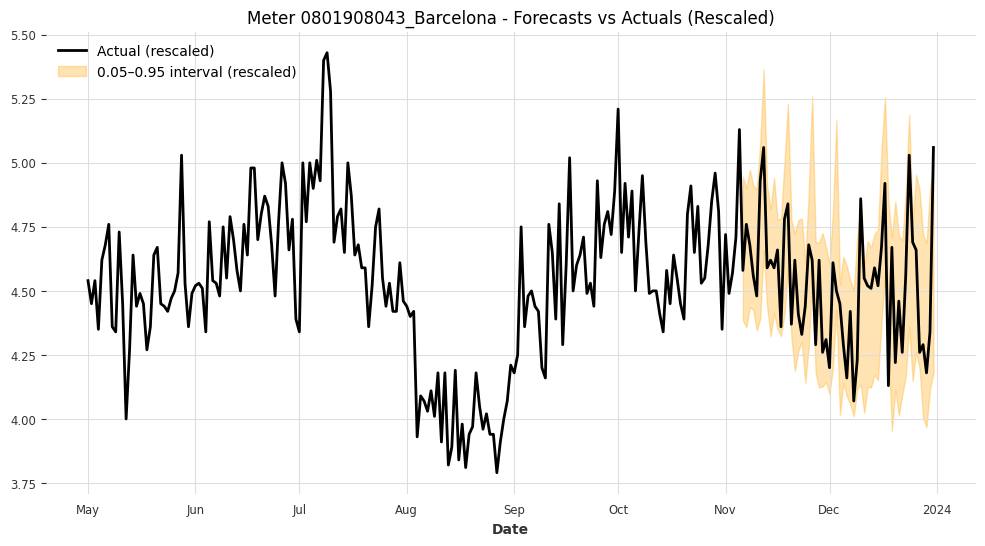

Meter 0801908043_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 0.5968



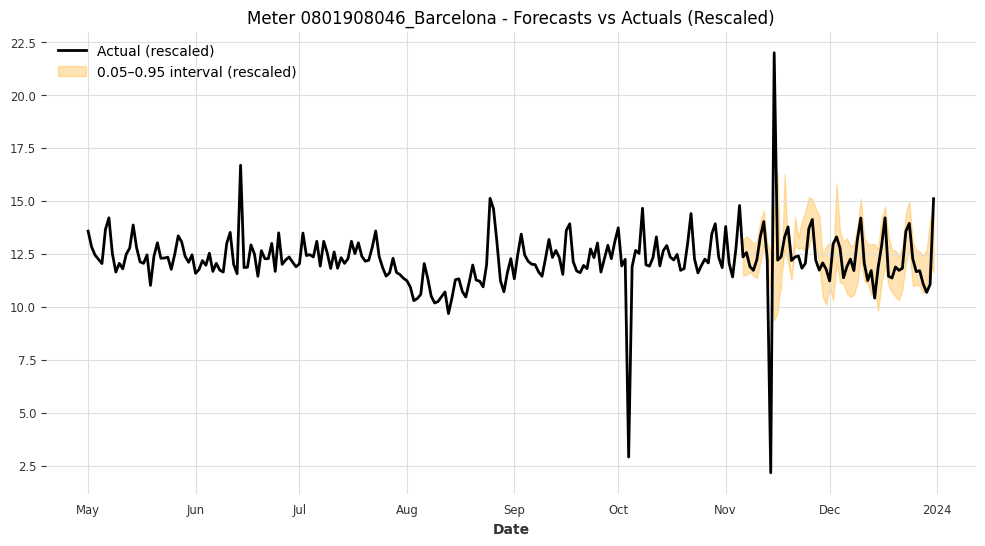

Meter 0801908046_Barcelona - Coverage: 0.7143, Mean Interval Width (rescaled): 2.1281



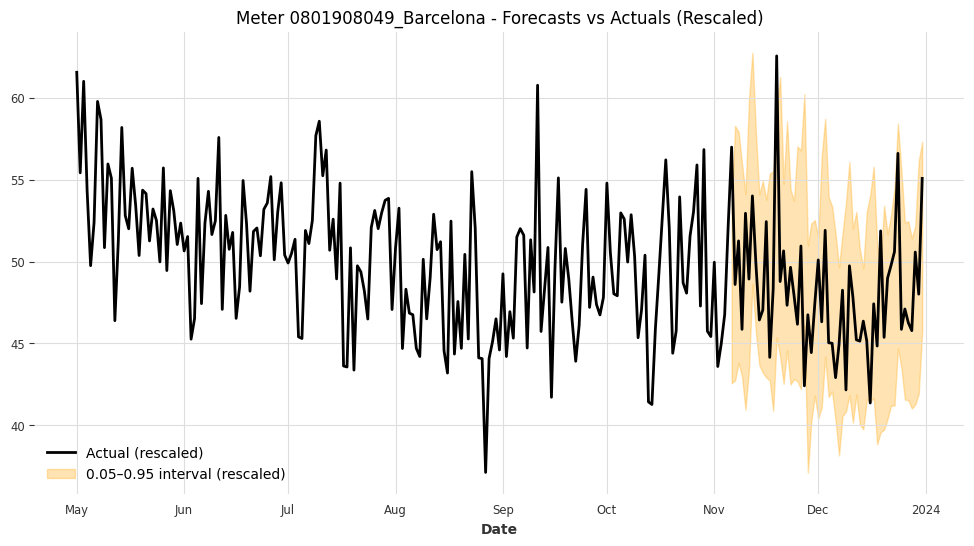

Meter 0801908049_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 12.5622



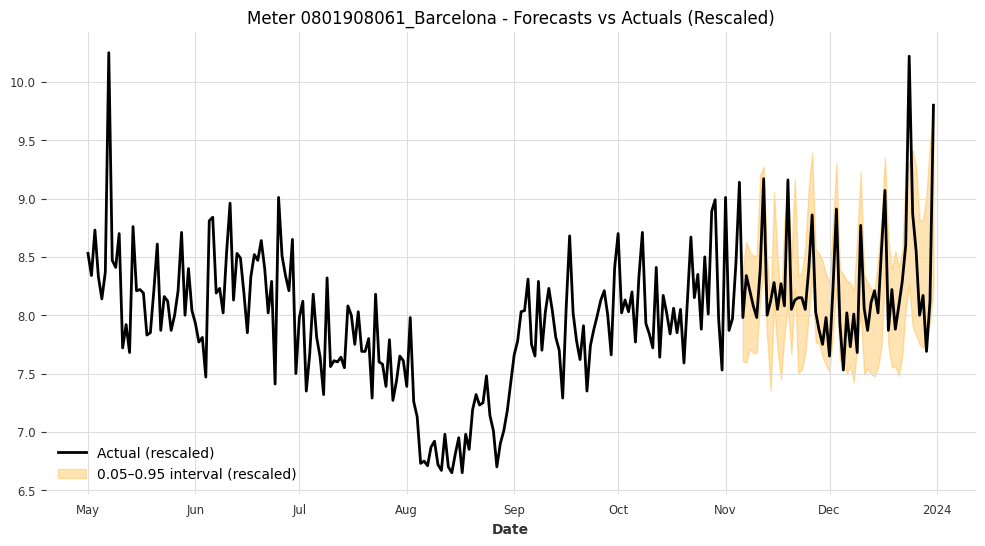

Meter 0801908061_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 0.9411



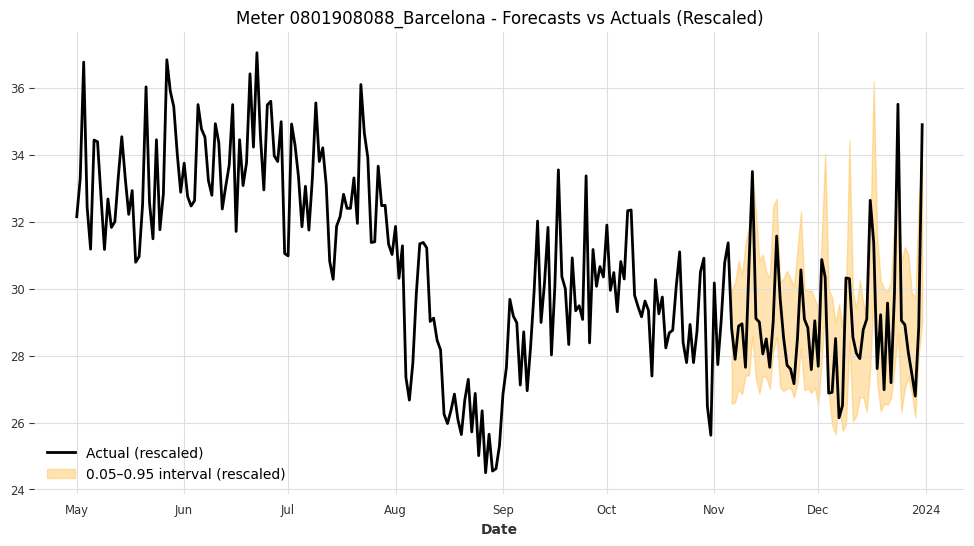

Meter 0801908088_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 3.7729



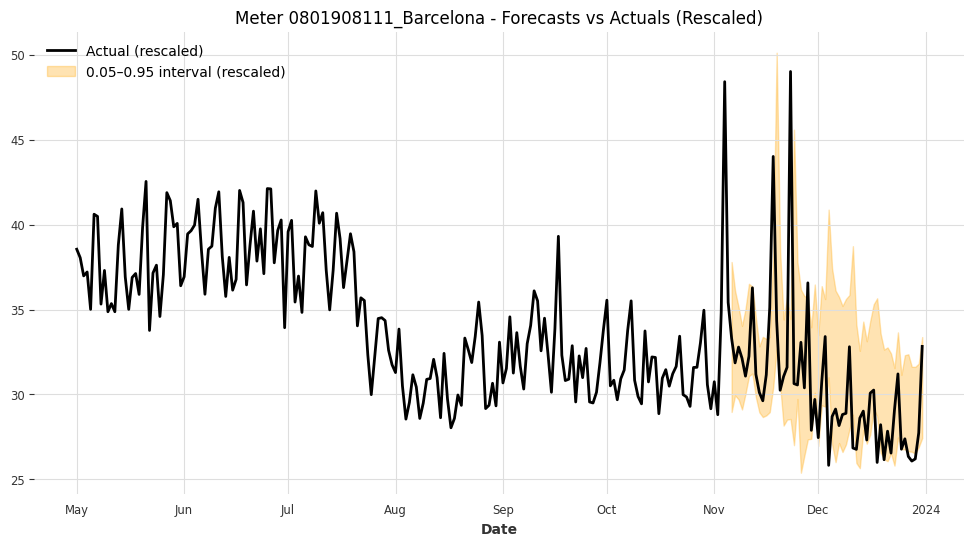

Meter 0801908111_Barcelona - Coverage: 0.7679, Mean Interval Width (rescaled): 7.1278



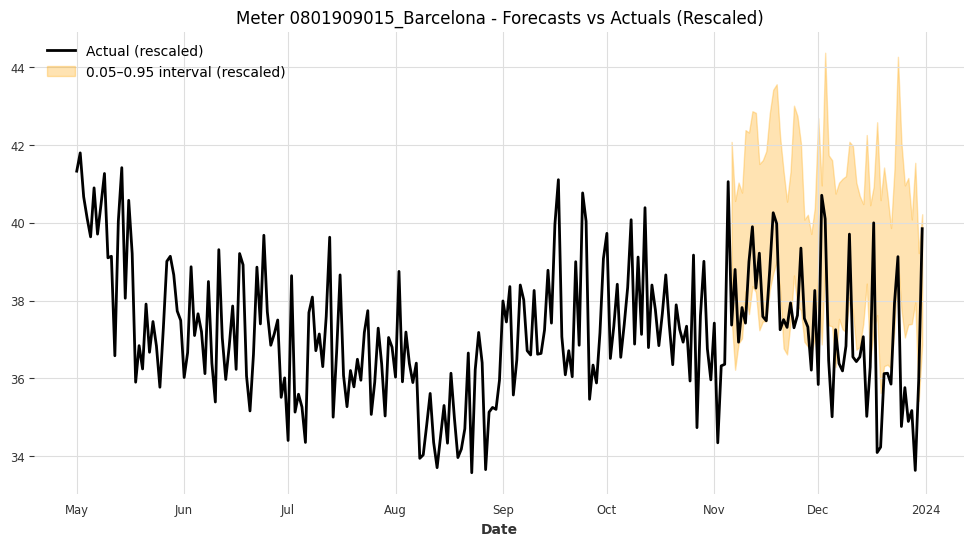

Meter 0801909015_Barcelona - Coverage: 0.5000, Mean Interval Width (rescaled): 4.1276



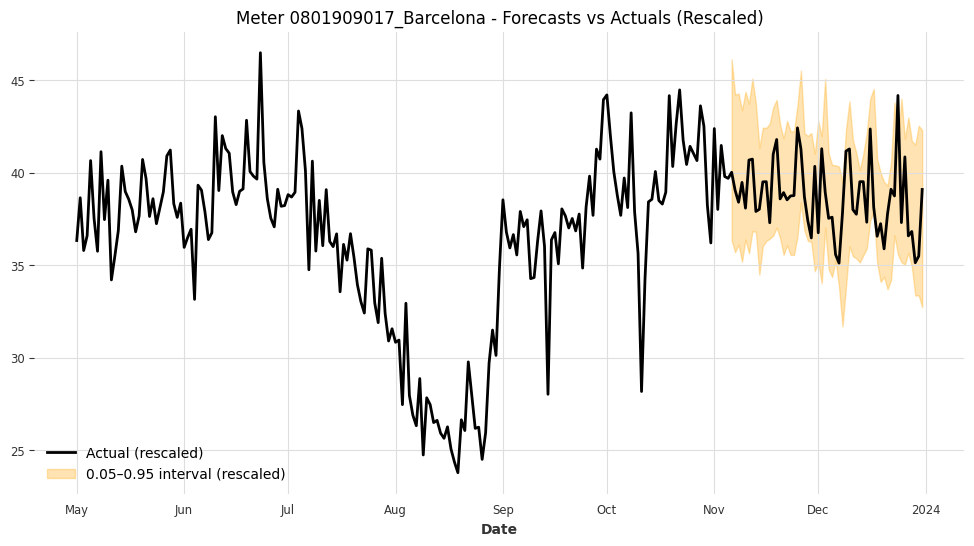

Meter 0801909017_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 6.9140



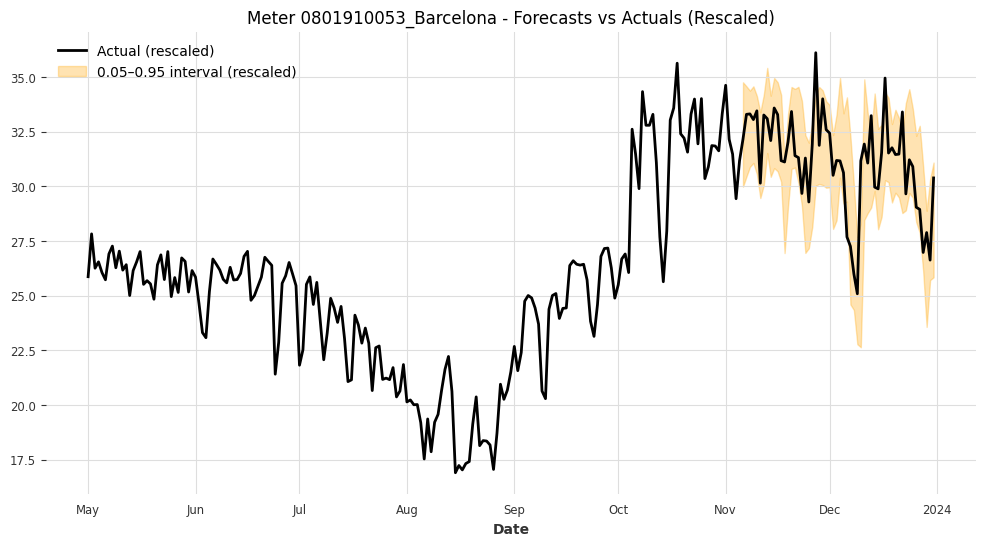

Meter 0801910053_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 4.4167



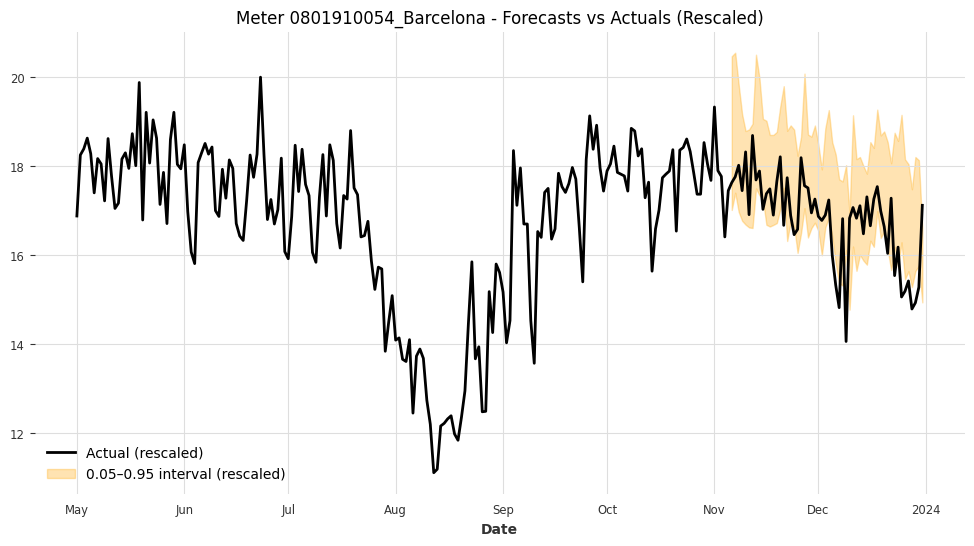

Meter 0801910054_Barcelona - Coverage: 0.7143, Mean Interval Width (rescaled): 2.3513



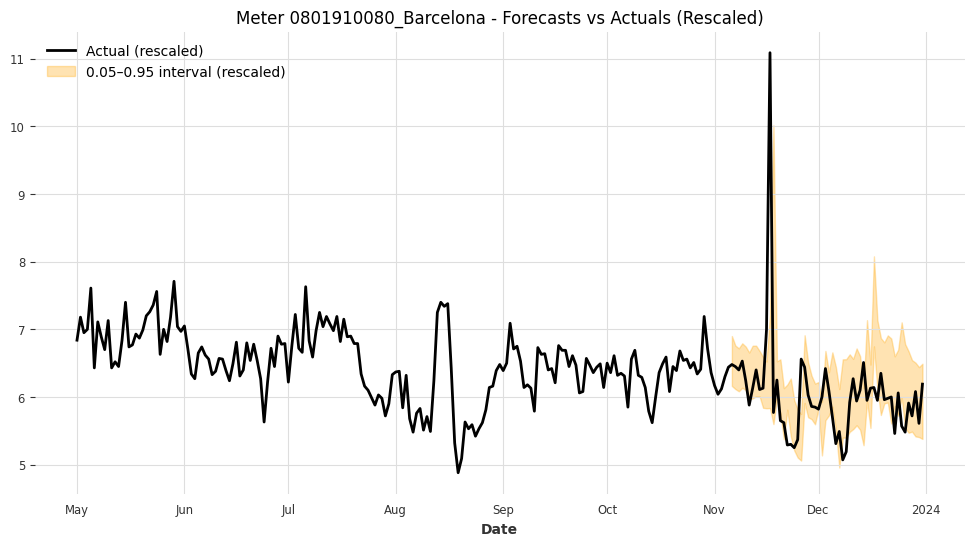

Meter 0801910080_Barcelona - Coverage: 0.6607, Mean Interval Width (rescaled): 0.9570



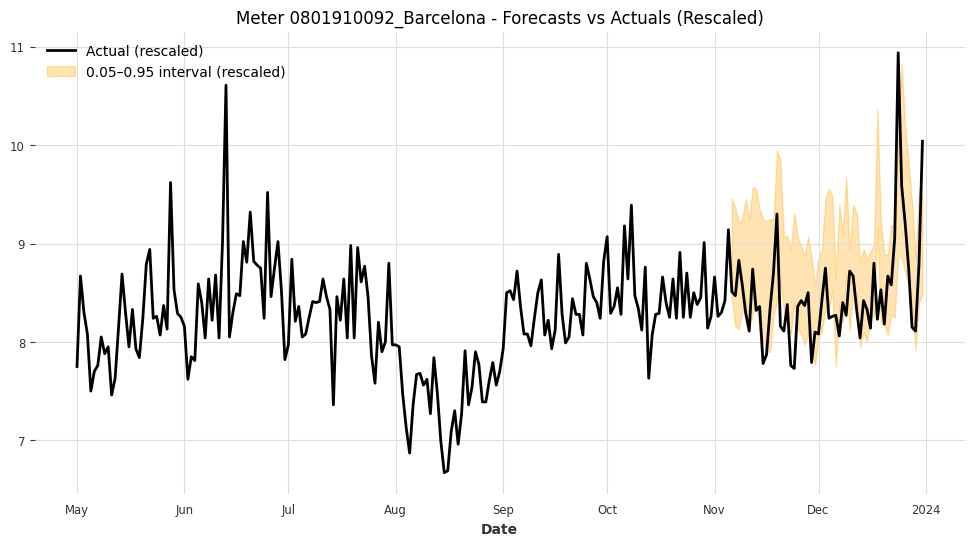

Meter 0801910092_Barcelona - Coverage: 0.6250, Mean Interval Width (rescaled): 1.0263



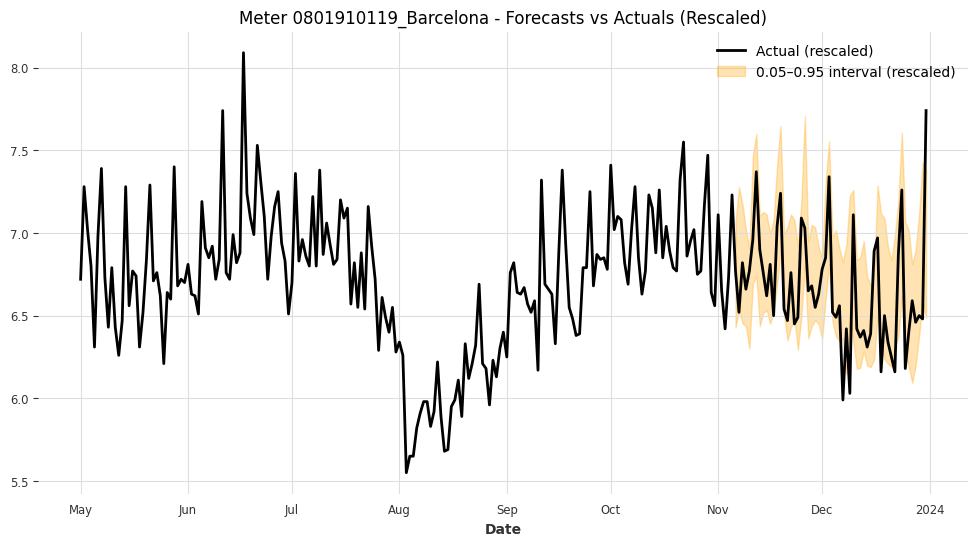

Meter 0801910119_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 0.6807



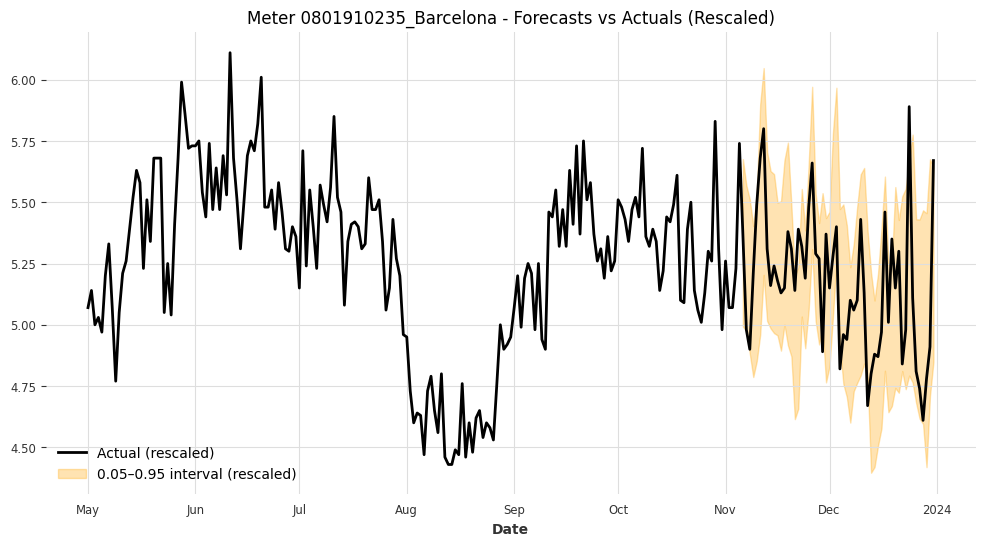

Meter 0801910235_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 0.7018



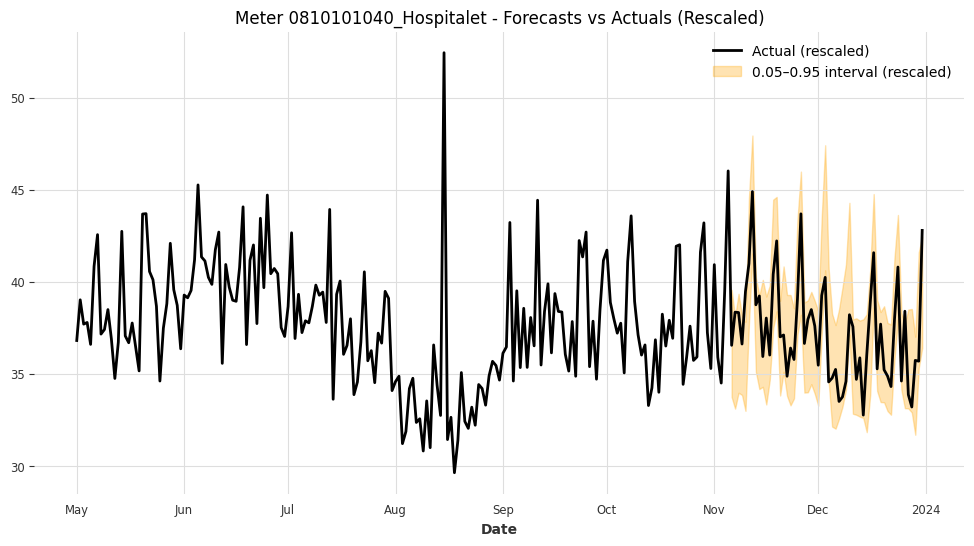

Meter 0810101040_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 5.6415



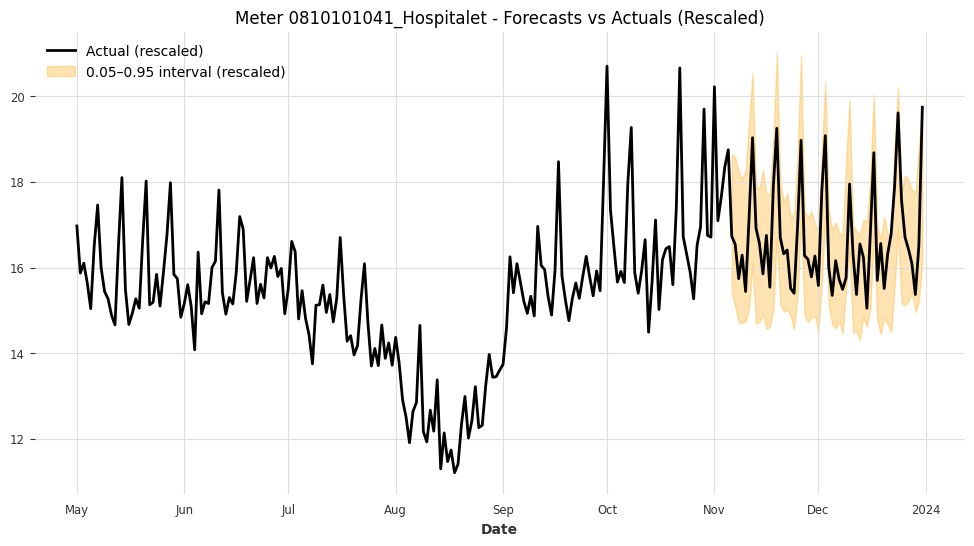

Meter 0810101041_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 2.9168



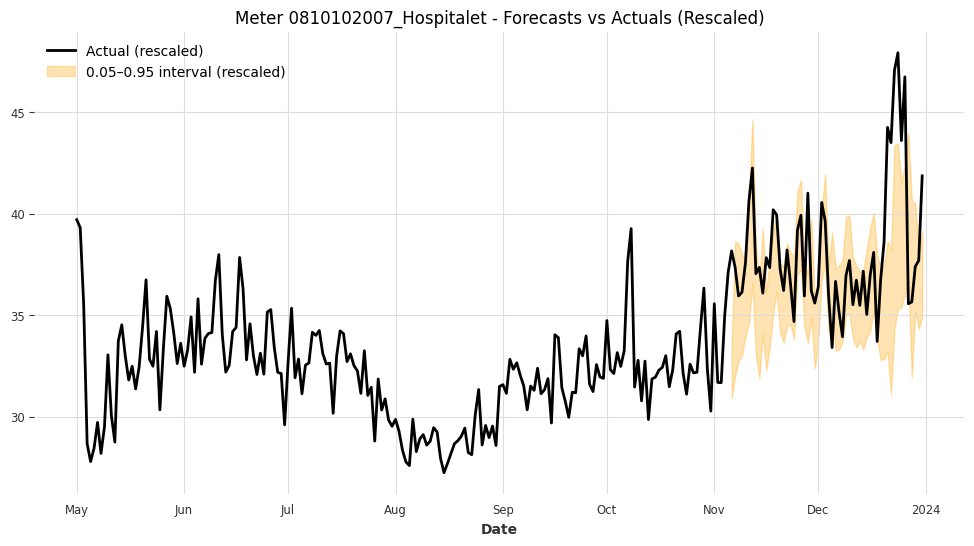

Meter 0810102007_Hospitalet - Coverage: 0.6786, Mean Interval Width (rescaled): 4.7447



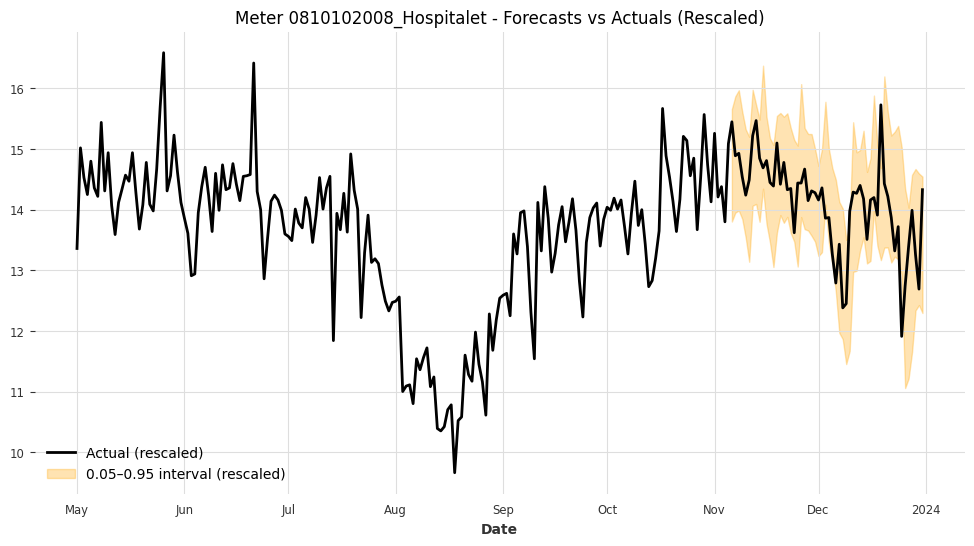

Meter 0810102008_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 1.9472



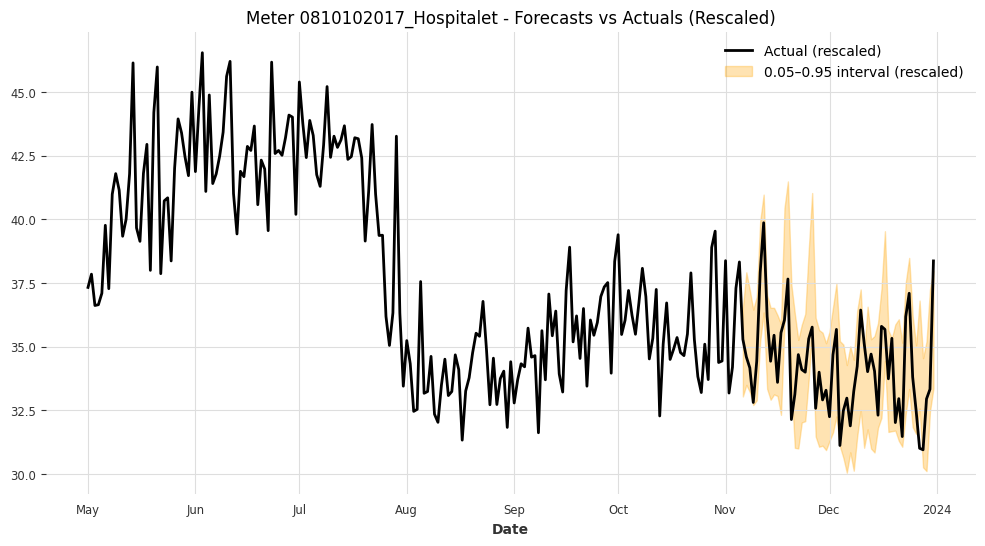

Meter 0810102017_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 4.3647



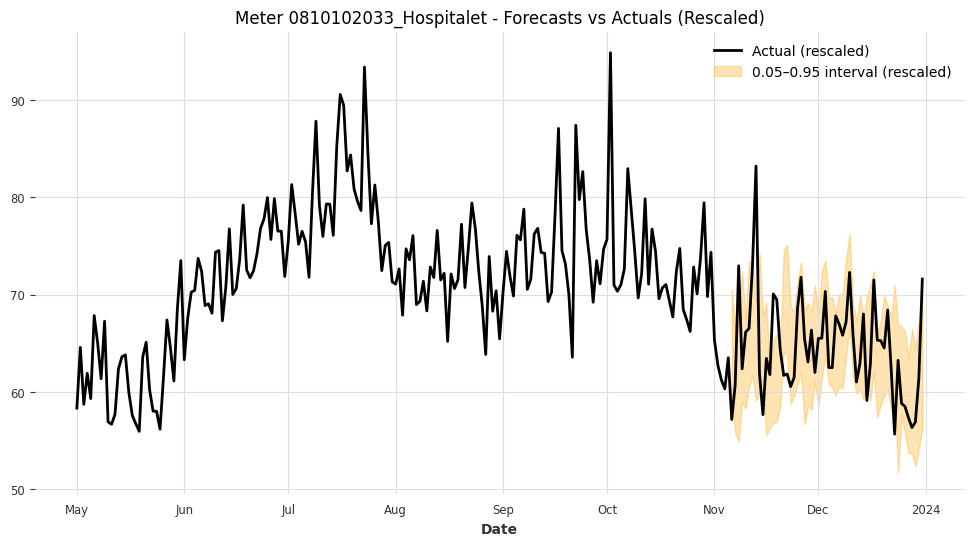

Meter 0810102033_Hospitalet - Coverage: 0.7857, Mean Interval Width (rescaled): 10.2552



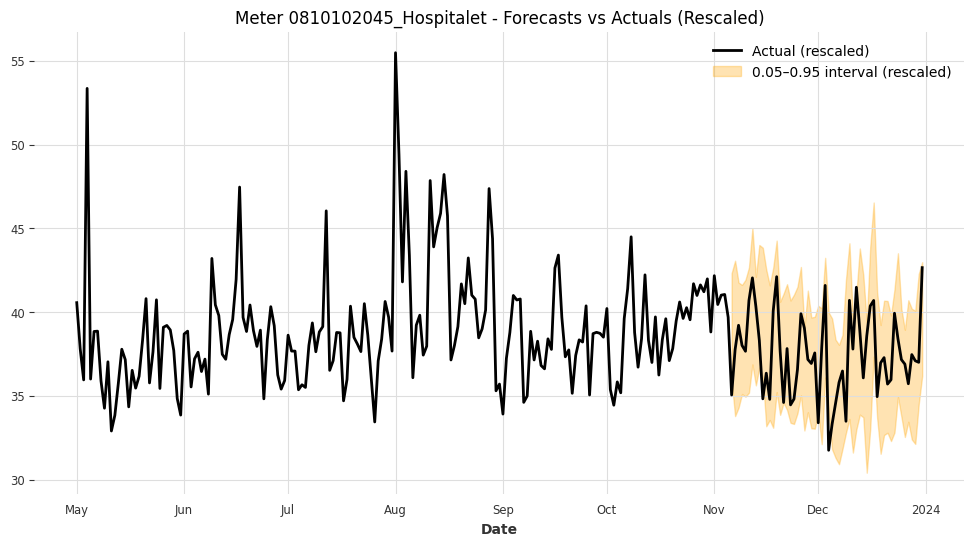

Meter 0810102045_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 7.7339



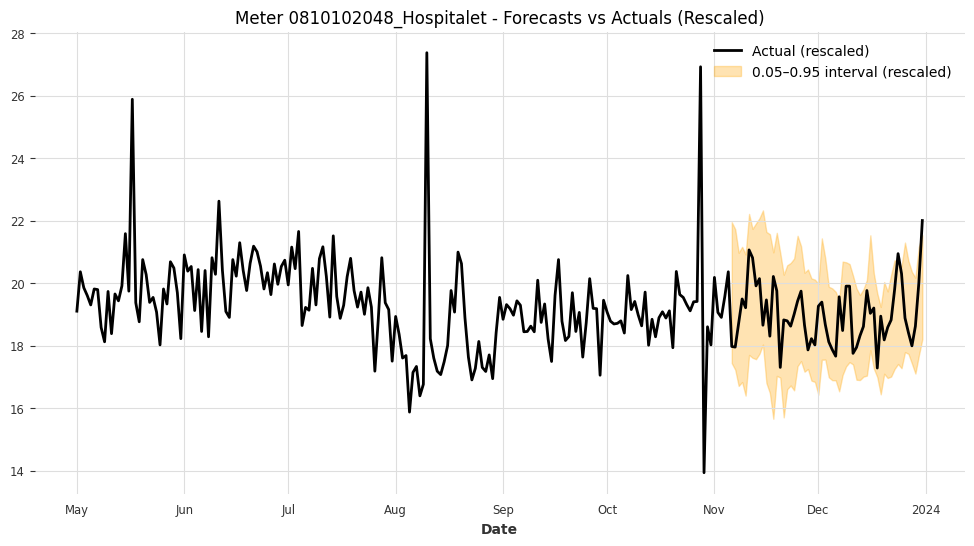

Meter 0810102048_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.6072



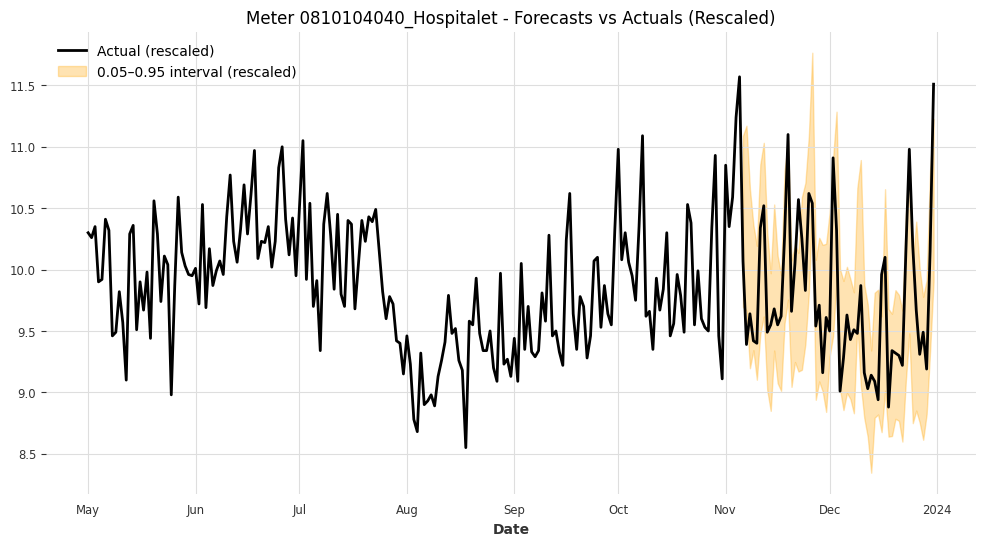

Meter 0810104040_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 1.2011



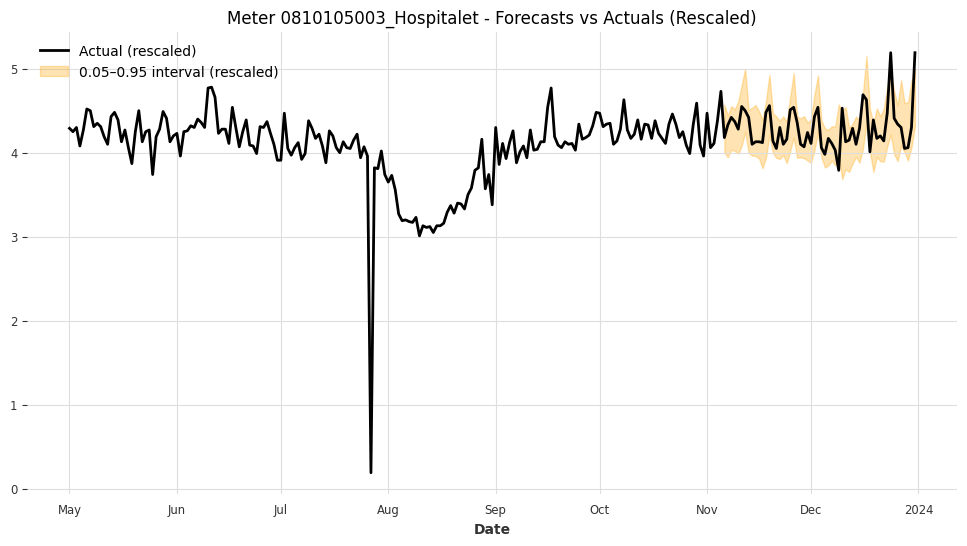

Meter 0810105003_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 0.5883



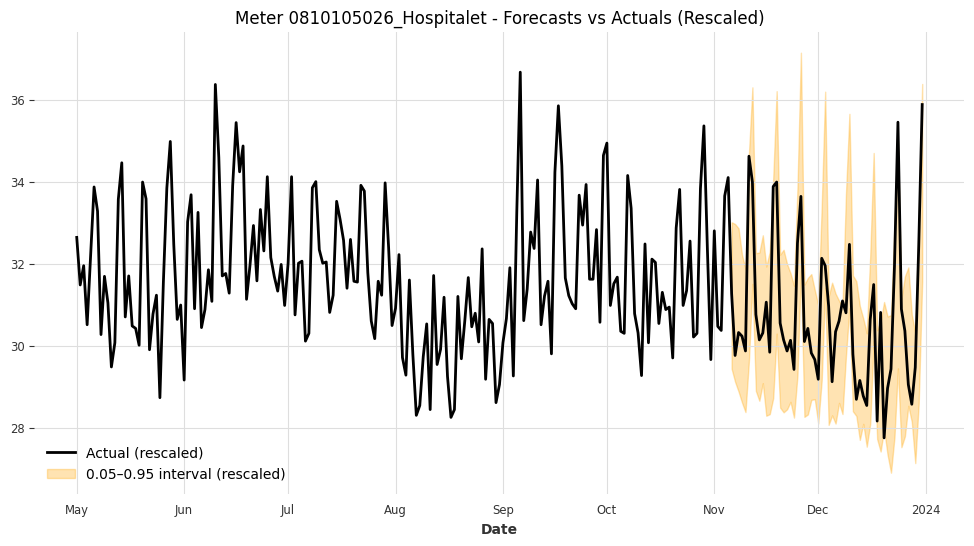

Meter 0810105026_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 3.7398



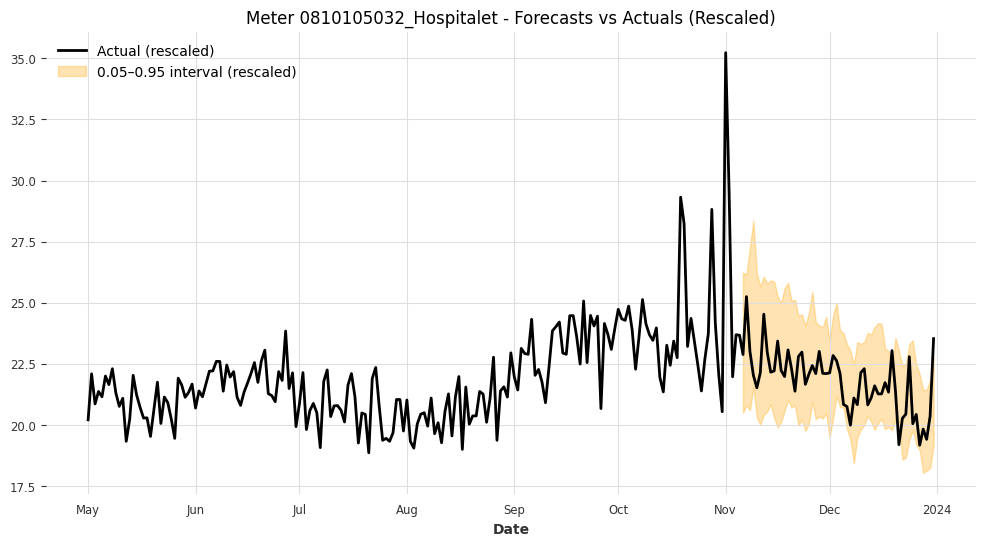

Meter 0810105032_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 4.1769



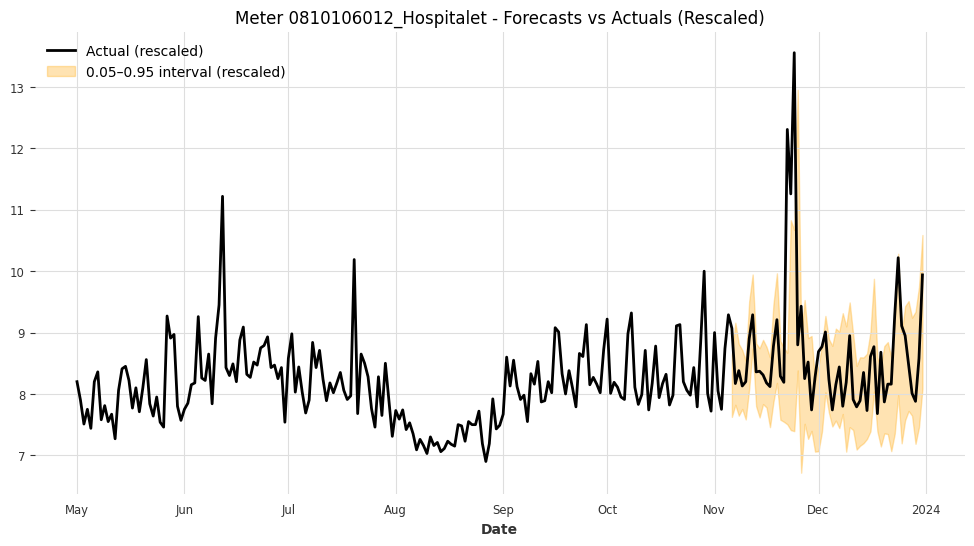

Meter 0810106012_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 1.6307



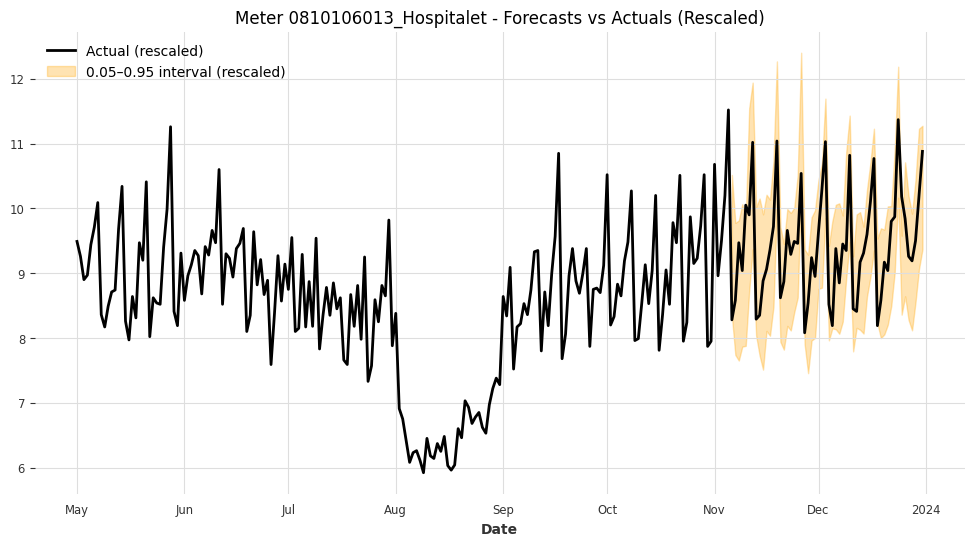

Meter 0810106013_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 1.8933



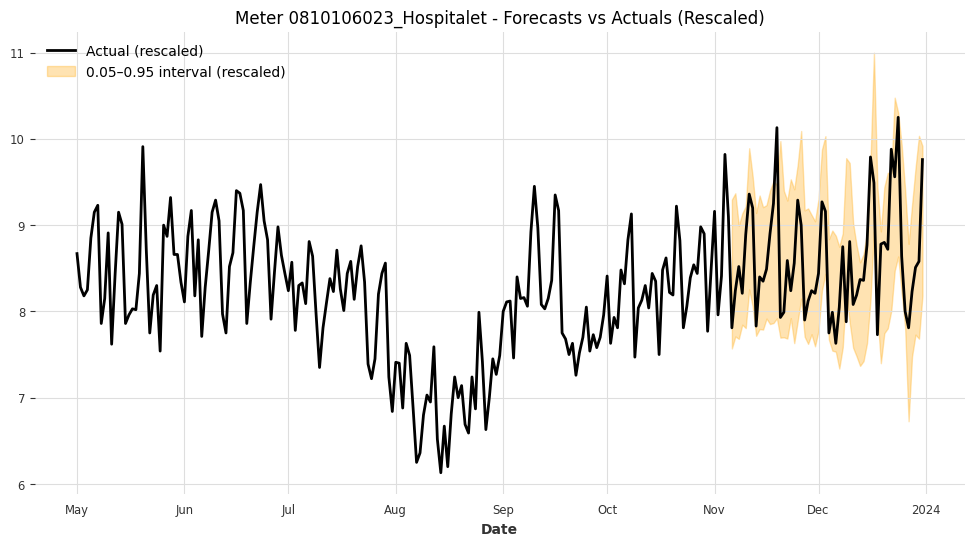

Meter 0810106023_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 1.5960



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # We use this to merge forecast segments

for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")


In [ ]:
# Let's continue with the standard

In [ ]:
model = RNNModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/rnnGRU/simple/rnnGRU_model_standard.pkl")
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test_standard.pkl')
print(test_data.keys())

# We extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [ ]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# Loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=1,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=1,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})
    print(f"\nResults for meter {meter_id}:\n", df_results)

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801501002_Badalona:
    Interval  Coverage      Width
0       0.9  0.928571  21.137964


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801503008_Badalona:
    Interval  Coverage      Width
0       0.9     0.875  24.629115


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801901042_Barcelona:
    Interval  Coverage     Width
0       0.9  0.785714  3.757254


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902035_Barcelona:
    Interval  Coverage    Width
0       0.9  0.946429  1.95541


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  2.793707


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902052_Barcelona:
    Interval  Coverage     Width
0       0.9  0.410714  3.663354


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902102_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  2.341178


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903006_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  2.787473


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903035_Barcelona:
    Interval  Coverage    Width
0       0.9  0.910714  0.68008


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903040_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  0.884856


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903048_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  3.368134


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903060_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  3.941969


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903067_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  0.824909


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903081_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  1.959836


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904008_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  6.327517


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904030_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  3.240578


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905054_Barcelona:
    Interval  Coverage      Width
0       0.9  0.928571  15.128322


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905091_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  5.143025


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906002_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  2.543456


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906010_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  6.063567


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906041_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  5.434929


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907003_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  1.831936


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907011_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  2.729314


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907013_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  1.792145


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907025_Barcelona:
    Interval  Coverage    Width
0       0.9     0.875  7.75446


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  4.406559


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907084_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  7.392259


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907088_Barcelona:
    Interval  Coverage     Width
0       0.9       1.0  5.837563


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907115_Barcelona:
    Interval  Coverage      Width
0       0.9  0.982143  15.759283


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908002_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  2.721045


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908022_Barcelona:
    Interval  Coverage    Width
0       0.9  0.982143  2.42864


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908043_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  0.624051


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908046_Barcelona:
    Interval  Coverage     Width
0       0.9  0.803571  2.130855


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908049_Barcelona:
    Interval  Coverage      Width
0       0.9  0.946429  13.164122


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908061_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  1.101376


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908088_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  4.957817


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908111_Barcelona:
    Interval  Coverage     Width
0       0.9  0.803571  8.912012


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801909015_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  6.737244


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801909017_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  7.228189


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910053_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  5.032745


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910054_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  2.886913


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910080_Barcelona:
    Interval  Coverage     Width
0       0.9  0.767857  1.190787


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910092_Barcelona:
    Interval  Coverage     Width
0       0.9  0.642857  1.180381


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910119_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  0.964249


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910235_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  0.718087


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101040_Hospitalet:
    Interval  Coverage    Width
0       0.9       1.0  6.55615


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101041_Hospitalet:
    Interval  Coverage     Width
0       0.9       1.0  3.109695


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.732143  5.794491


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102008_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.892857  2.00357


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102017_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  4.907368


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102033_Hospitalet:
    Interval  Coverage      Width
0       0.9  0.857143  11.531118


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  7.766589


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102048_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.910714  3.15451


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  1.227812


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105003_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  0.553894


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105026_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  4.070145


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105032_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  4.267605


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106012_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  1.792598


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106013_Hospitalet:
    Interval  Coverage     Width
0       0.9       1.0  2.518374


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  1.895232


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")

Mean Coverage: 0.8899
Mean Width: 4.8206


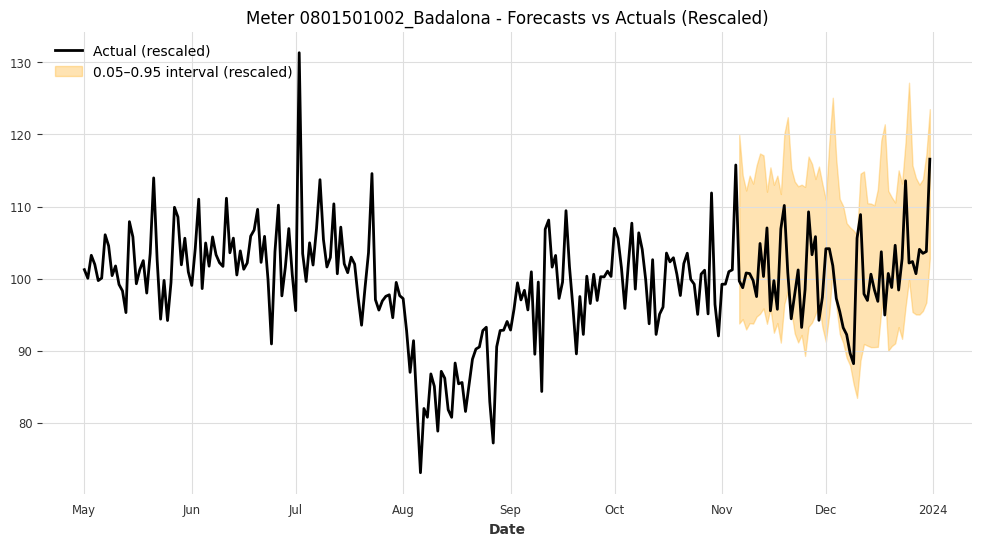

Meter 0801501002_Badalona - Coverage: 0.9286, Mean Interval Width (rescaled): 21.1380



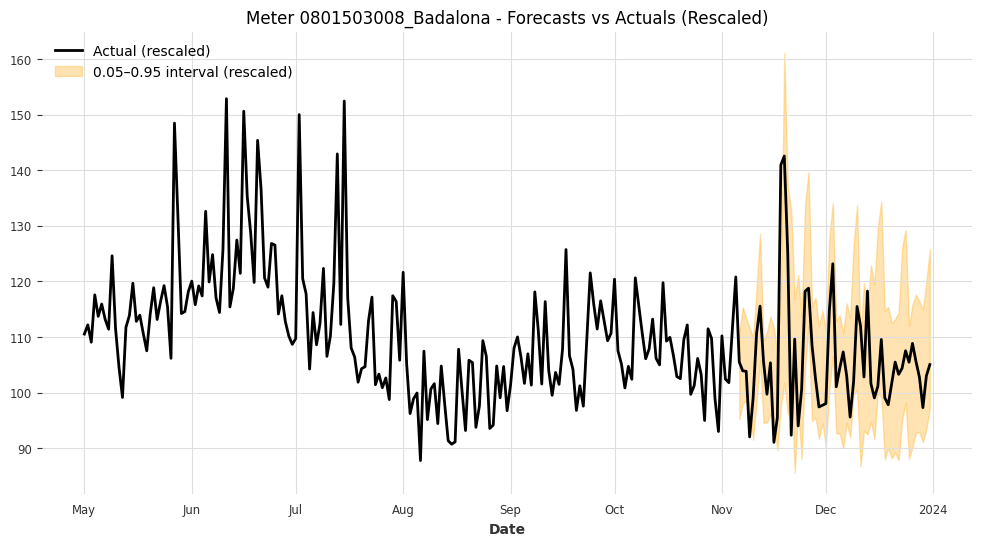

Meter 0801503008_Badalona - Coverage: 0.8750, Mean Interval Width (rescaled): 24.6291



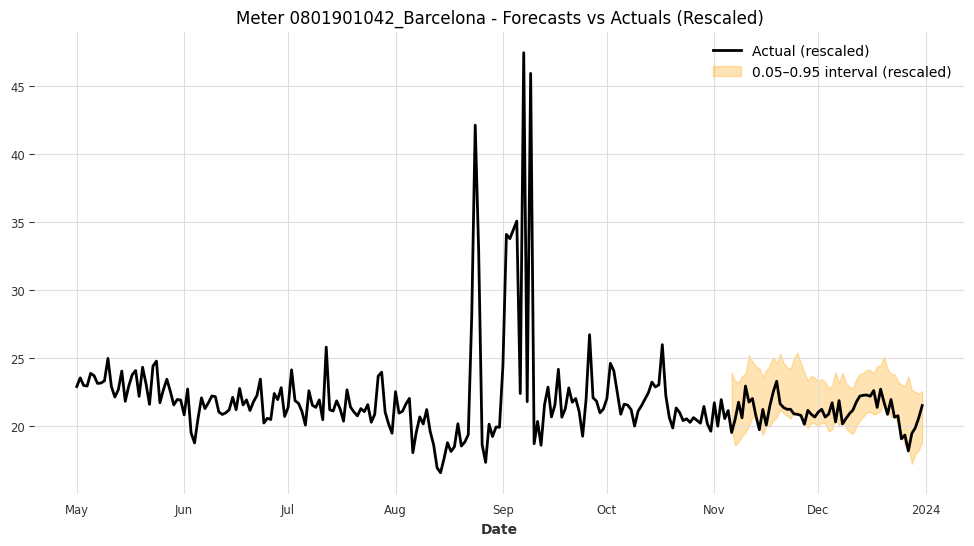

Meter 0801901042_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 3.7573



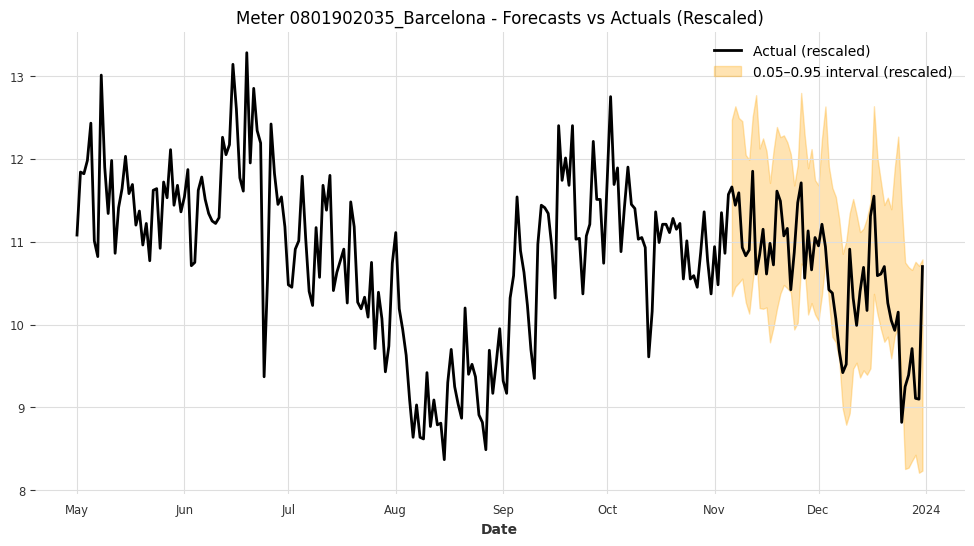

Meter 0801902035_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 1.9554



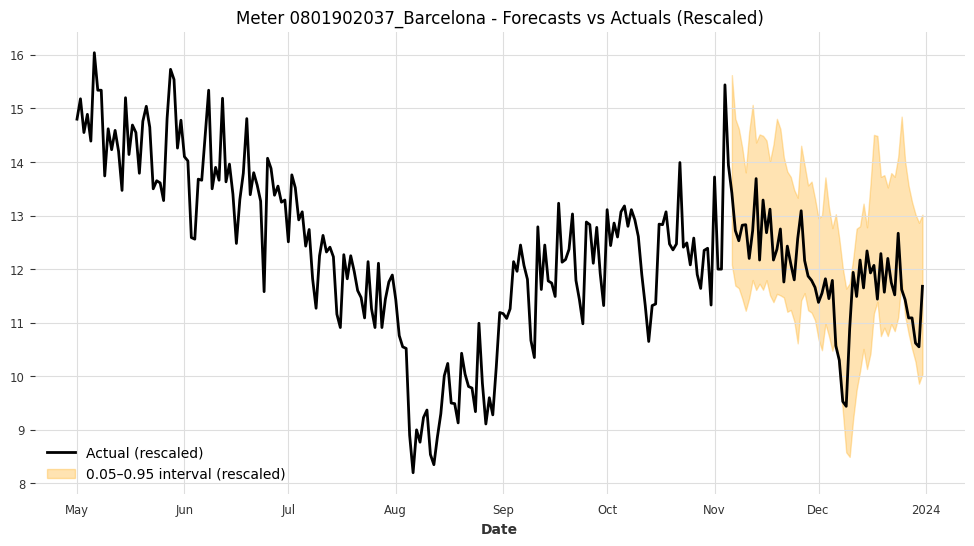

Meter 0801902037_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 2.7937



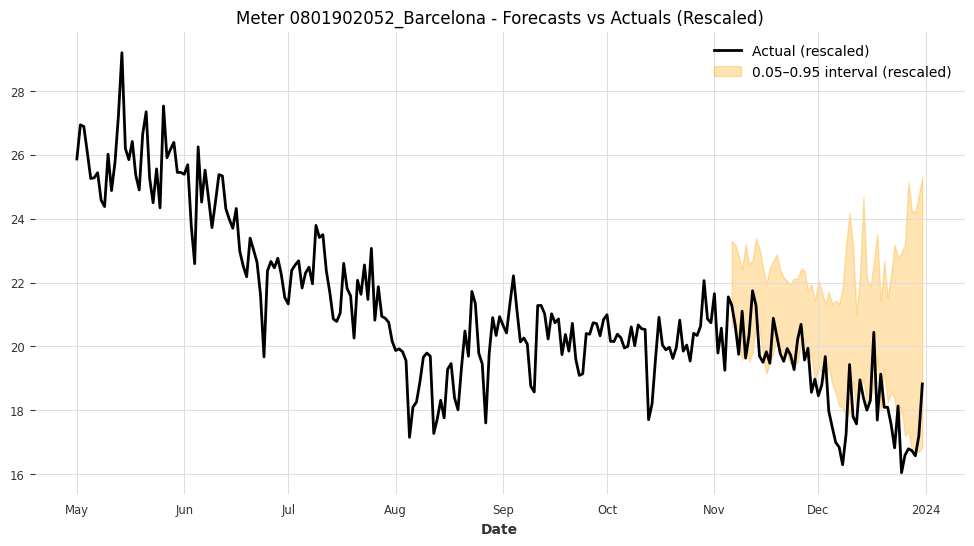

Meter 0801902052_Barcelona - Coverage: 0.4107, Mean Interval Width (rescaled): 3.6634



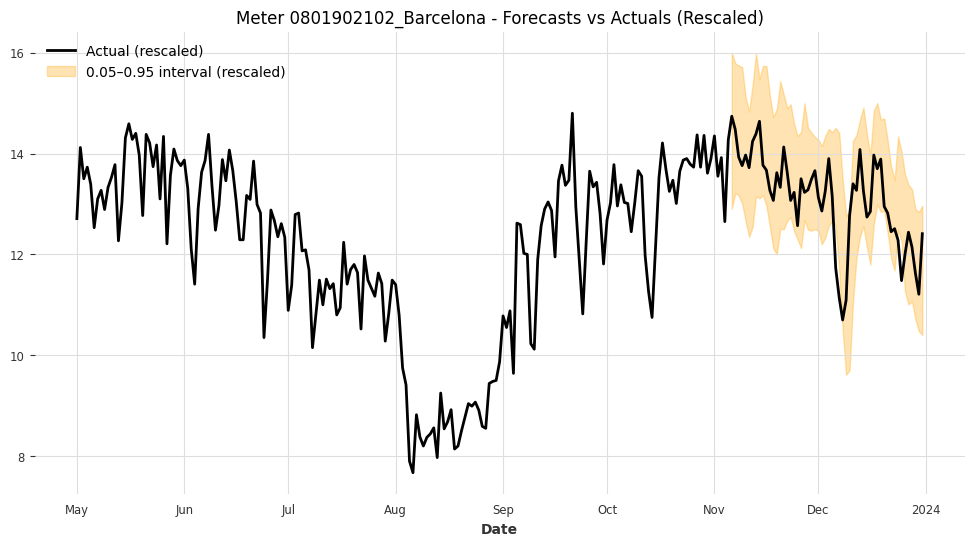

Meter 0801902102_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 2.3412



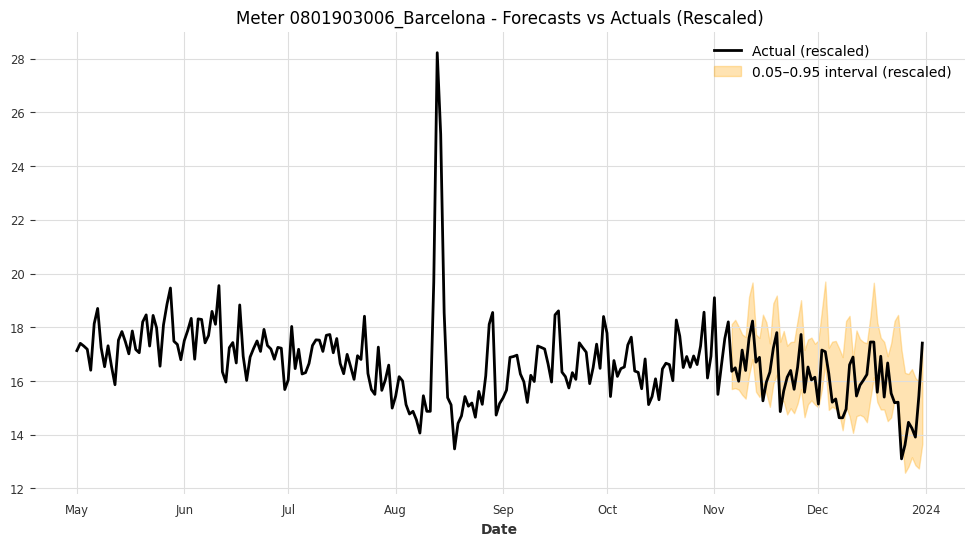

Meter 0801903006_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 2.7875



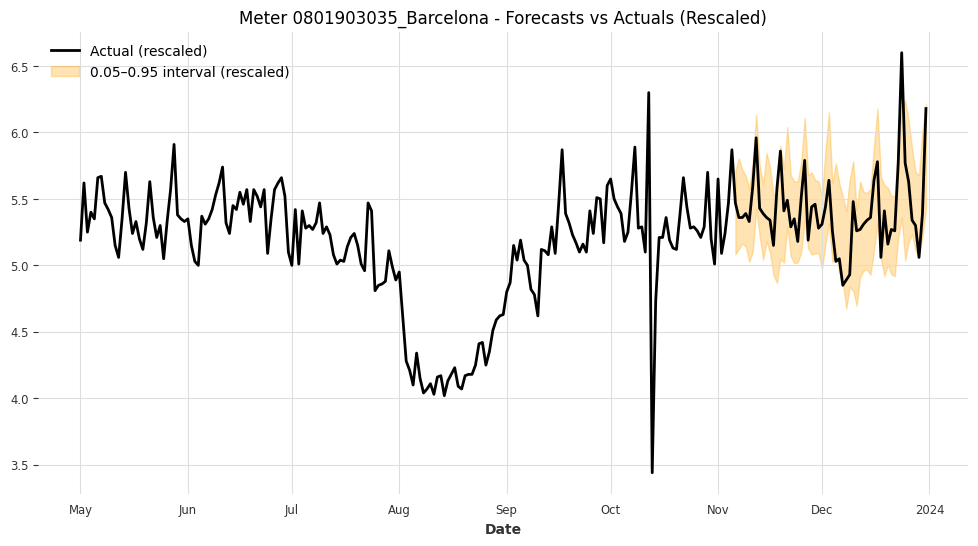

Meter 0801903035_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 0.6801



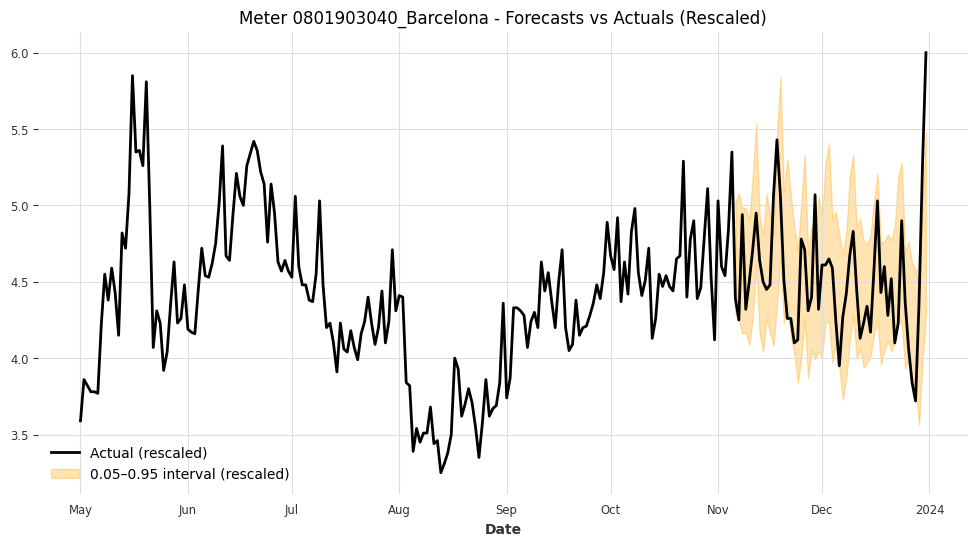

Meter 0801903040_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 0.8849



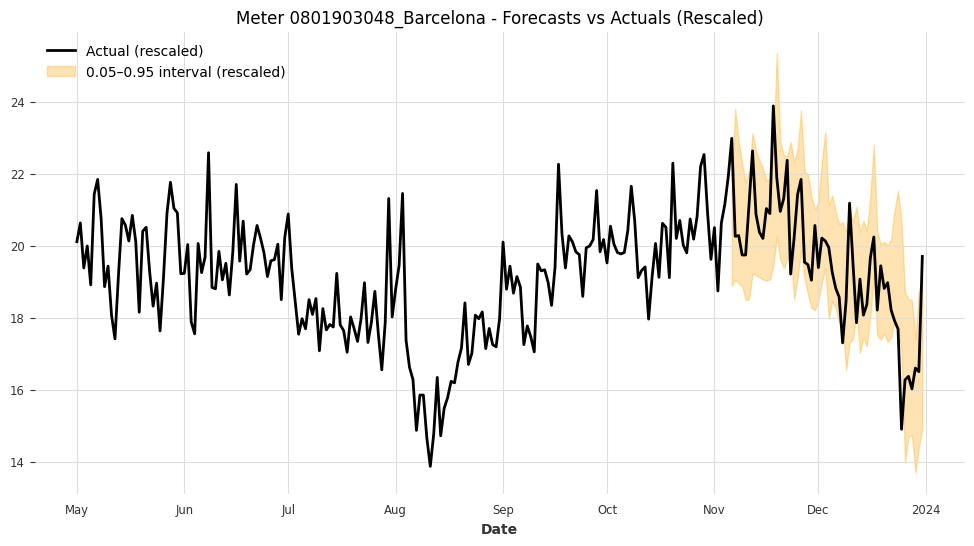

Meter 0801903048_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 3.3681



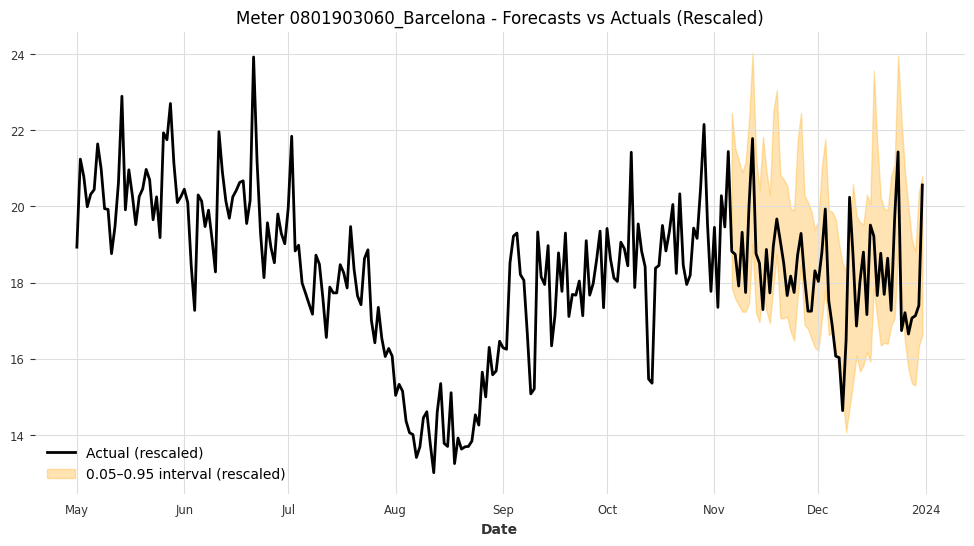

Meter 0801903060_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 3.9420



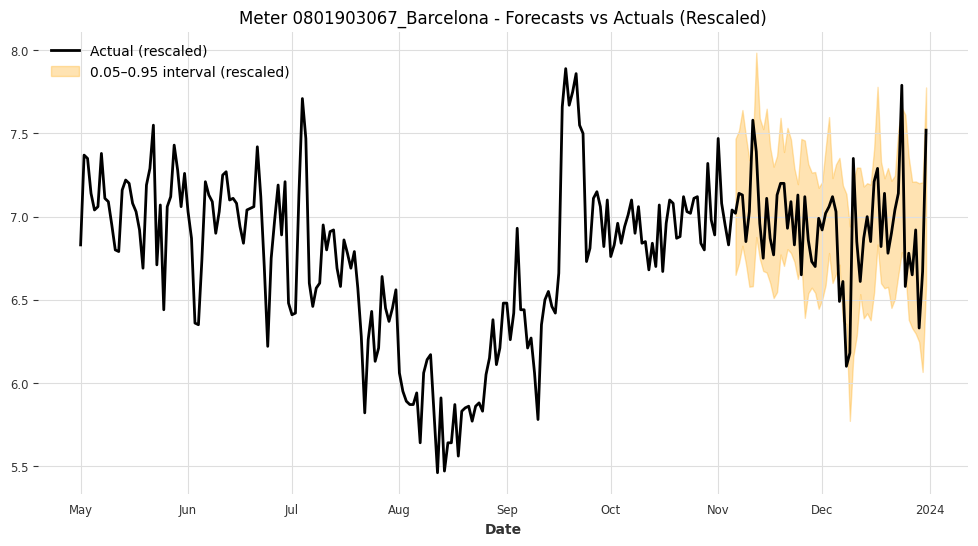

Meter 0801903067_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 0.8249



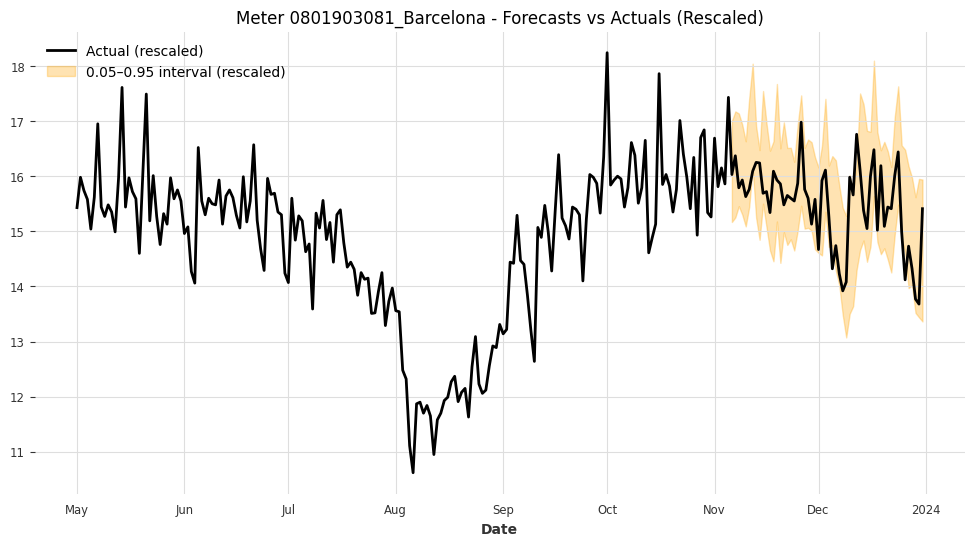

Meter 0801903081_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 1.9598



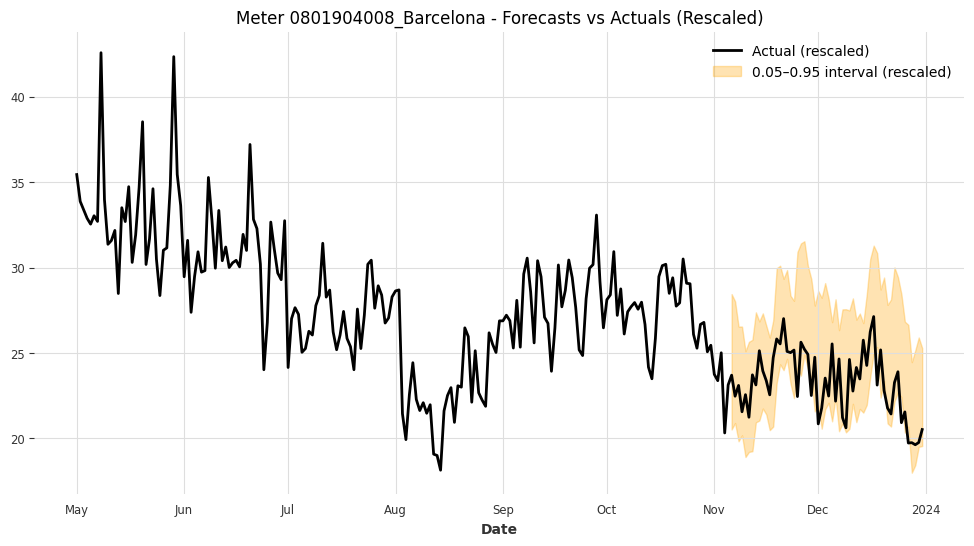

Meter 0801904008_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 6.3275



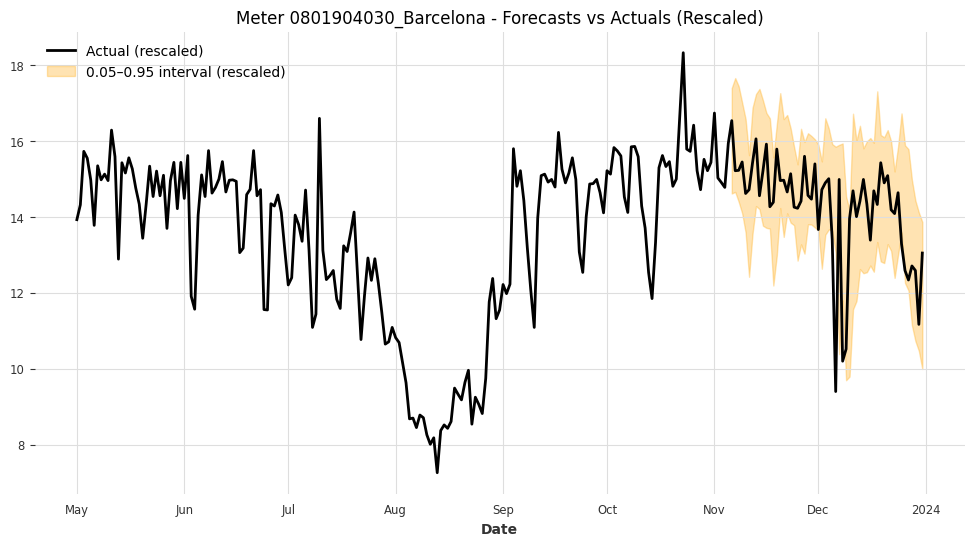

Meter 0801904030_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 3.2406



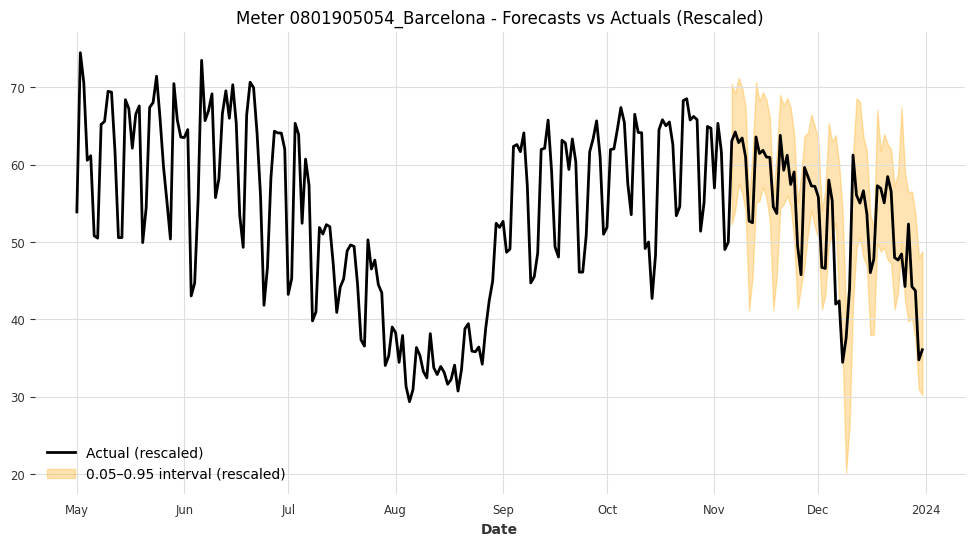

Meter 0801905054_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 15.1283



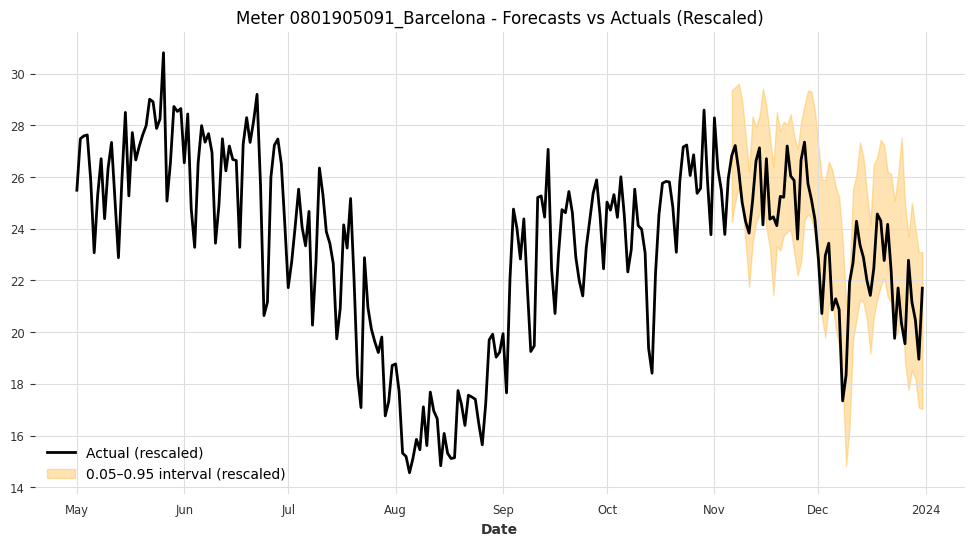

Meter 0801905091_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 5.1430



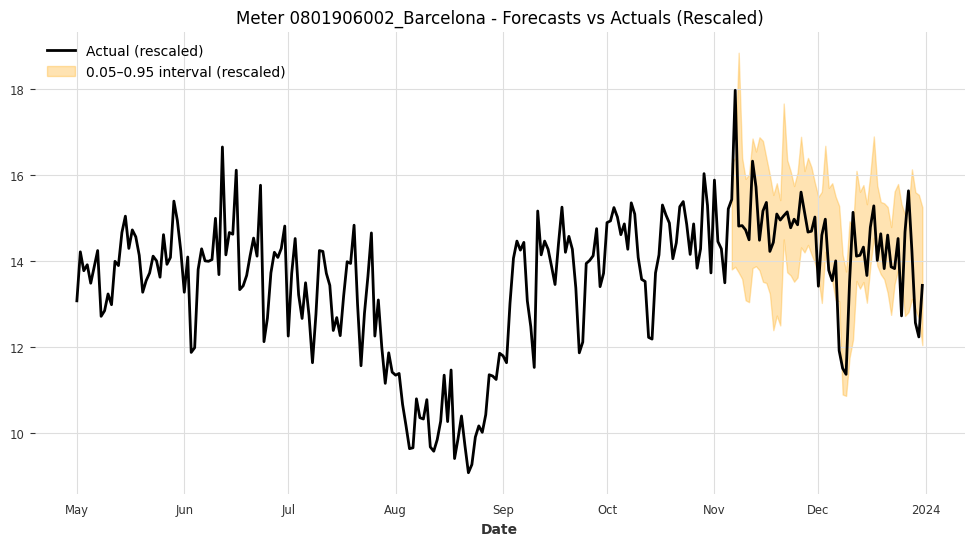

Meter 0801906002_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 2.5435



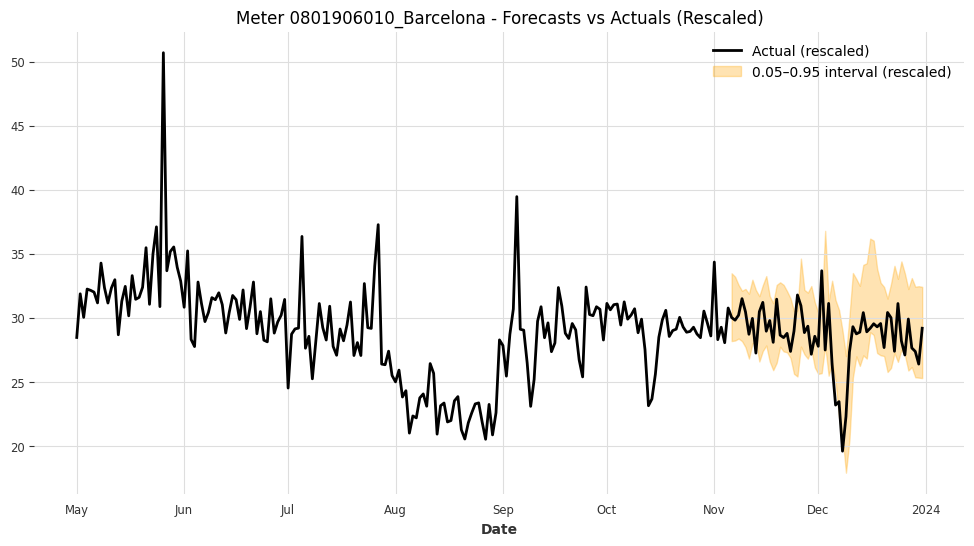

Meter 0801906010_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 6.0636



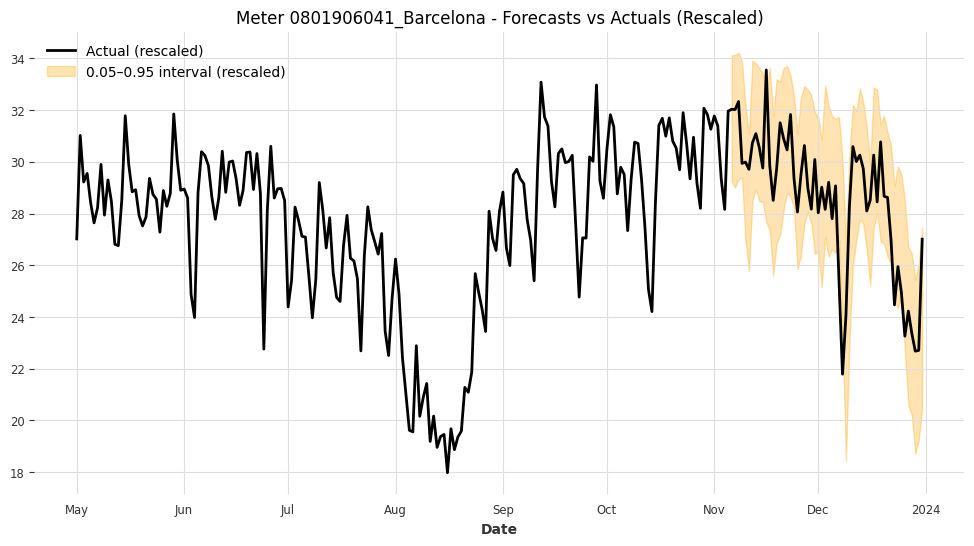

Meter 0801906041_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 5.4349



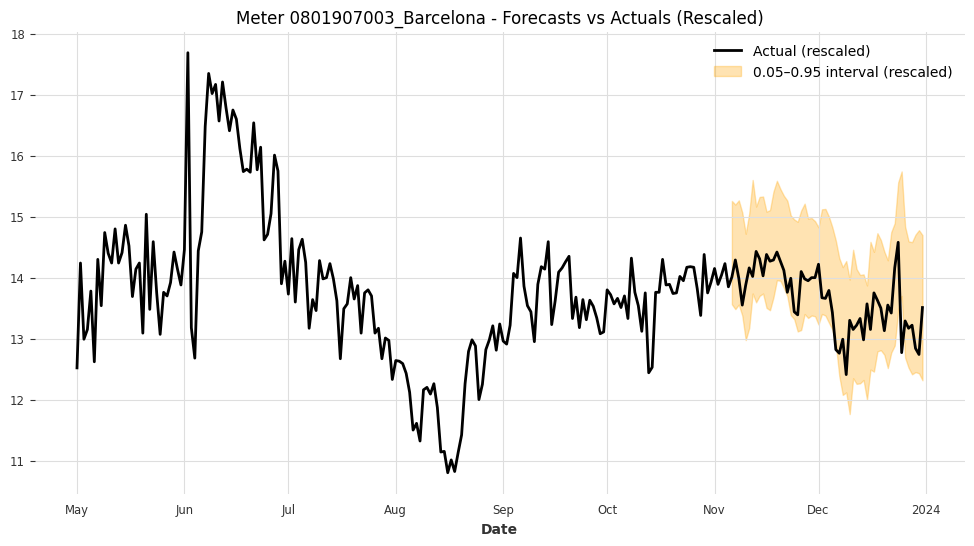

Meter 0801907003_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 1.8319



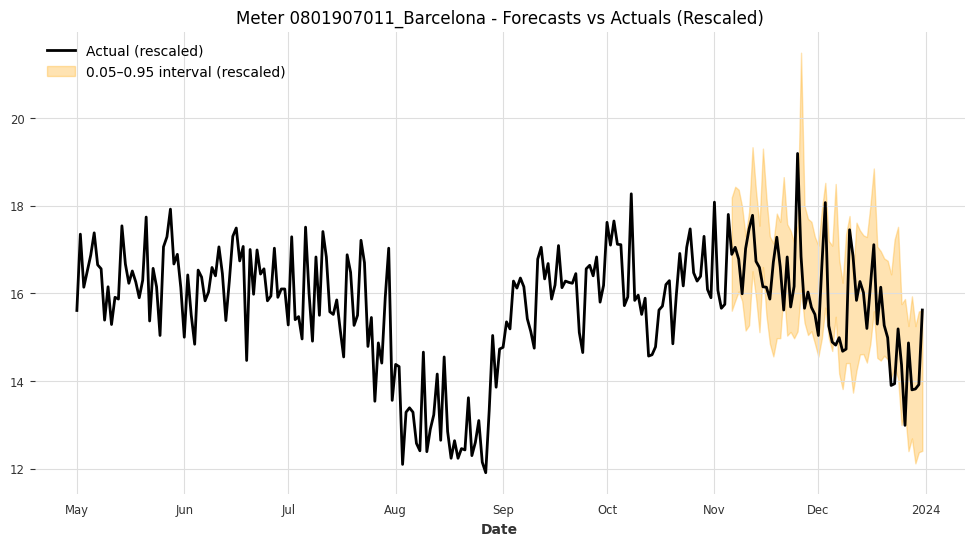

Meter 0801907011_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 2.7293



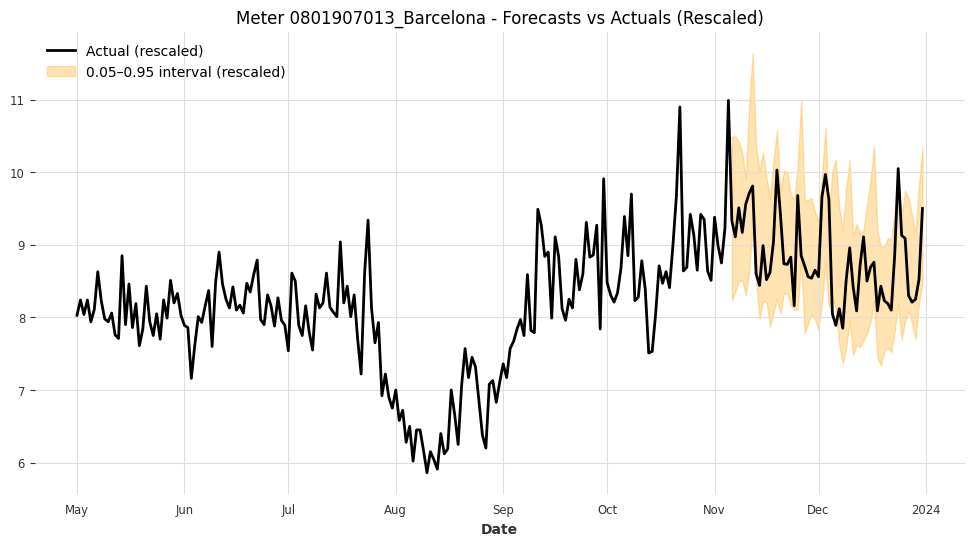

Meter 0801907013_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 1.7921



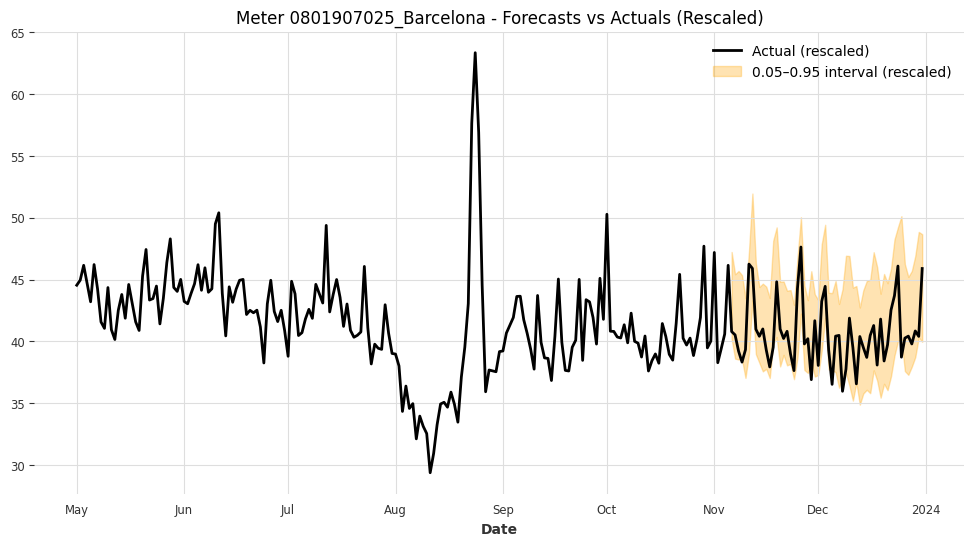

Meter 0801907025_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 7.7545



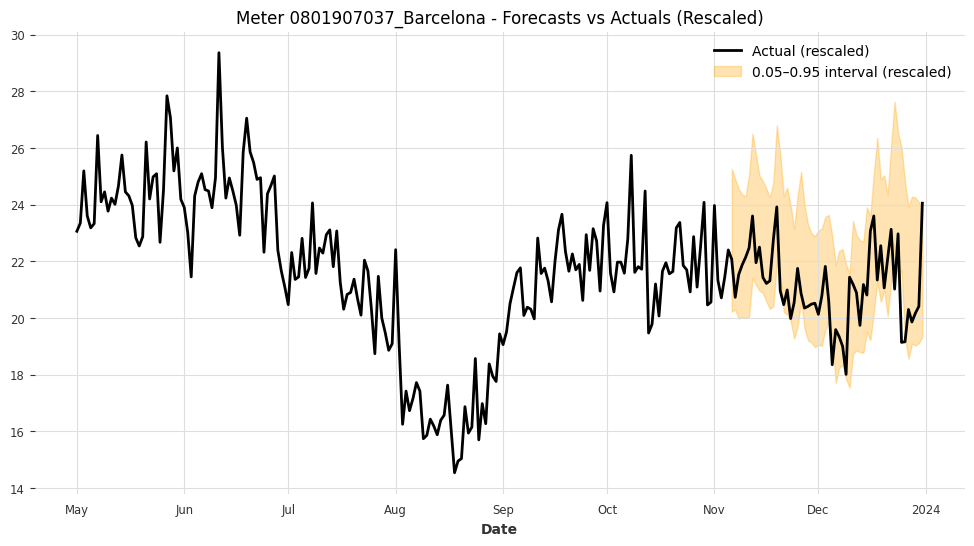

Meter 0801907037_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 4.4066



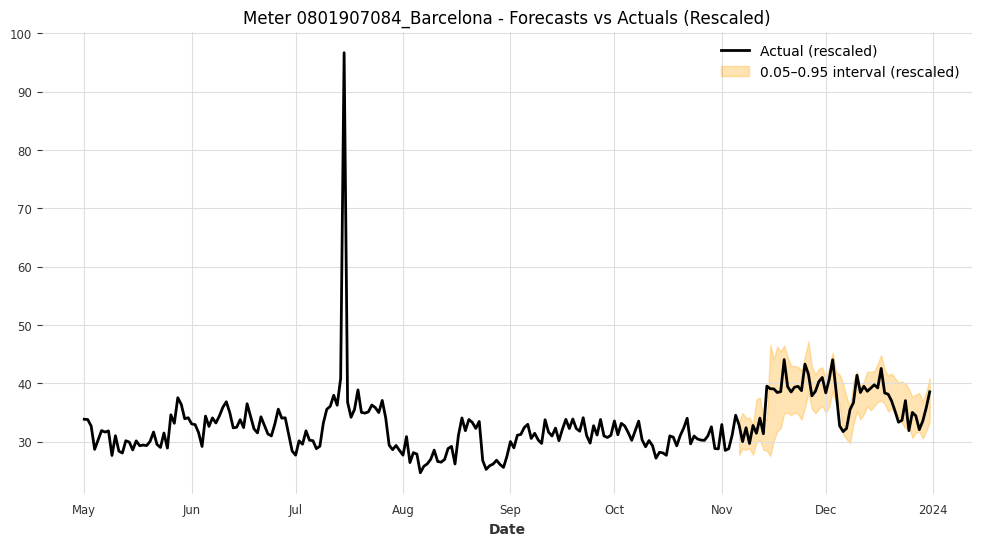

Meter 0801907084_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 7.3923



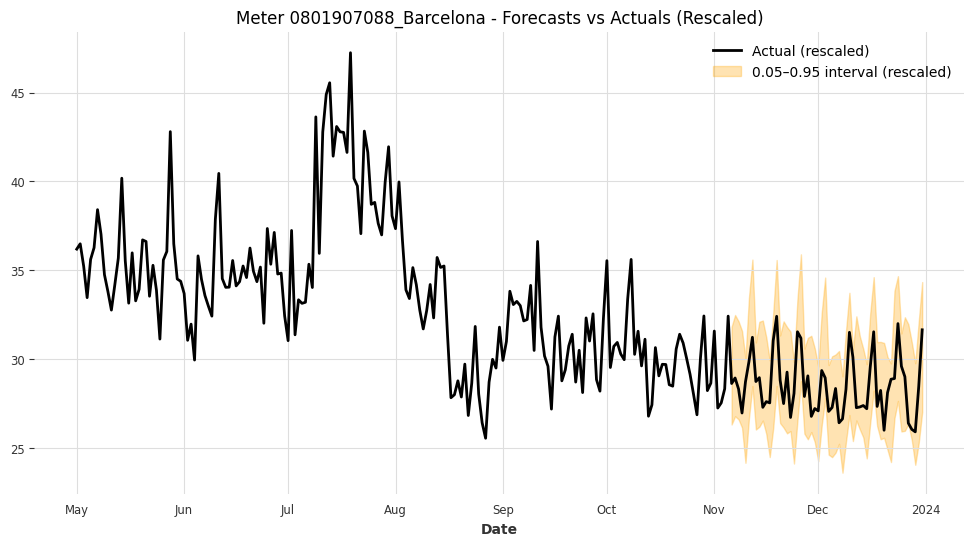

Meter 0801907088_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 5.8376



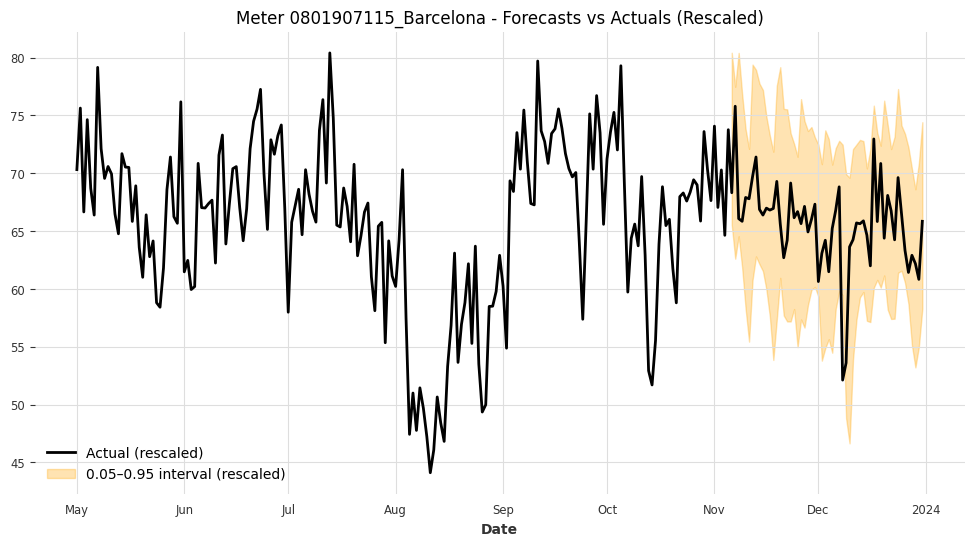

Meter 0801907115_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 15.7593



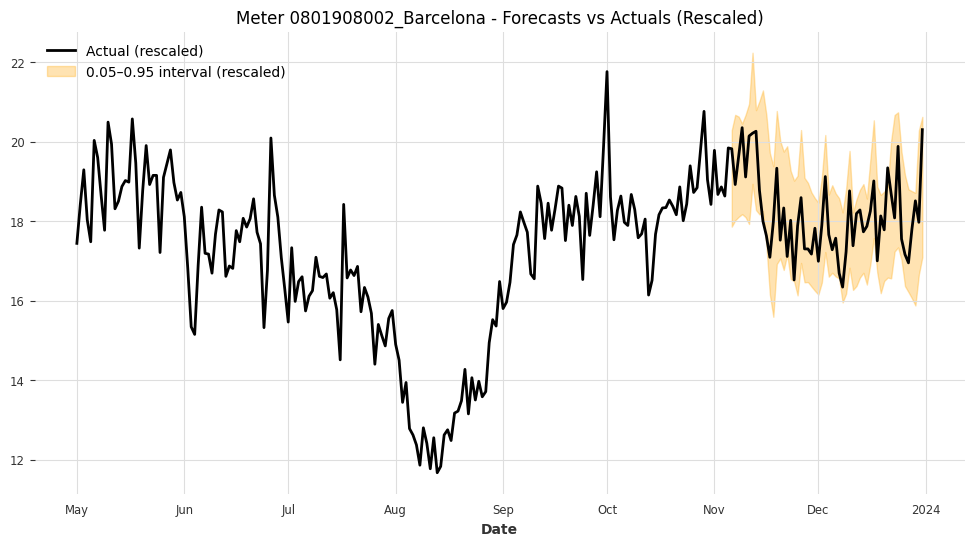

Meter 0801908002_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 2.7210



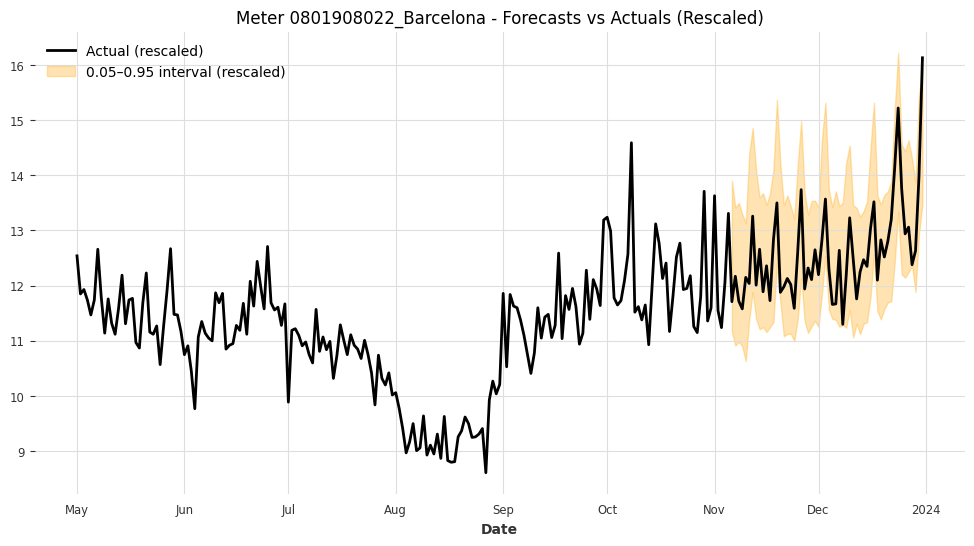

Meter 0801908022_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 2.4286



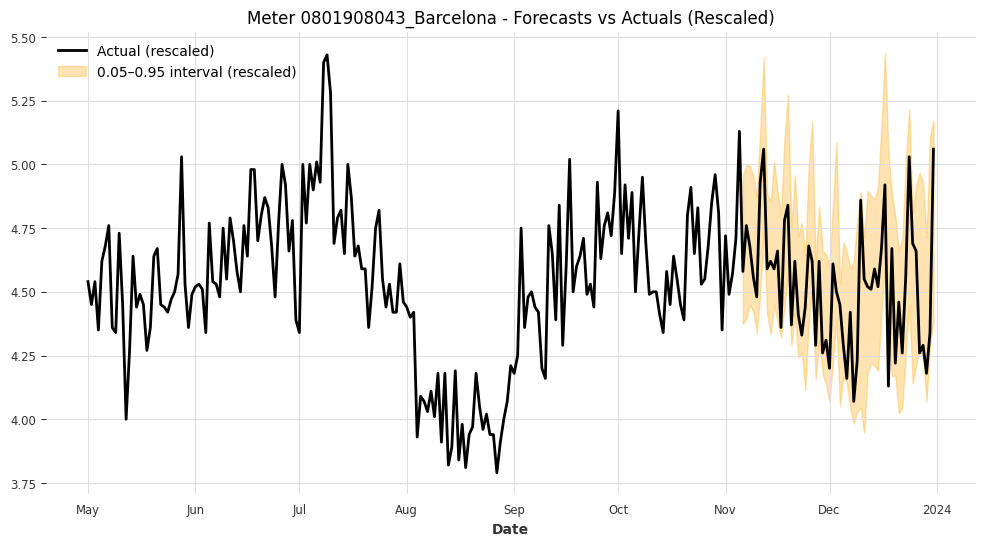

Meter 0801908043_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 0.6241



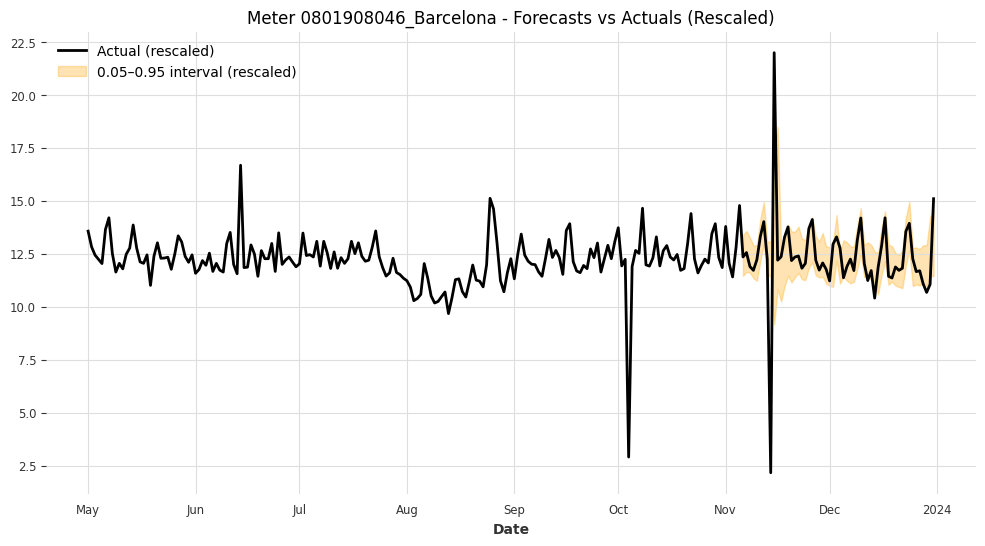

Meter 0801908046_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 2.1309



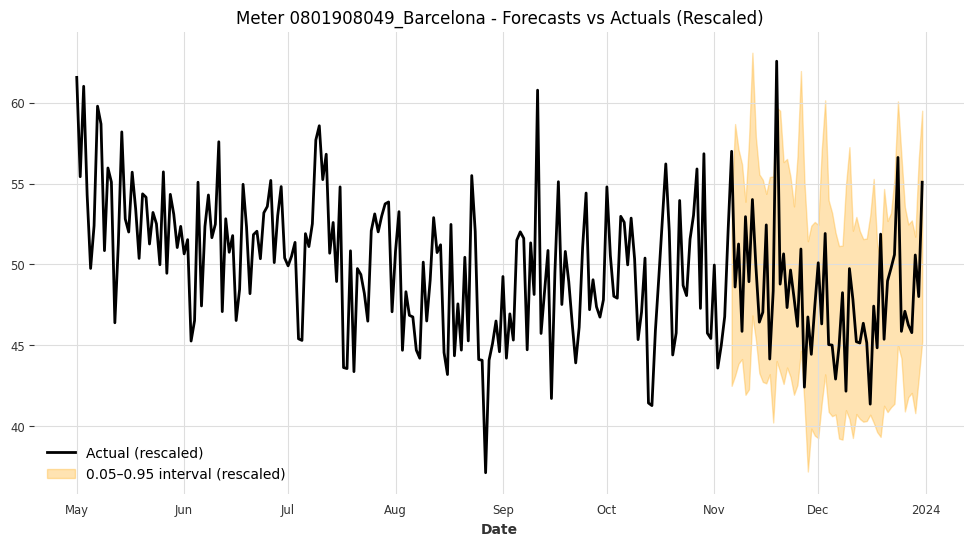

Meter 0801908049_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 13.1641



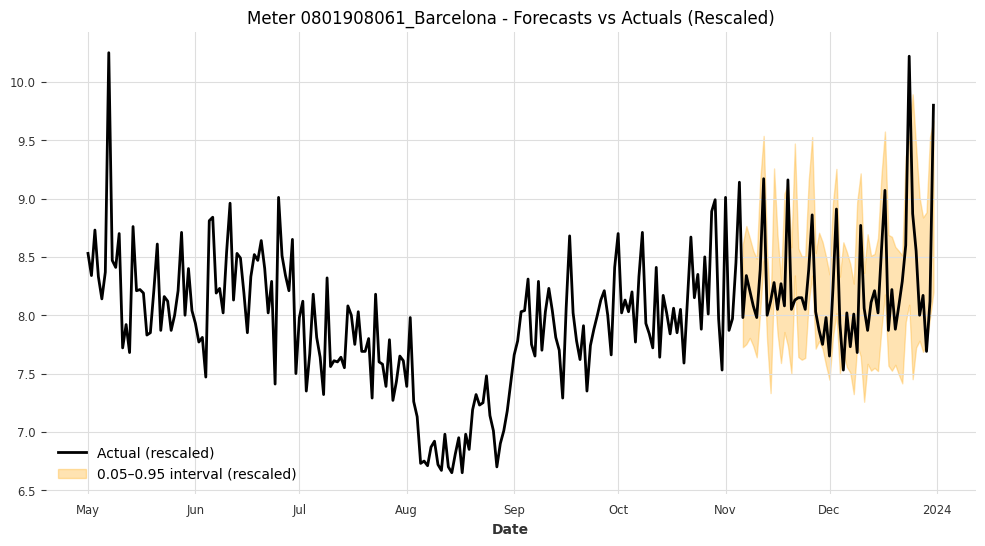

Meter 0801908061_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 1.1014



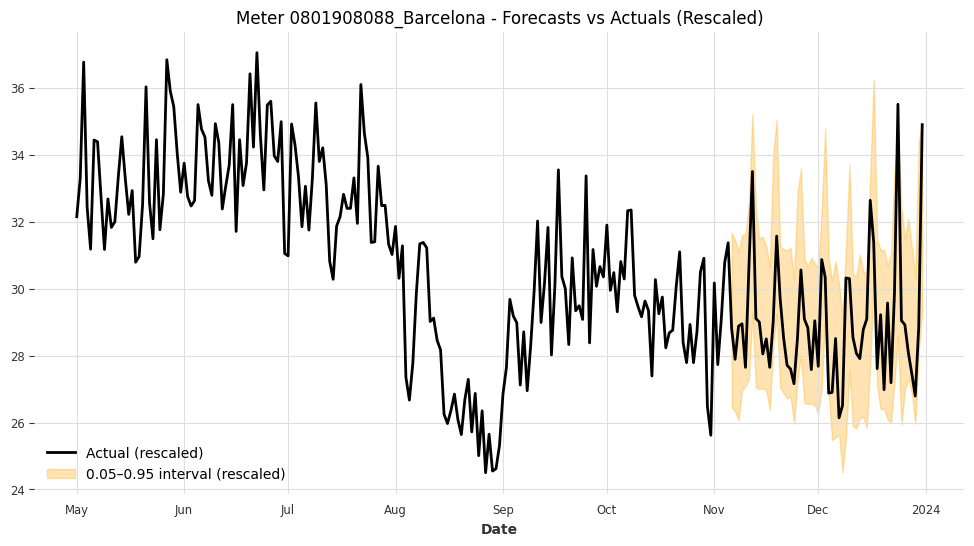

Meter 0801908088_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 4.9578



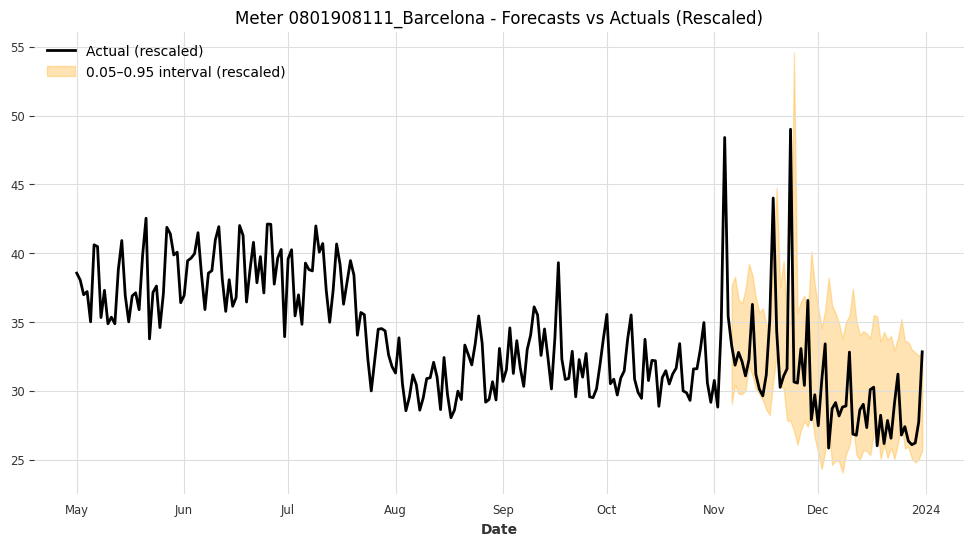

Meter 0801908111_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 8.9120



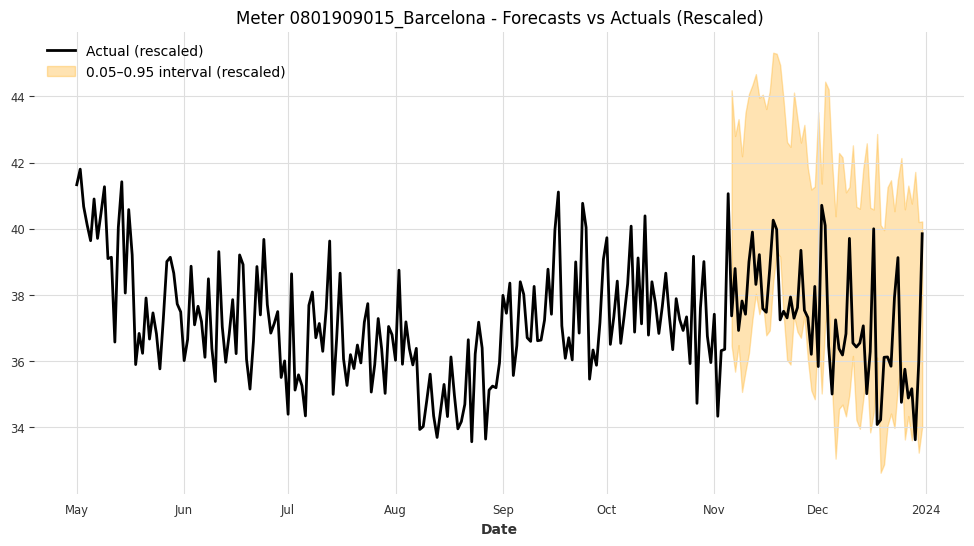

Meter 0801909015_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 6.7372



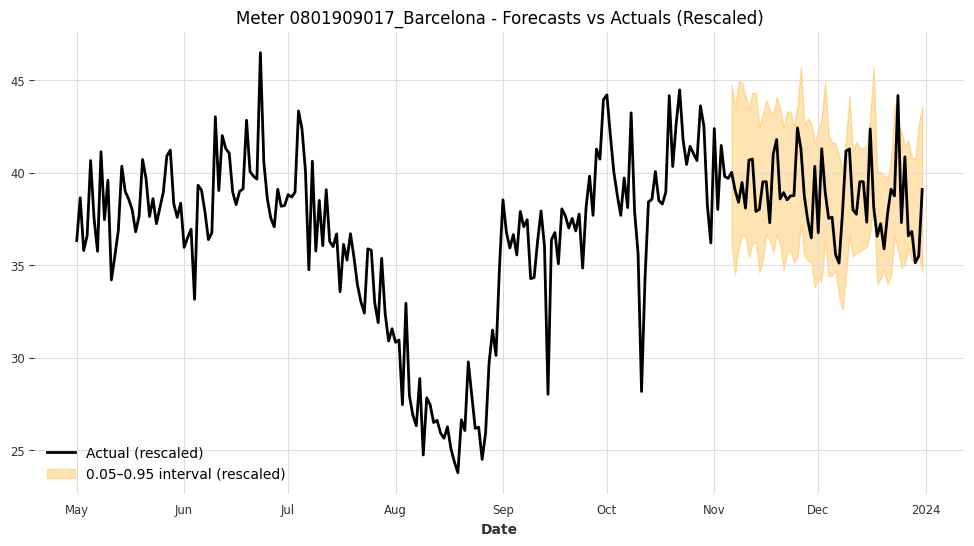

Meter 0801909017_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 7.2282



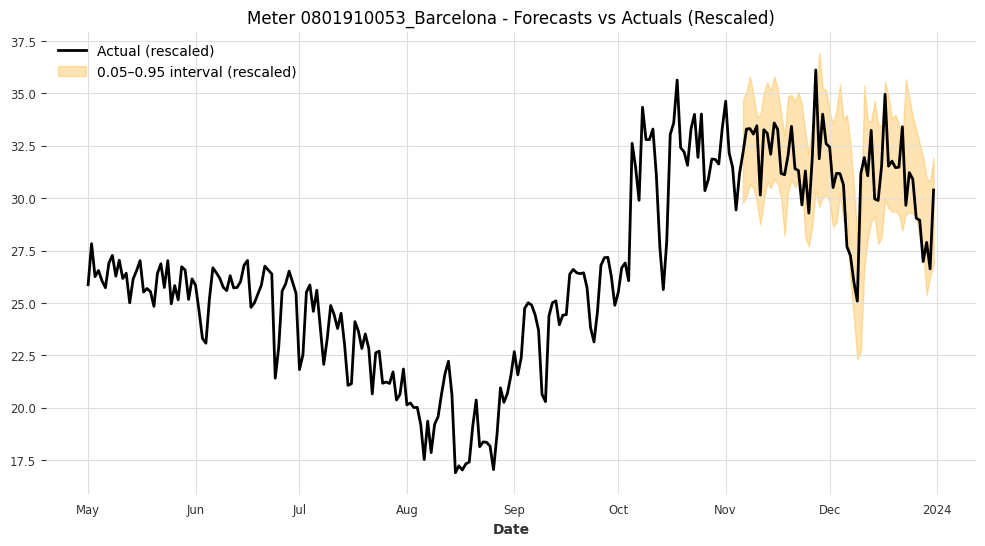

Meter 0801910053_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 5.0327



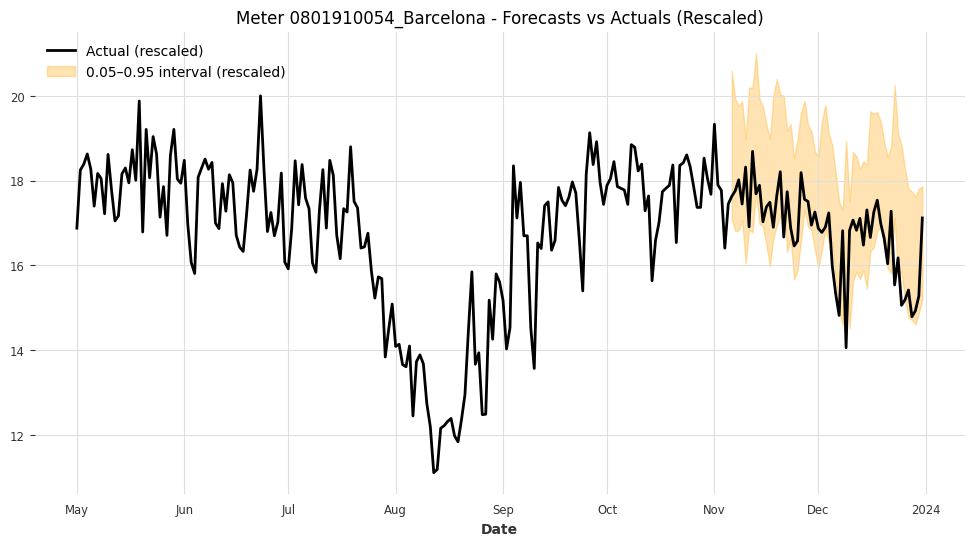

Meter 0801910054_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 2.8869



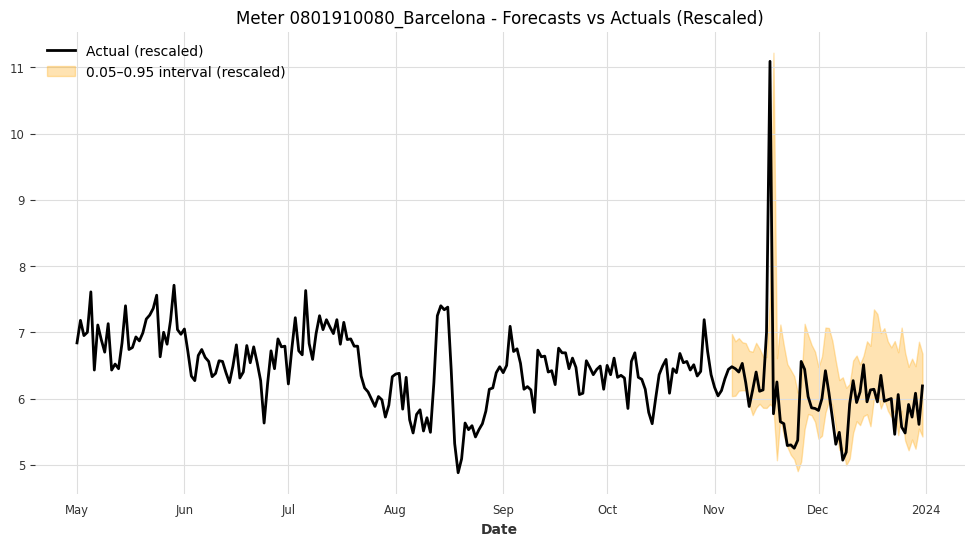

Meter 0801910080_Barcelona - Coverage: 0.7679, Mean Interval Width (rescaled): 1.1908



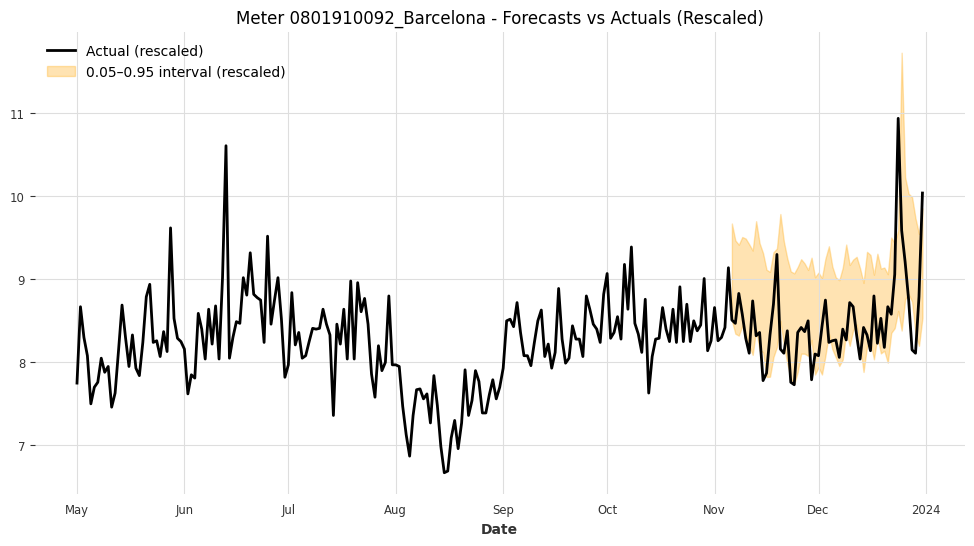

Meter 0801910092_Barcelona - Coverage: 0.6429, Mean Interval Width (rescaled): 1.1804



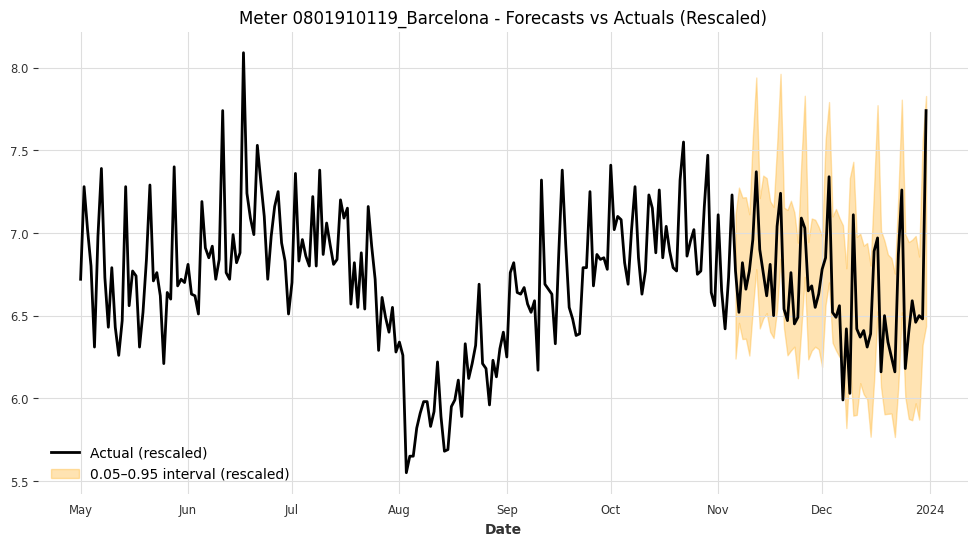

Meter 0801910119_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 0.9642



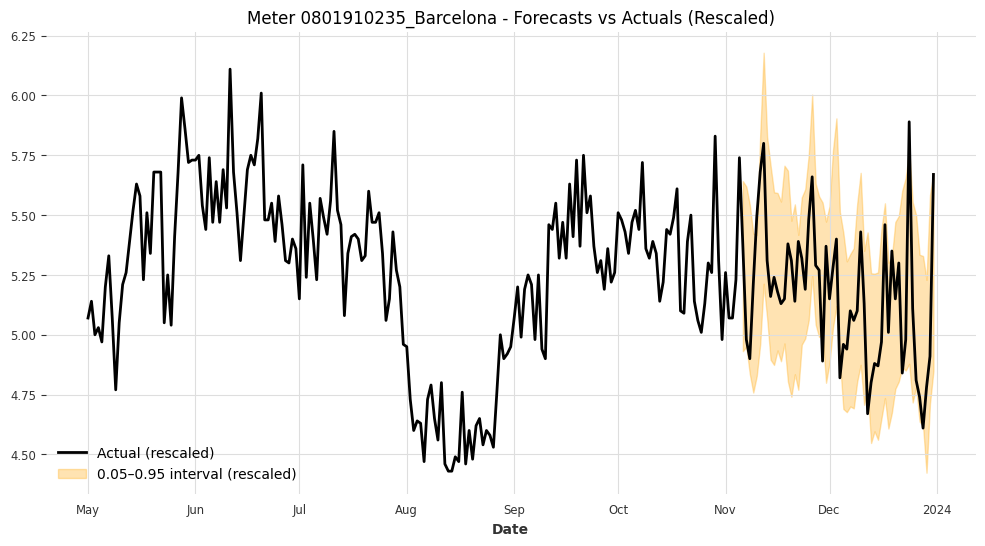

Meter 0801910235_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 0.7181



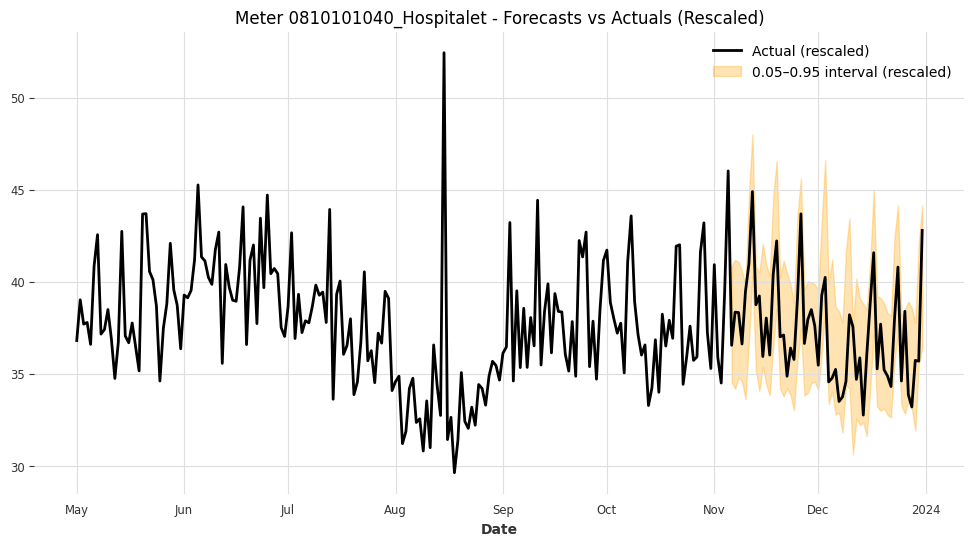

Meter 0810101040_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 6.5562



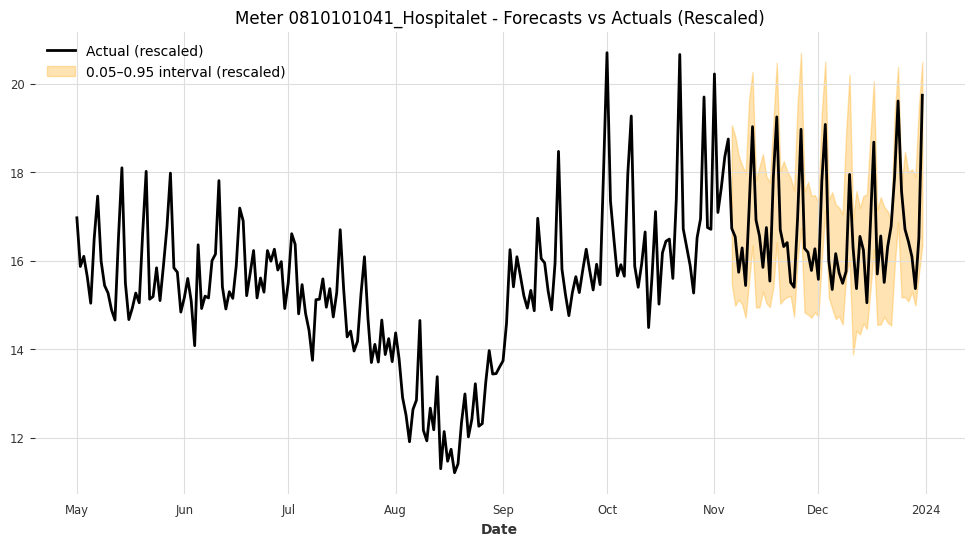

Meter 0810101041_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 3.1097



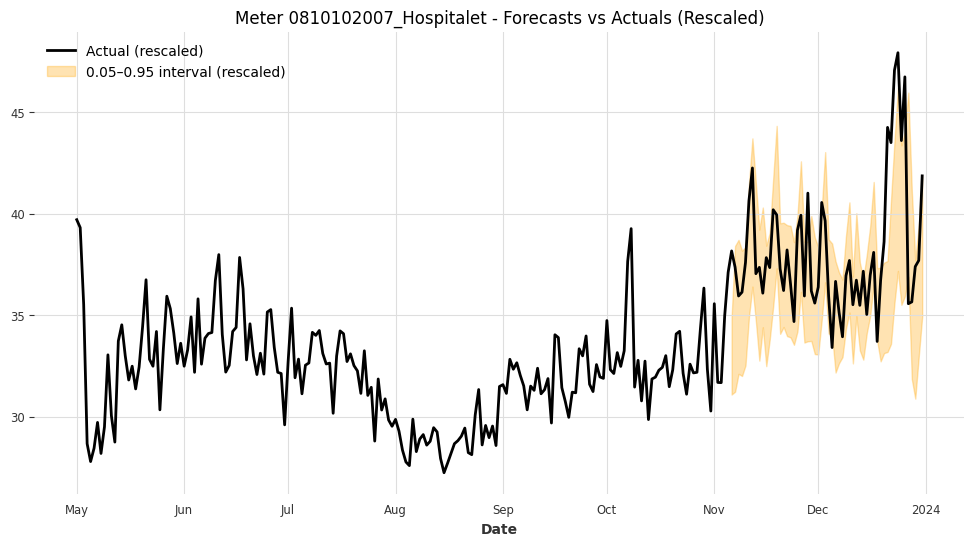

Meter 0810102007_Hospitalet - Coverage: 0.7321, Mean Interval Width (rescaled): 5.7945



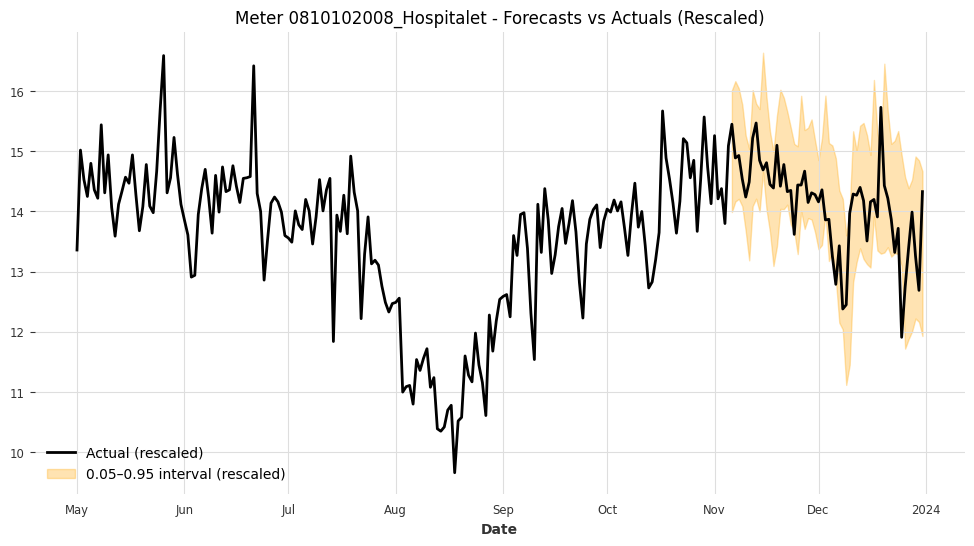

Meter 0810102008_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 2.0036



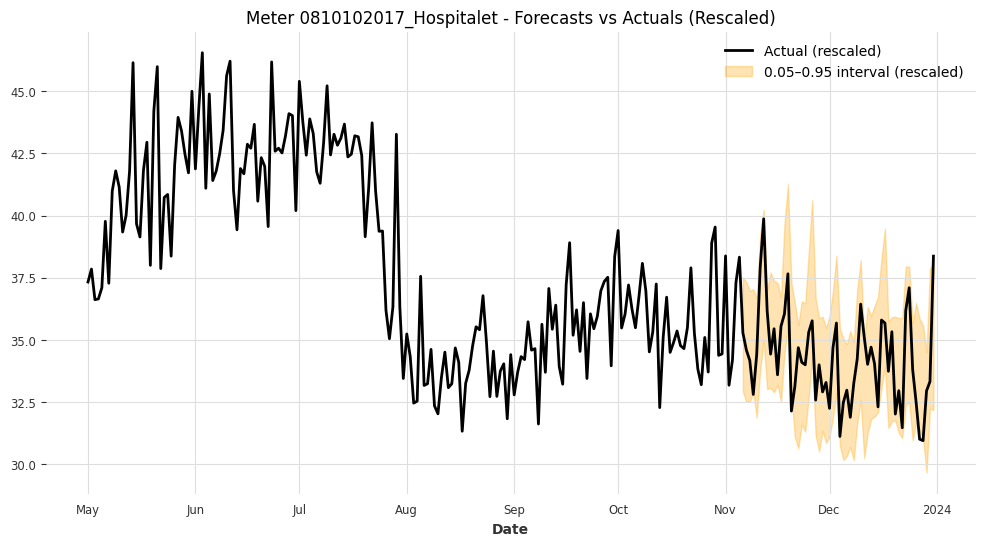

Meter 0810102017_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 4.9074



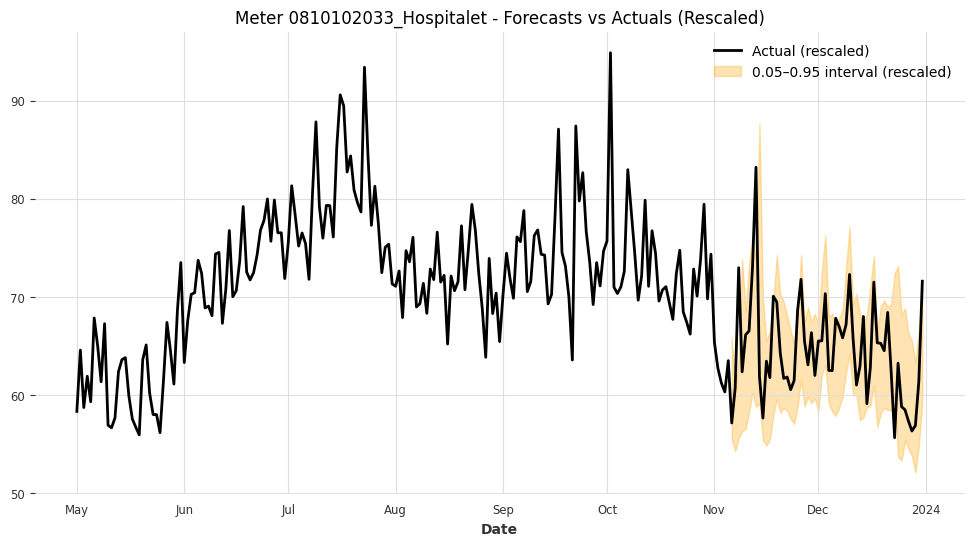

Meter 0810102033_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 11.5311



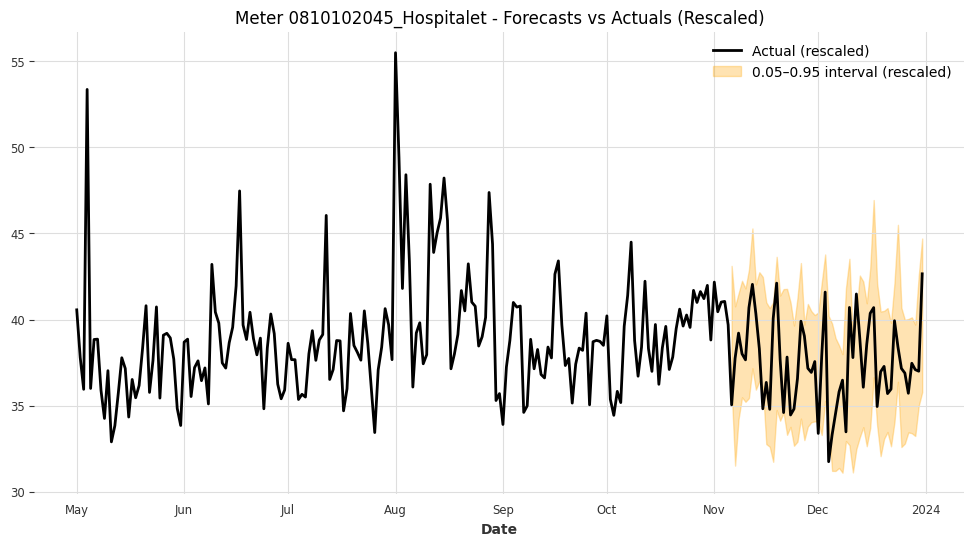

Meter 0810102045_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 7.7666



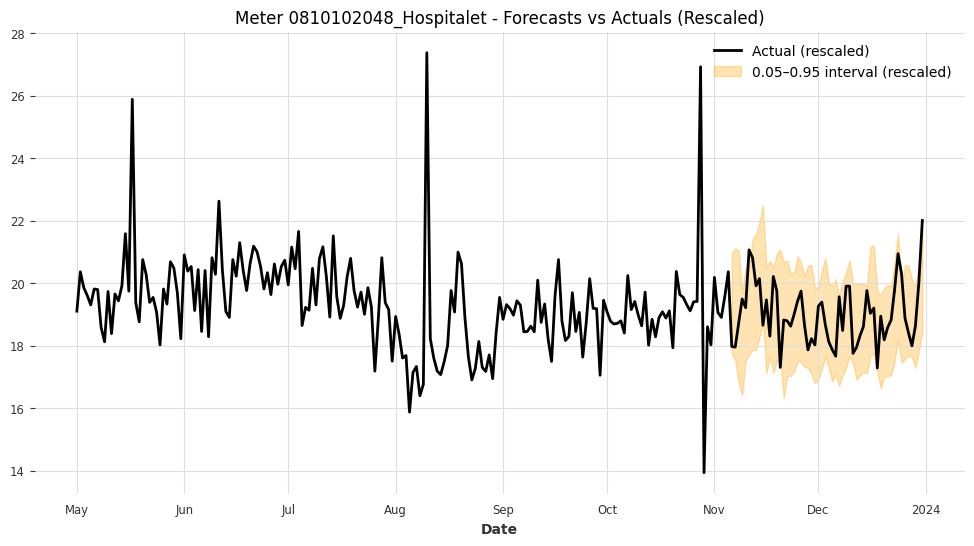

Meter 0810102048_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 3.1545



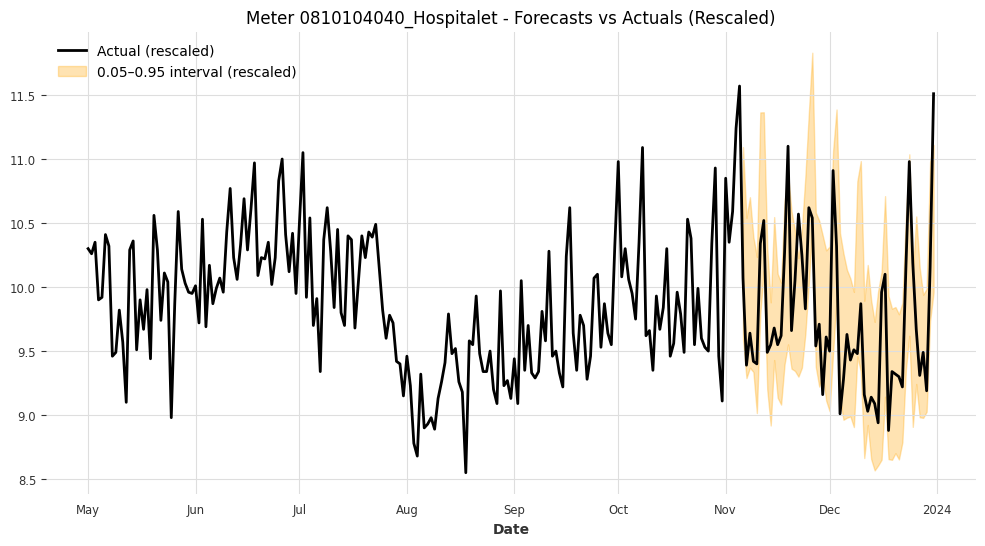

Meter 0810104040_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 1.2278



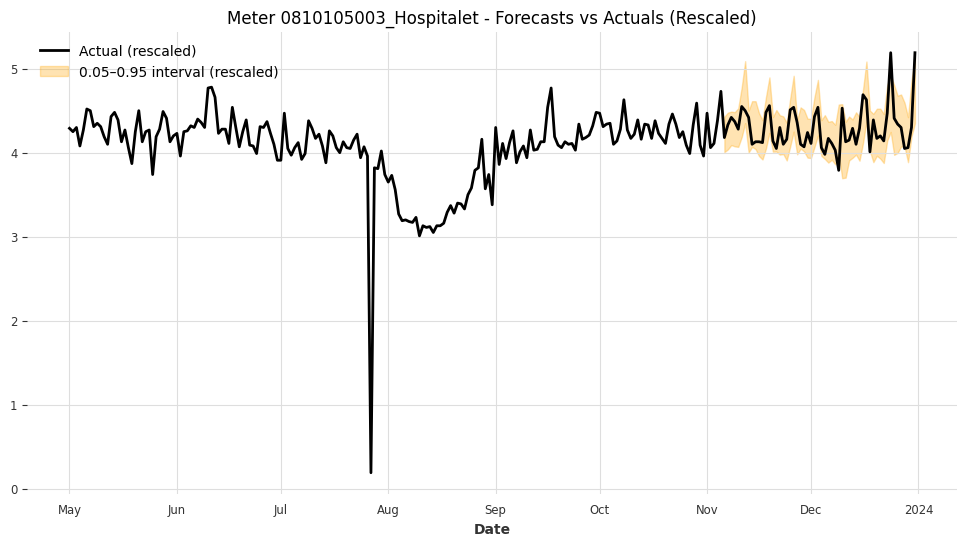

Meter 0810105003_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 0.5539



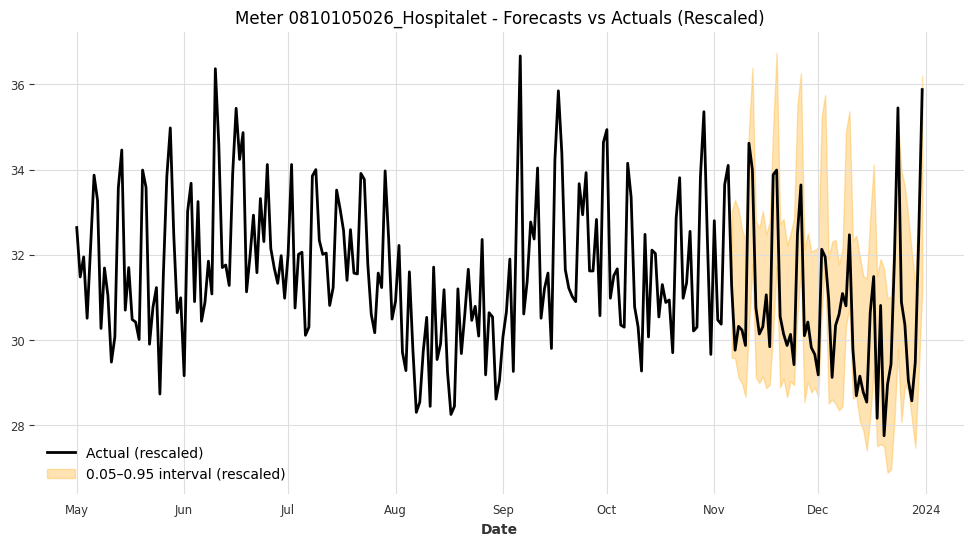

Meter 0810105026_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 4.0701



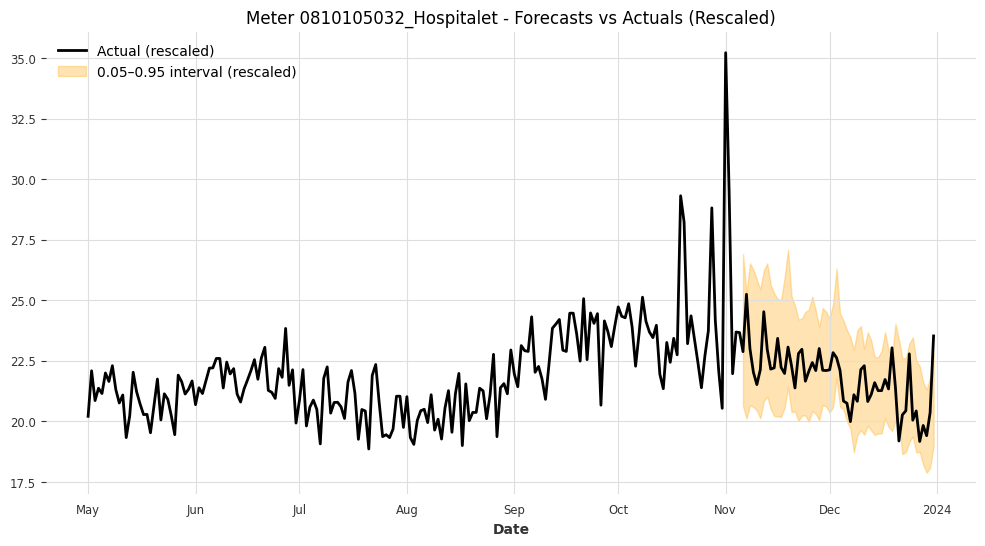

Meter 0810105032_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 4.2676



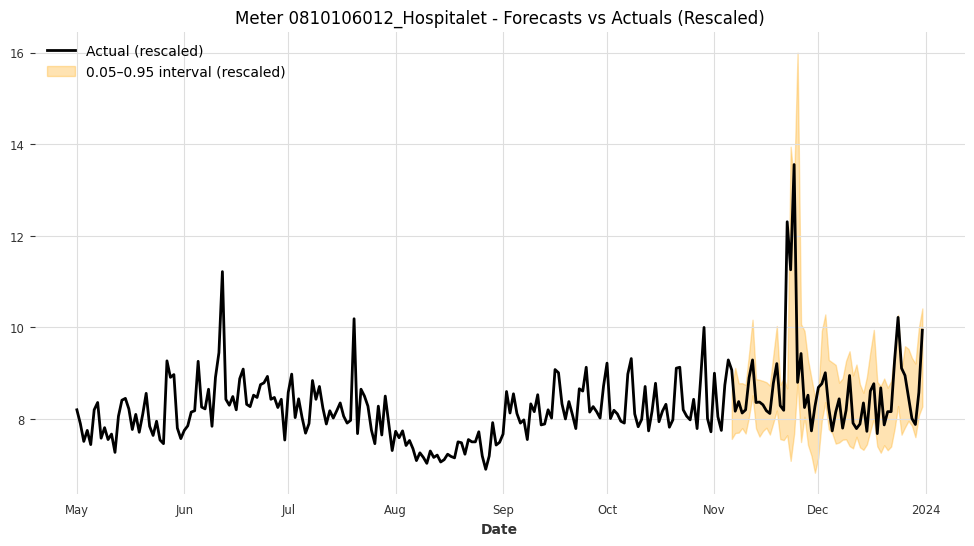

Meter 0810106012_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 1.7926



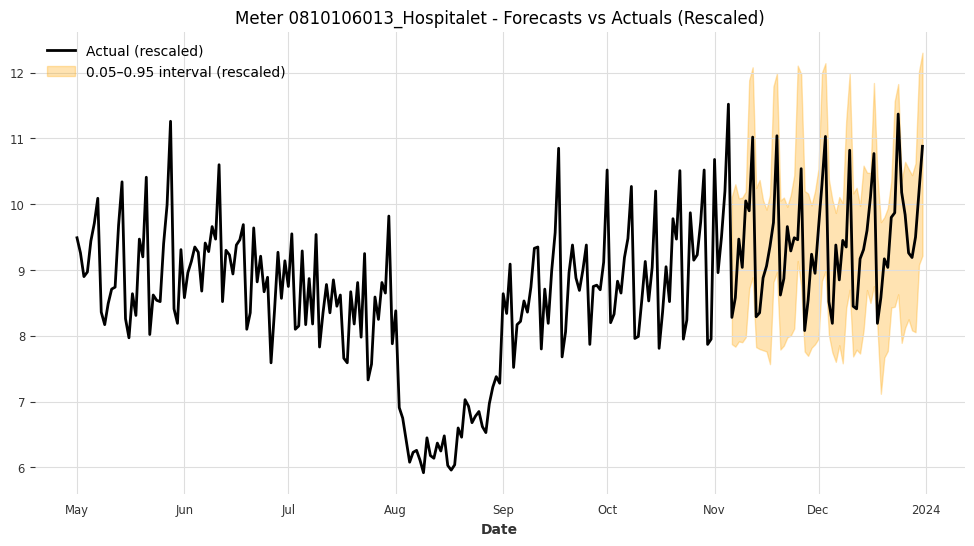

Meter 0810106013_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 2.5184



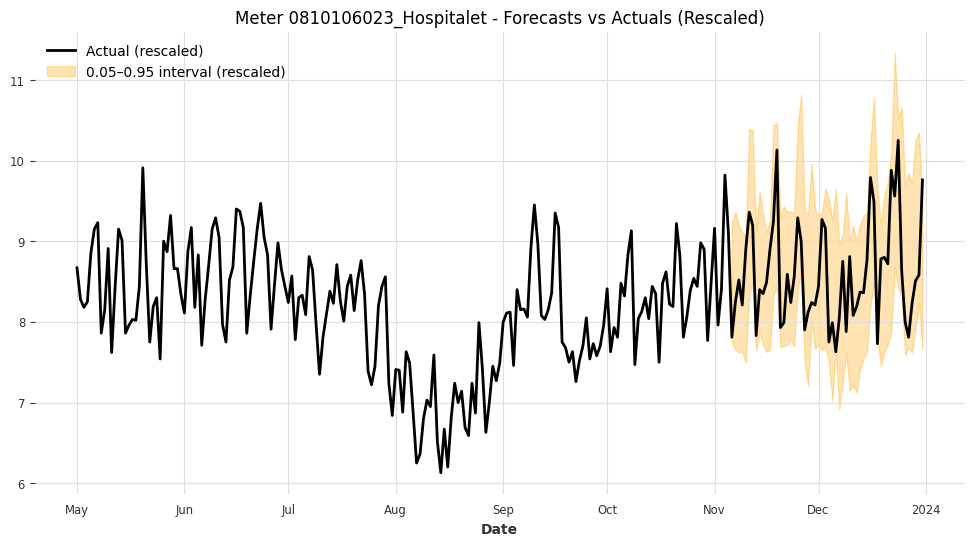

Meter 0810106023_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 1.8952



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # We use this to merge forecast segments

for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")


In [ ]:
# let's finish with the selected test set

In [ ]:
model = RNNModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/rnnGRU/simple/rnnGRU_model.pkl")
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test_reduced/scaled_test_reduced.pkl')
print(test_data.keys())

# We extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [ ]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# Loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=1,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=1,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})
    print(f"\nResults for meter {meter_id}:\n", df_results)

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902043_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  1.780148


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903008_Barcelona:
    Interval  Coverage    Width
0       0.9  0.910714  2.68217


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903021_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  1.240441


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903026_Barcelona:
    Interval  Coverage    Width
0       0.9  0.839286  1.64657


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  0.565096


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  1.493603


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903213_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  0.346284


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904027_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  2.760407


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904047_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  3.136877


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904049_Barcelona:
    Interval  Coverage     Width
0       0.9  0.767857  2.817798


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905057_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  2.528425


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906071_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  0.977939


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910007_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  0.886253


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0807302003_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  4.976886


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0807710008_Hospitalet:
    Interval  Coverage      Width
0       0.9  0.857143  67.300813


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101004_Hospitalet:
    Interval  Coverage     Width
0       0.9      0.75  6.065494


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101011_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.928571  3.06183


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101018_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  1.217895


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101019_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.892857  1.39633


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101024_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.767857  2.438842


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101029_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  5.470806


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101033_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.785714  4.607146


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101039_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  3.580649


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  5.641454


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102005_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  2.310096


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.678571  4.744743


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102016_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  3.551383


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102024_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  2.109675


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102034_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  6.592252


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102038_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.678571  4.41912


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102039_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.678571  5.241162


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  7.733881


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  3.607179


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102049_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  3.569674


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103002_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.607143  0.669164


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103006_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  4.809618


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103011_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  3.007895


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103012_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  0.358028


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103018_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  1.614673


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103022_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.910714  2.73225


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104007_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  3.333435


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104010_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  1.972761


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104011_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  3.114579


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104033_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.767857  2.996626


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104035_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.785714  0.770391


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104040_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.821429  1.20109


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105001_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  0.649363


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  4.620223


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105018_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.696429  1.805593


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106005_Hospitalet:
    Interval  Coverage   Width
0       0.9  0.928571  1.0413


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106008_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.803571  1.461781


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106010_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.892857  1.03868


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106014_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  0.935862


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106016_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  0.794308


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106019_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  0.982084


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106021_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  1.339543


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106022_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  0.842497


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  1.596044


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106026_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  0.521076


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106032_Hospitalet:
    Interval  Coverage     Width
0       0.9      0.75  1.632305


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")

Mean Coverage: 0.8452
Mean Width: 3.6390


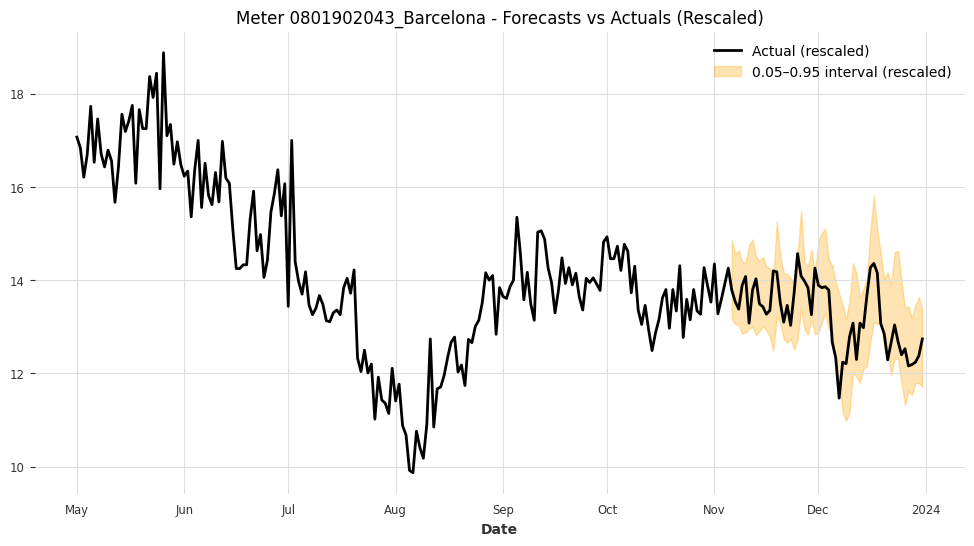

Meter 0801902043_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 1.7801



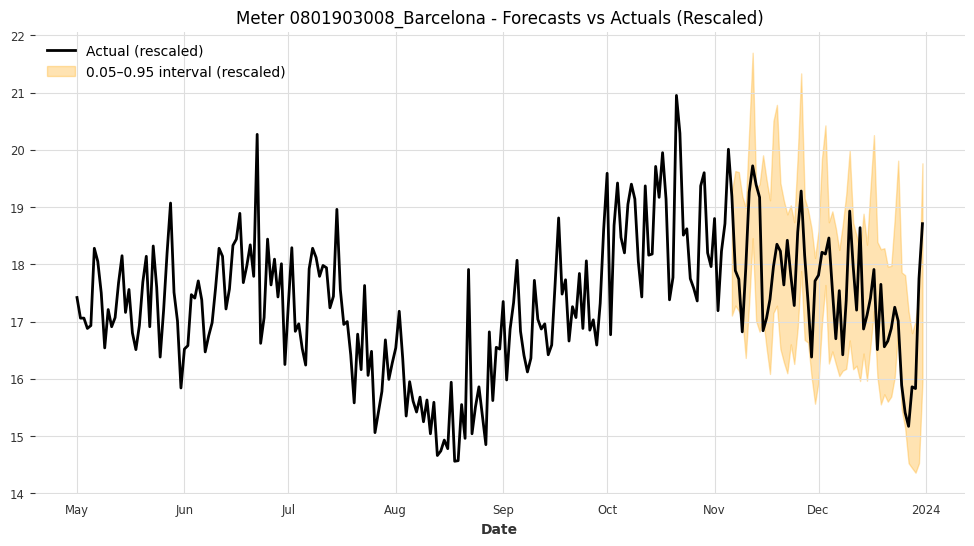

Meter 0801903008_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 2.6822



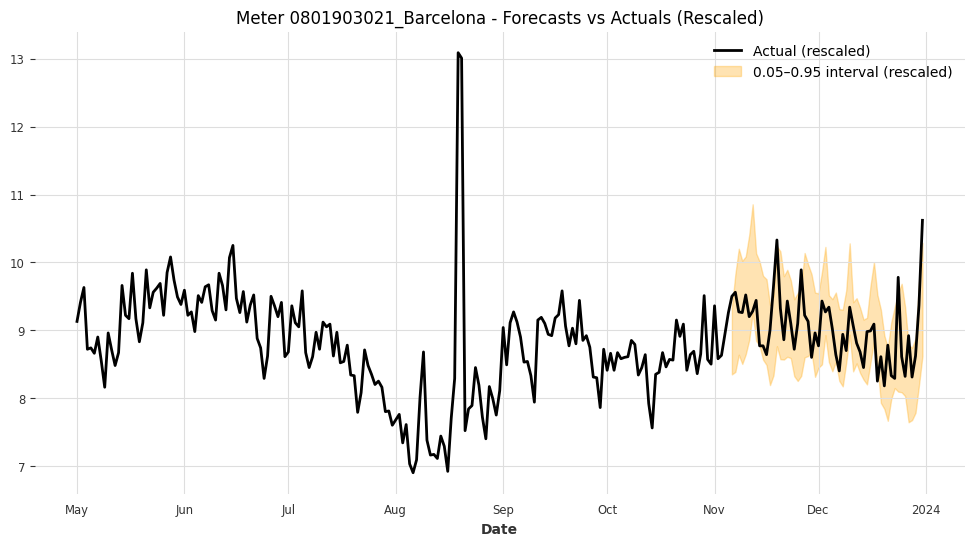

Meter 0801903021_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 1.2404



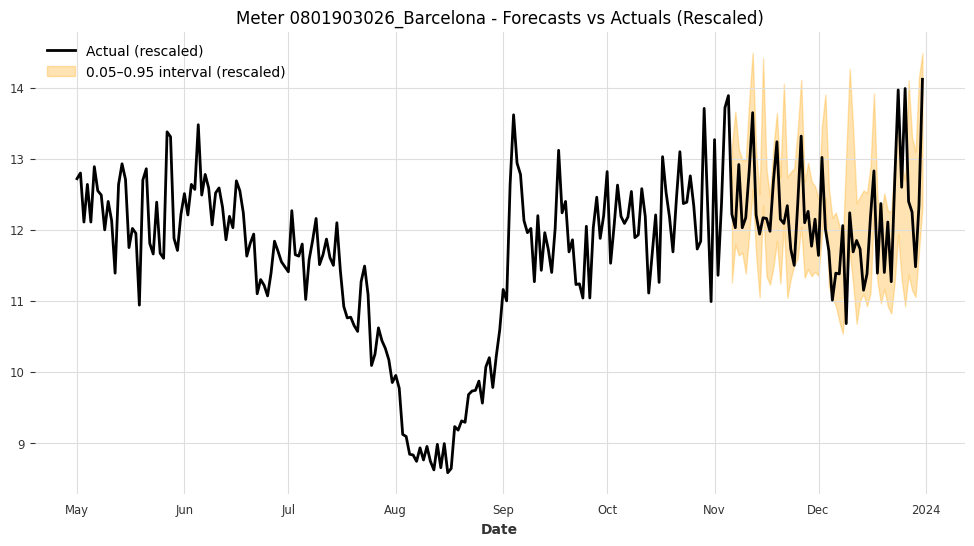

Meter 0801903026_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 1.6466



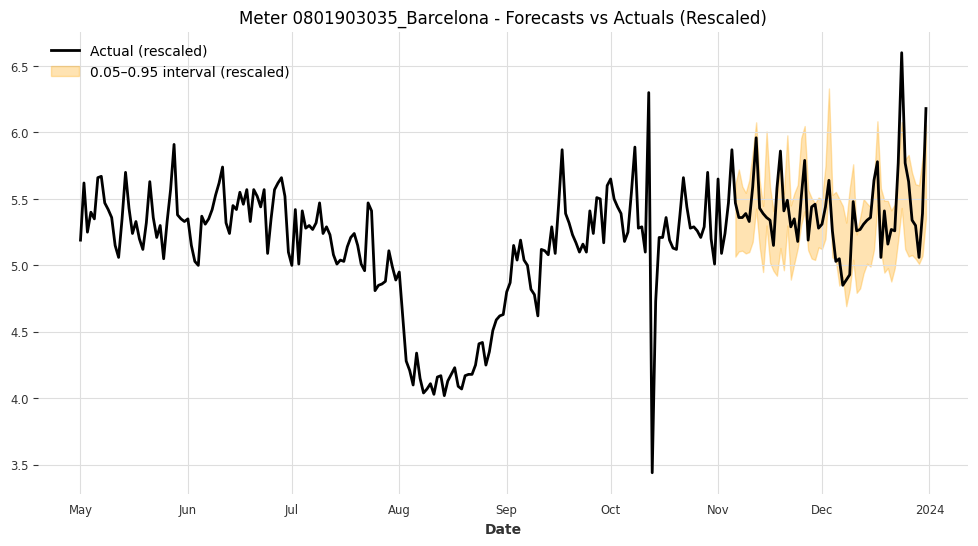

Meter 0801903035_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 0.5651



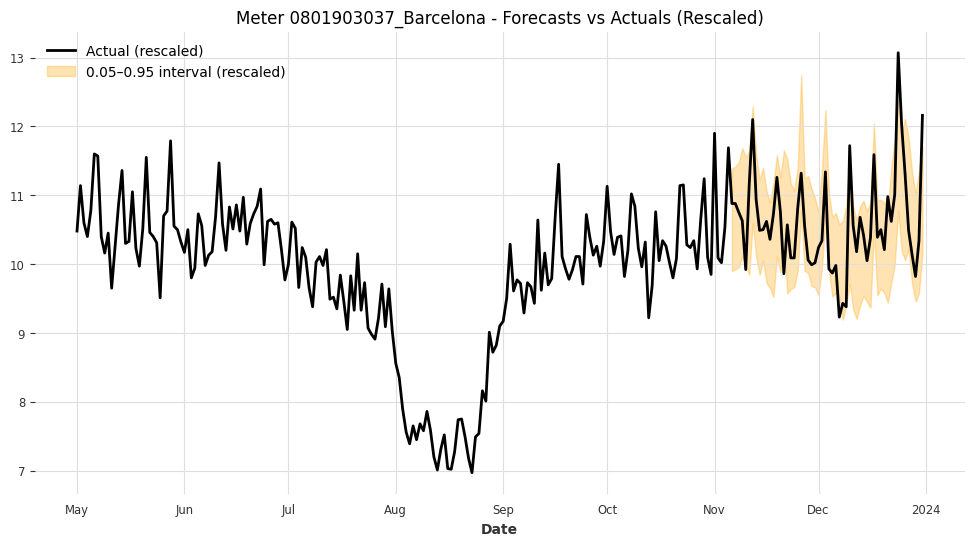

Meter 0801903037_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 1.4936



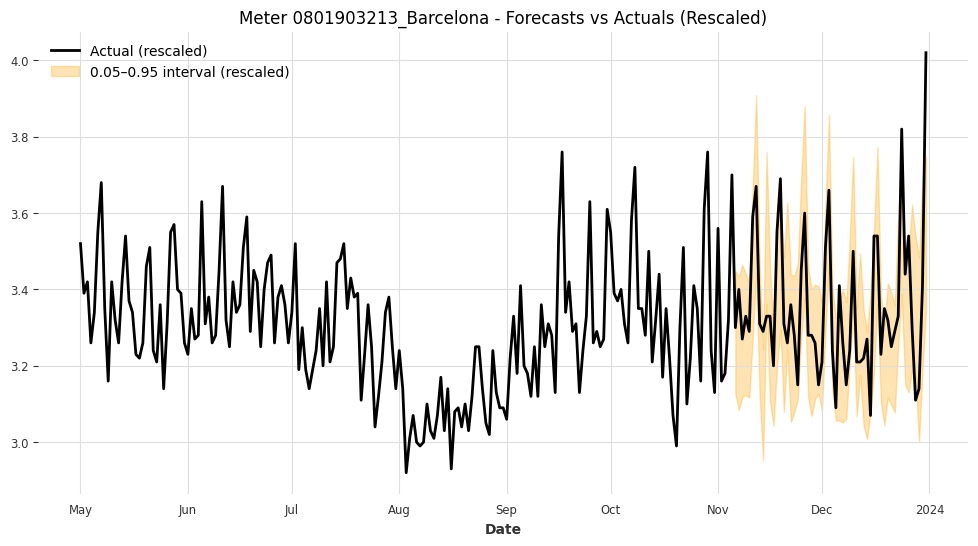

Meter 0801903213_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 0.3463



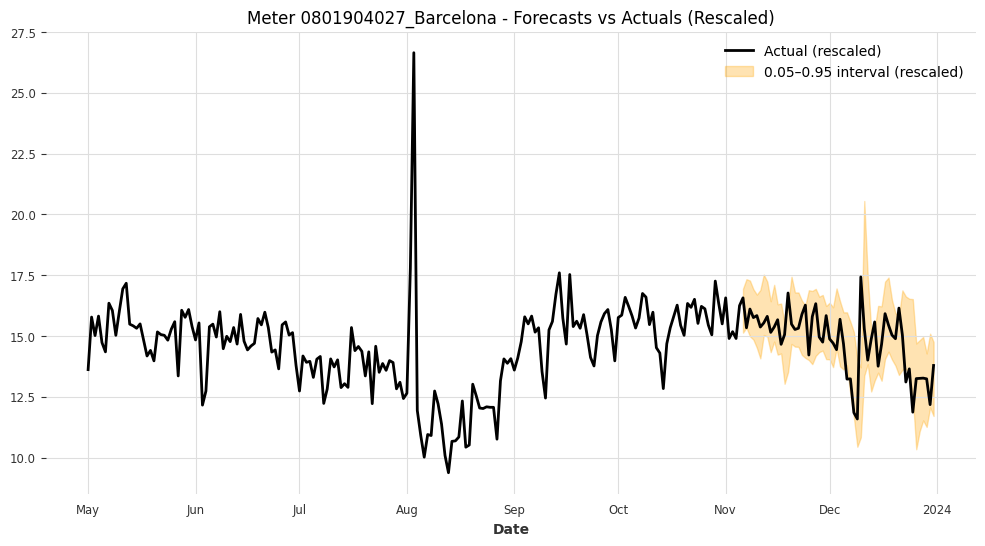

Meter 0801904027_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 2.7604



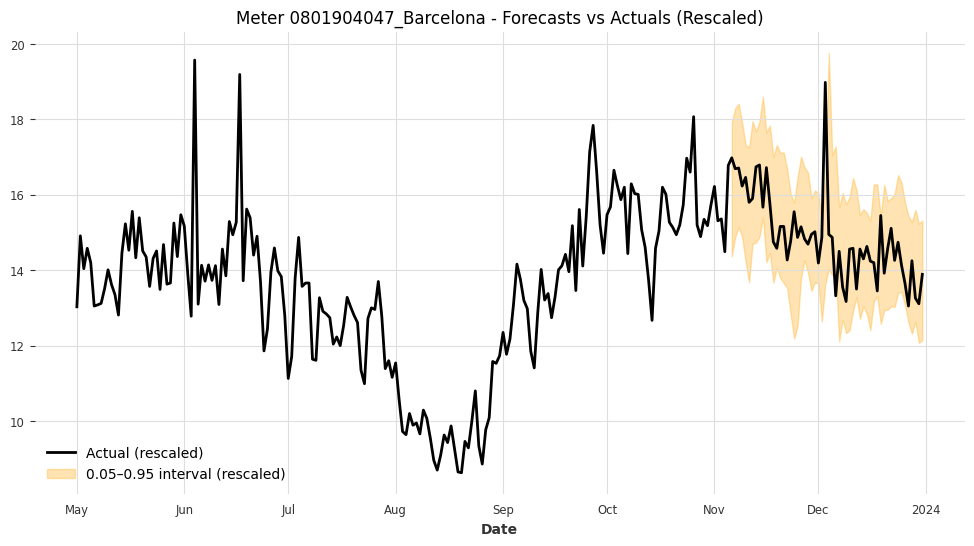

Meter 0801904047_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 3.1369



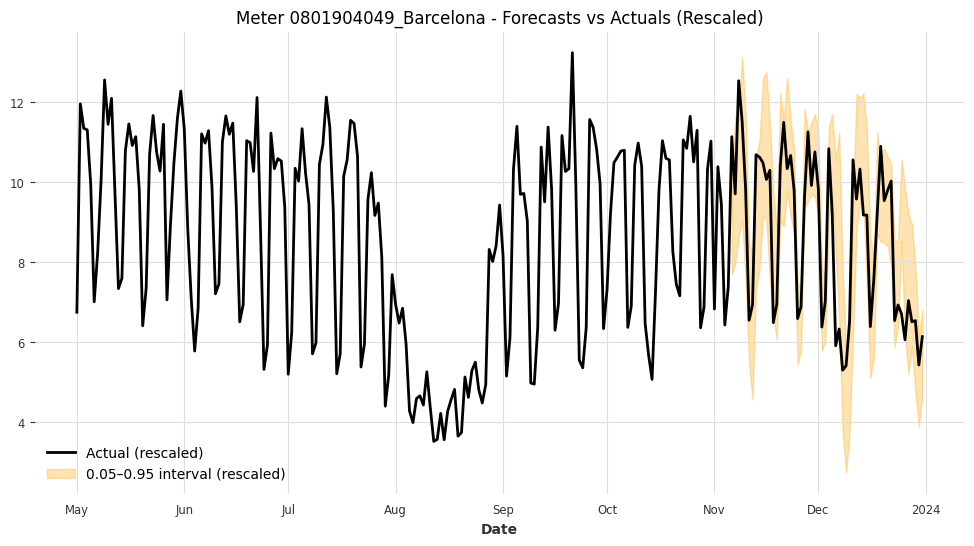

Meter 0801904049_Barcelona - Coverage: 0.7679, Mean Interval Width (rescaled): 2.8178



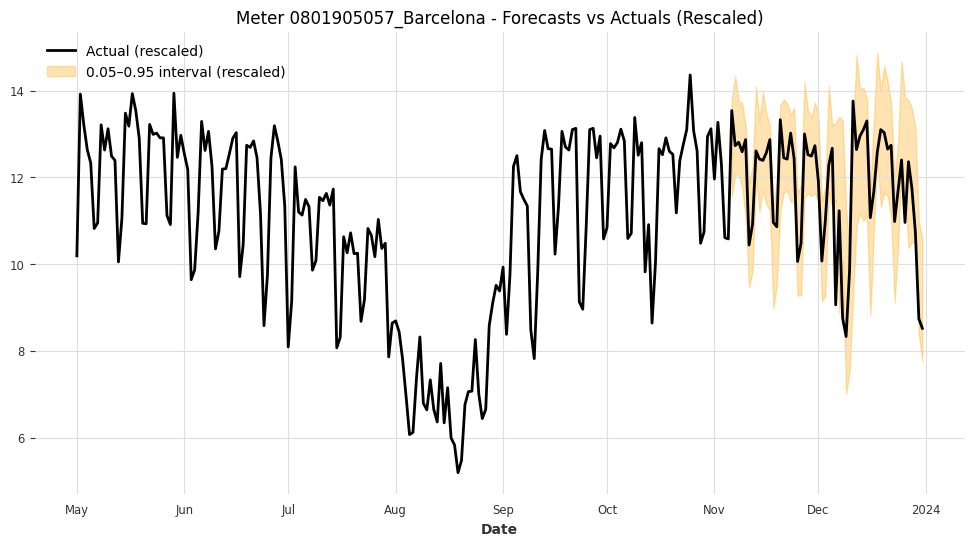

Meter 0801905057_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 2.5284



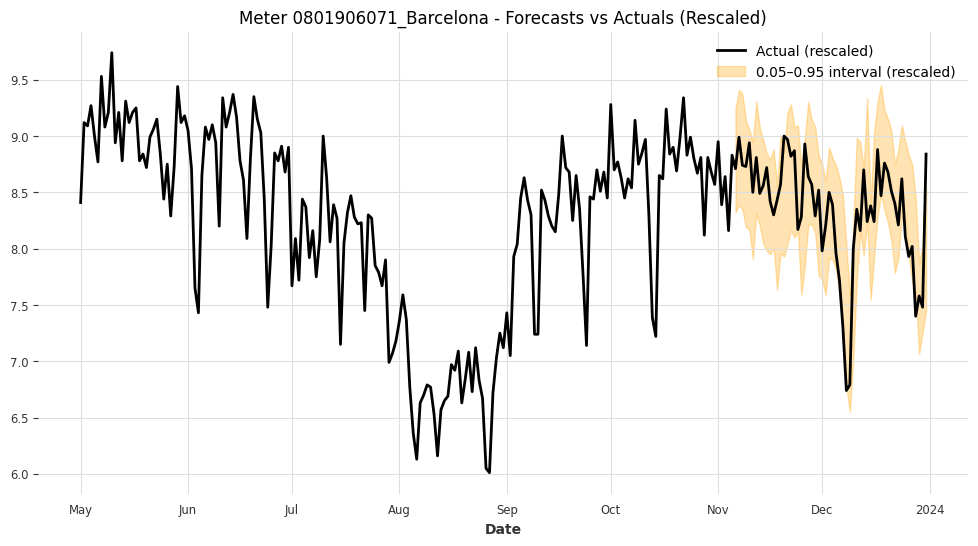

Meter 0801906071_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 0.9779



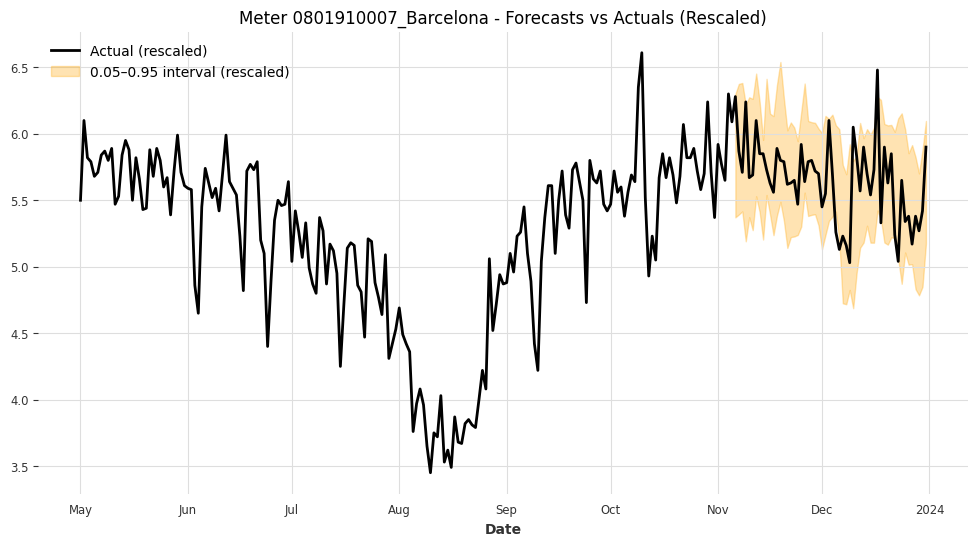

Meter 0801910007_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 0.8863



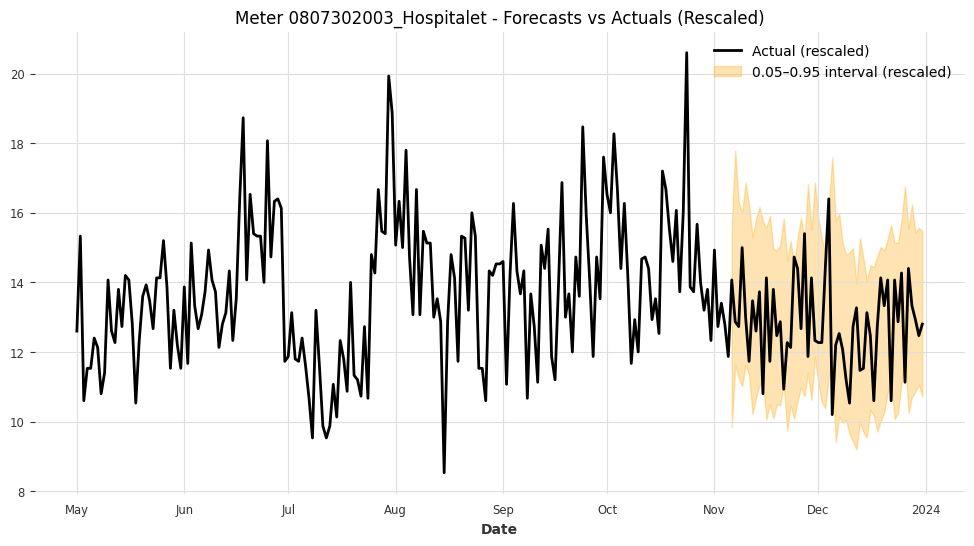

Meter 0807302003_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 4.9769



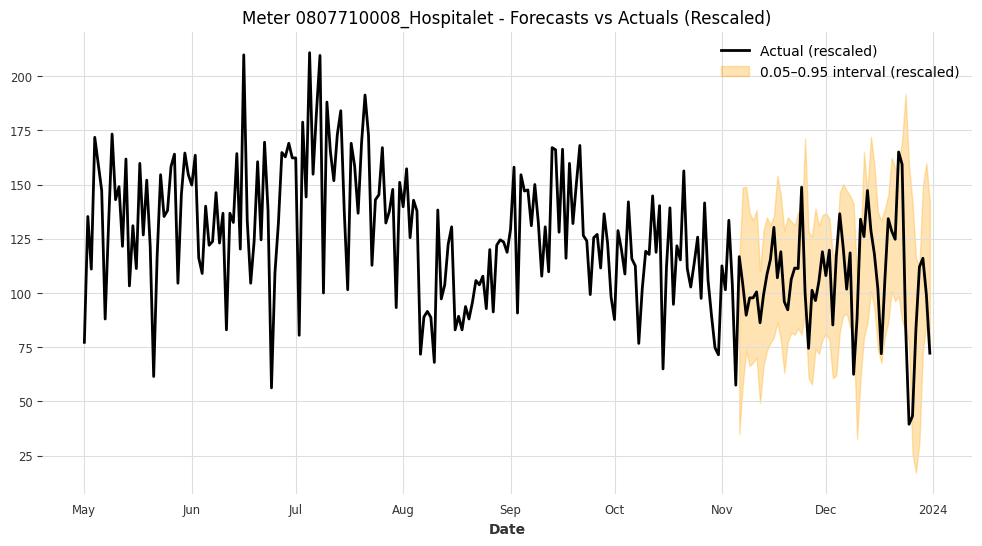

Meter 0807710008_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 67.3008



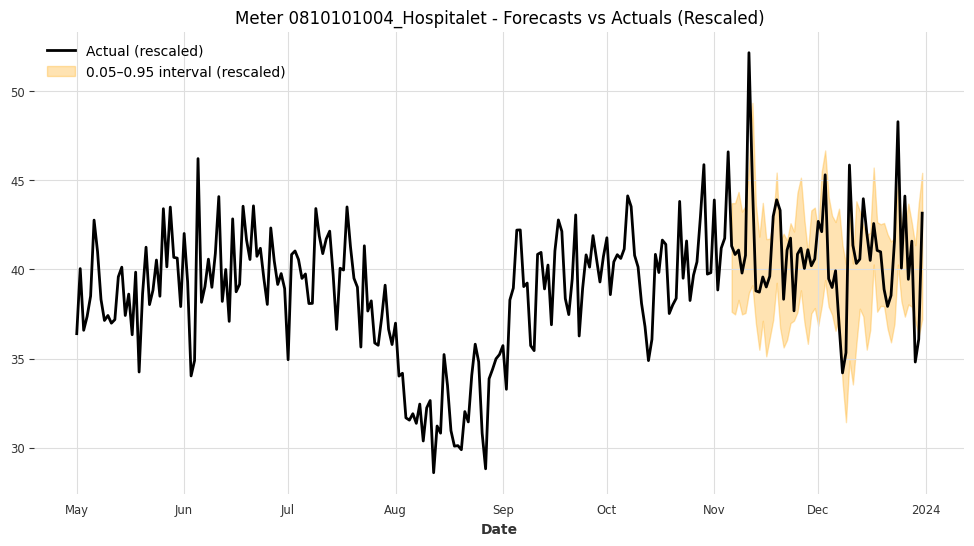

Meter 0810101004_Hospitalet - Coverage: 0.7500, Mean Interval Width (rescaled): 6.0655



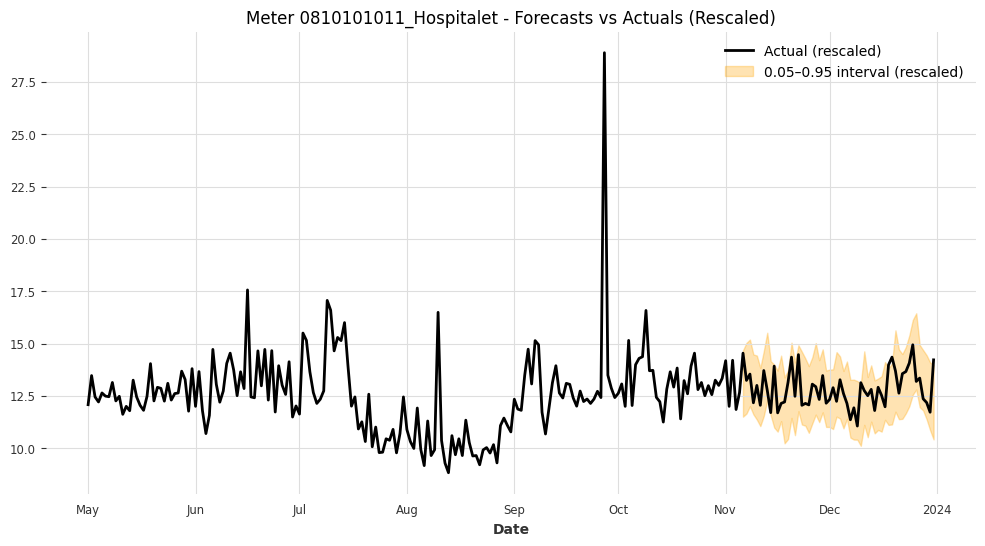

Meter 0810101011_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 3.0618



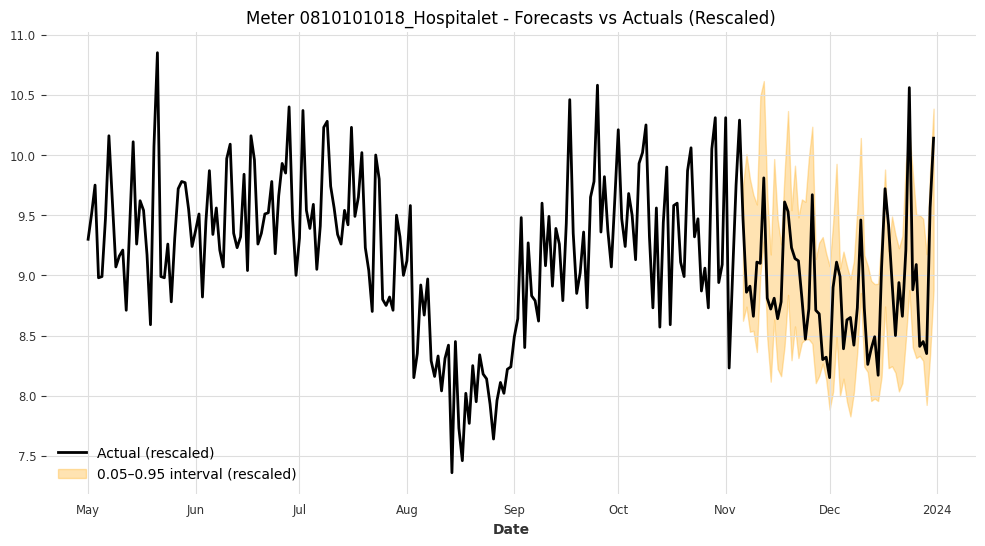

Meter 0810101018_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 1.2179



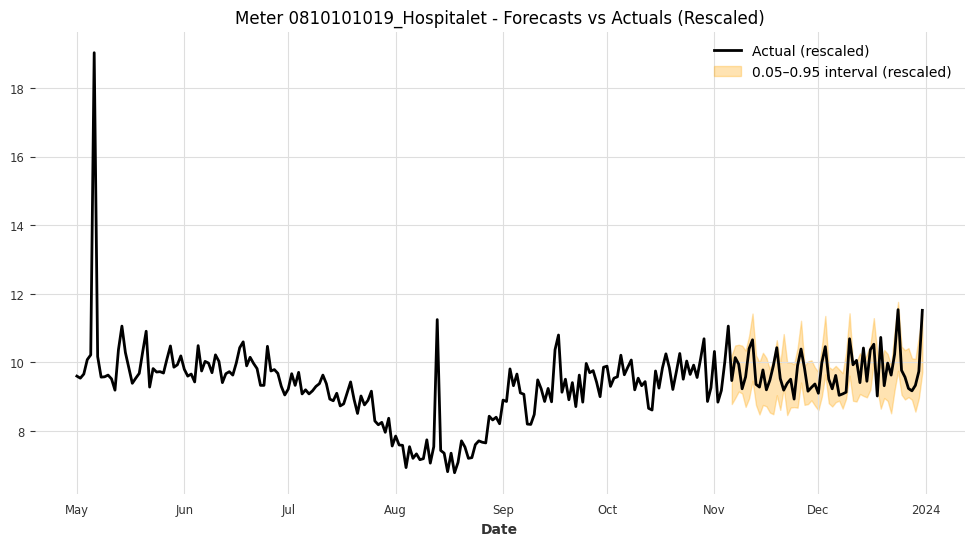

Meter 0810101019_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 1.3963



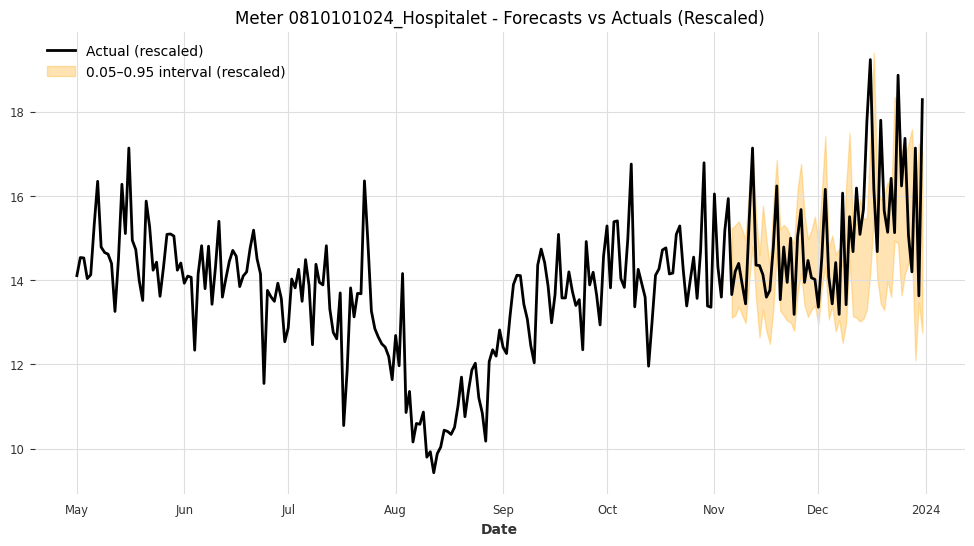

Meter 0810101024_Hospitalet - Coverage: 0.7679, Mean Interval Width (rescaled): 2.4388



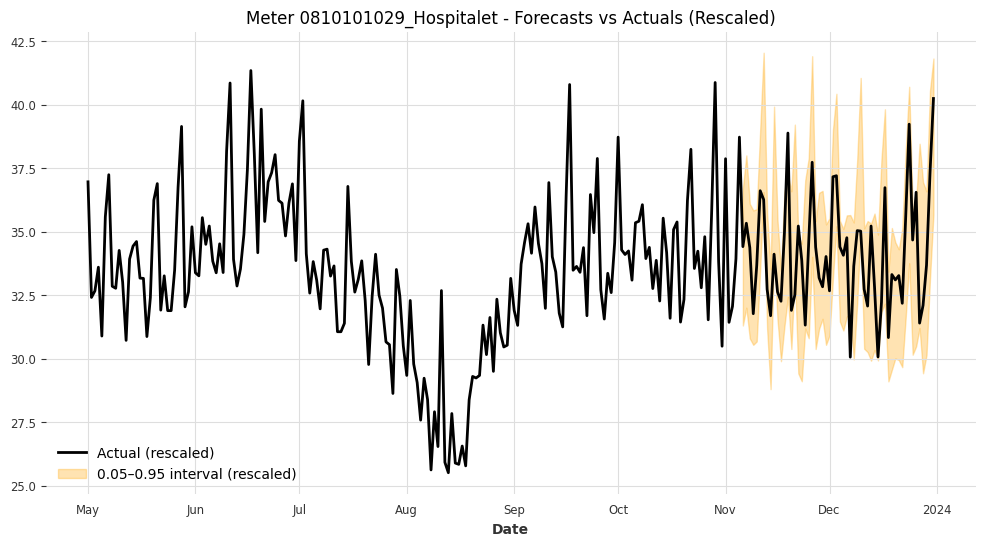

Meter 0810101029_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 5.4708



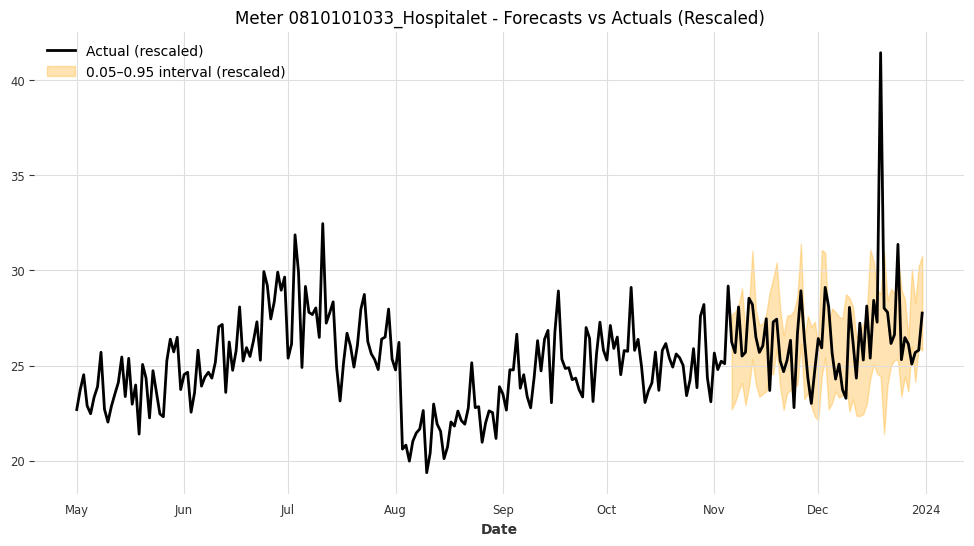

Meter 0810101033_Hospitalet - Coverage: 0.7857, Mean Interval Width (rescaled): 4.6071



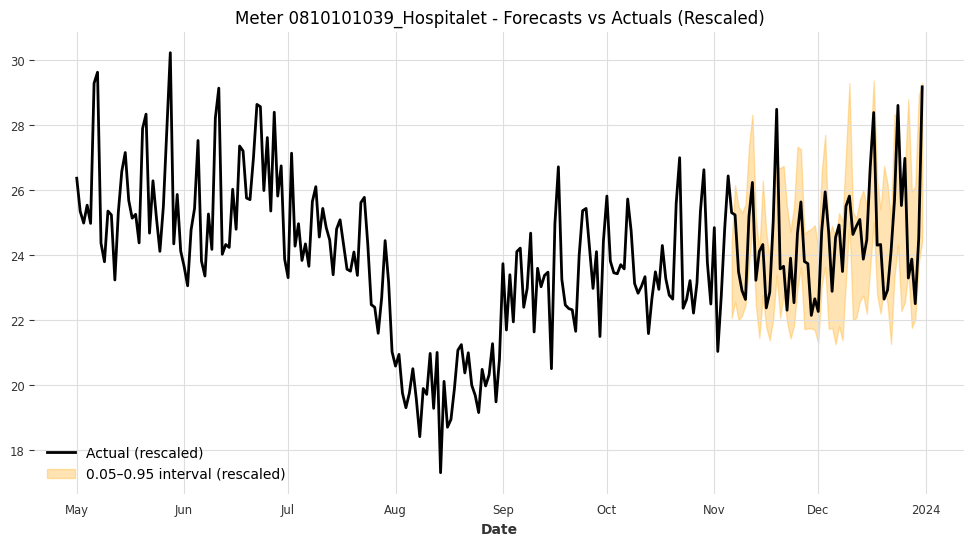

Meter 0810101039_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 3.5806



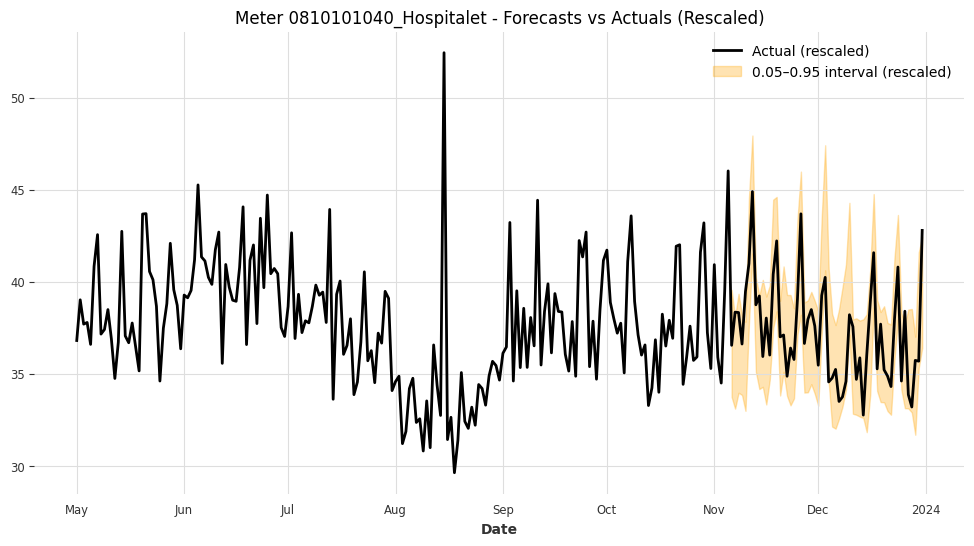

Meter 0810101040_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 5.6415



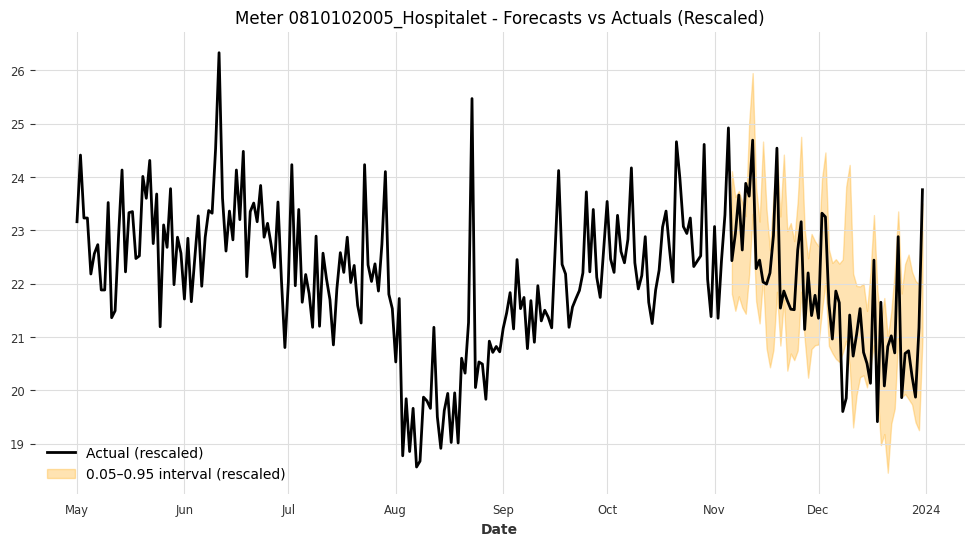

Meter 0810102005_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 2.3101



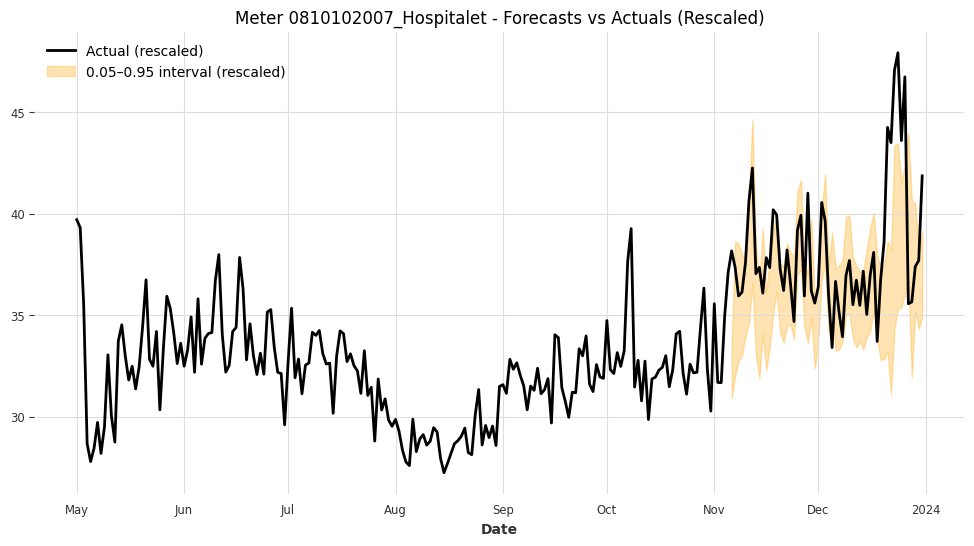

Meter 0810102007_Hospitalet - Coverage: 0.6786, Mean Interval Width (rescaled): 4.7447



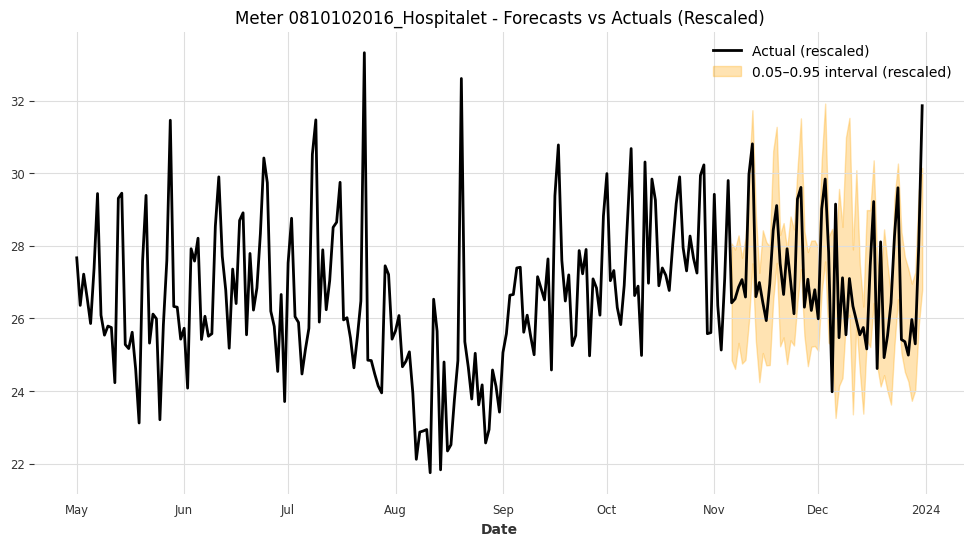

Meter 0810102016_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 3.5514



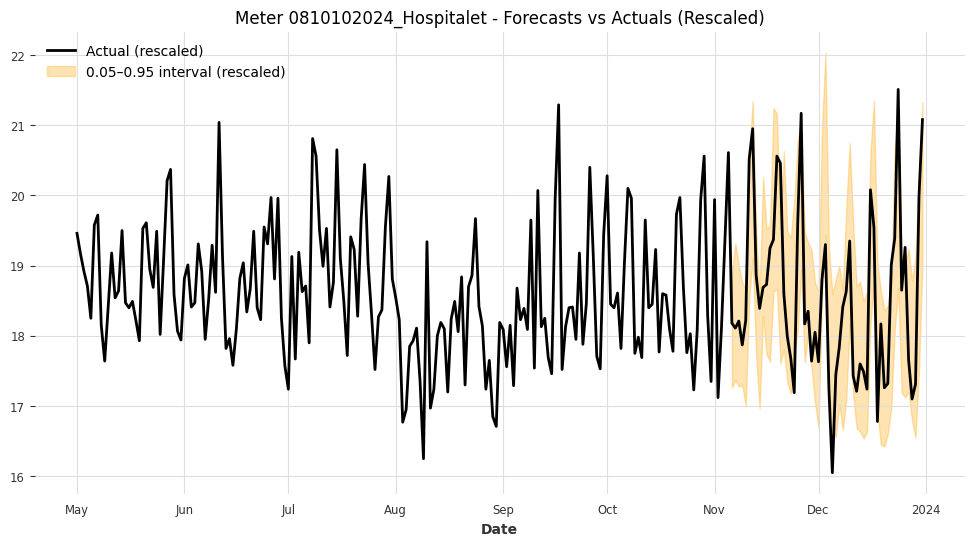

Meter 0810102024_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 2.1097



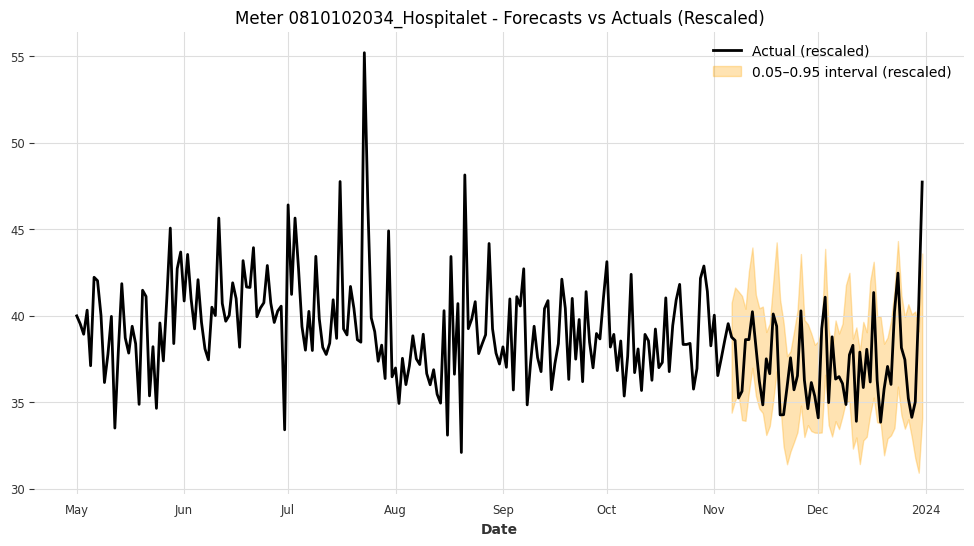

Meter 0810102034_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 6.5923



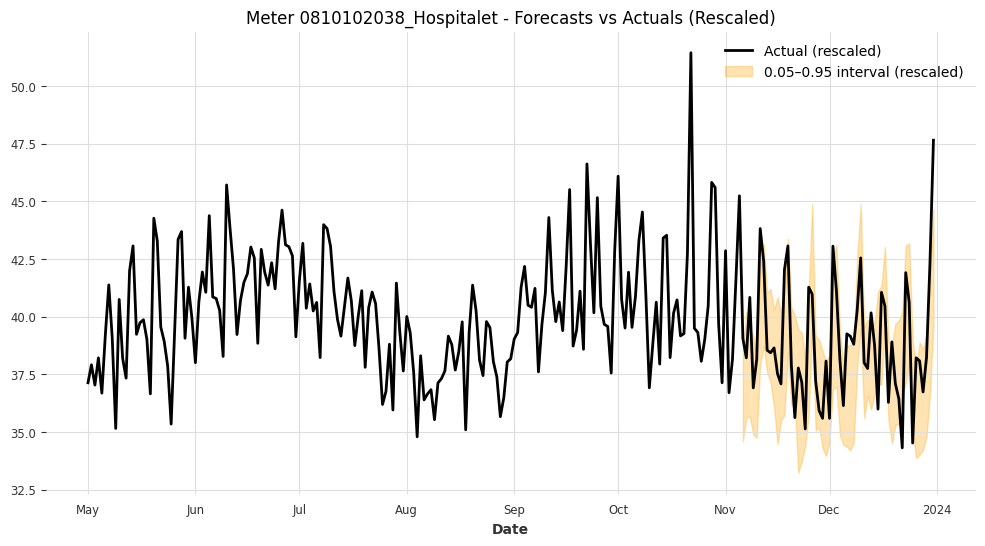

Meter 0810102038_Hospitalet - Coverage: 0.6786, Mean Interval Width (rescaled): 4.4191



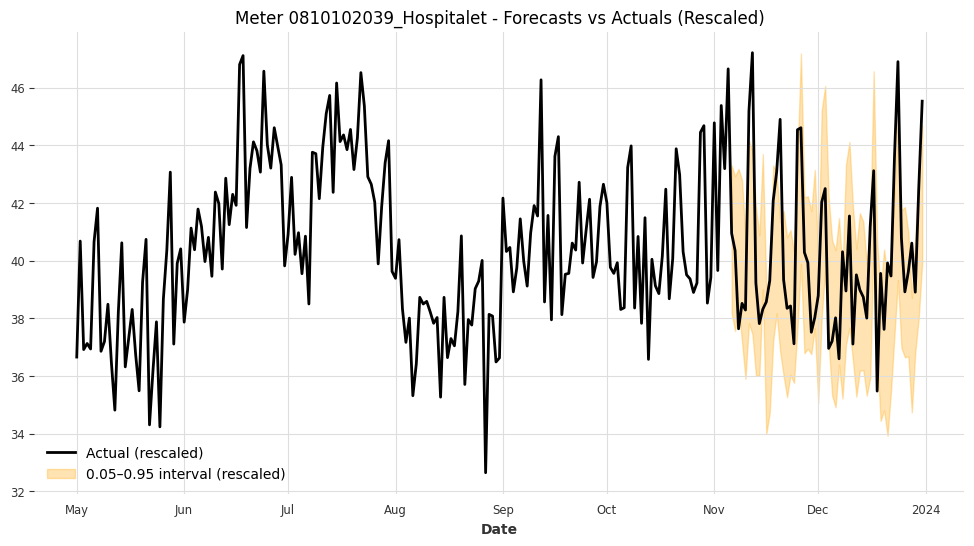

Meter 0810102039_Hospitalet - Coverage: 0.6786, Mean Interval Width (rescaled): 5.2412



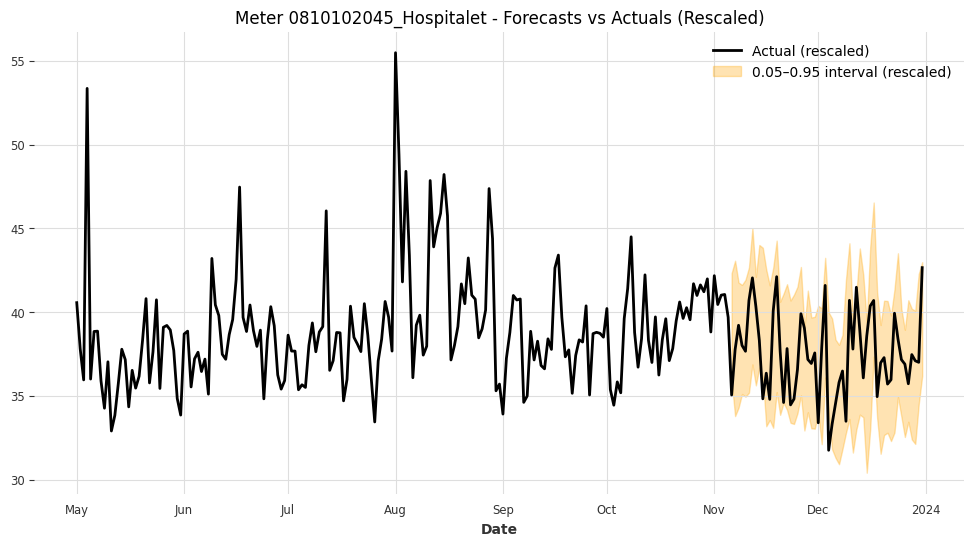

Meter 0810102045_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 7.7339



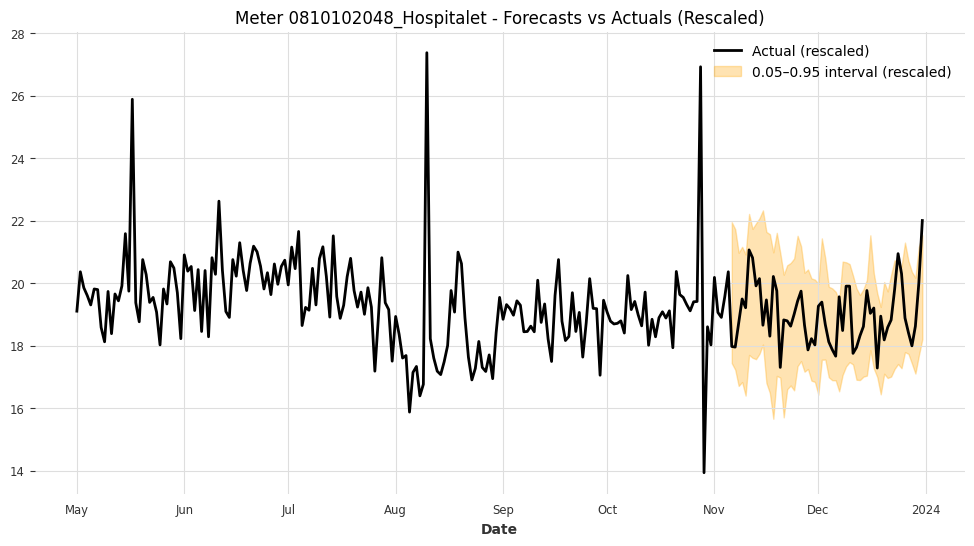

Meter 0810102048_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.6072



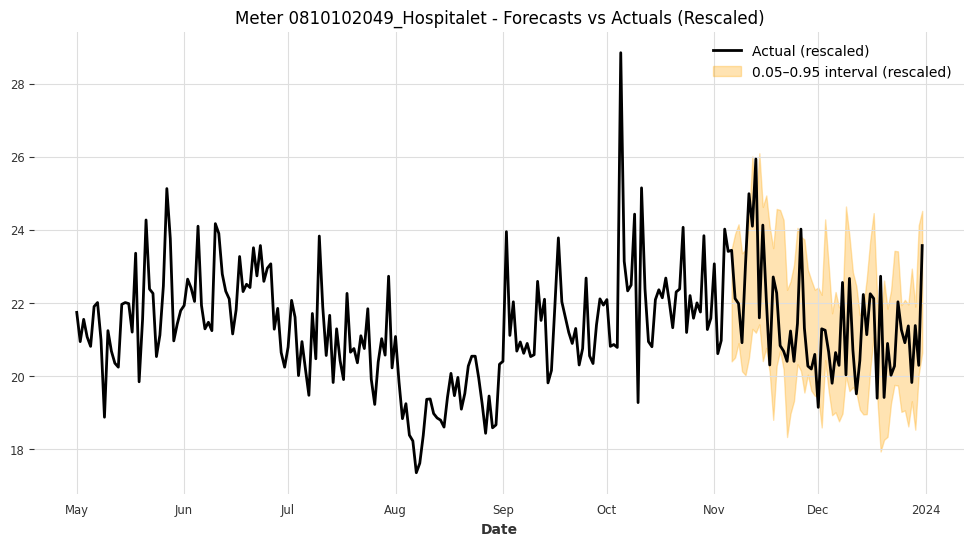

Meter 0810102049_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 3.5697



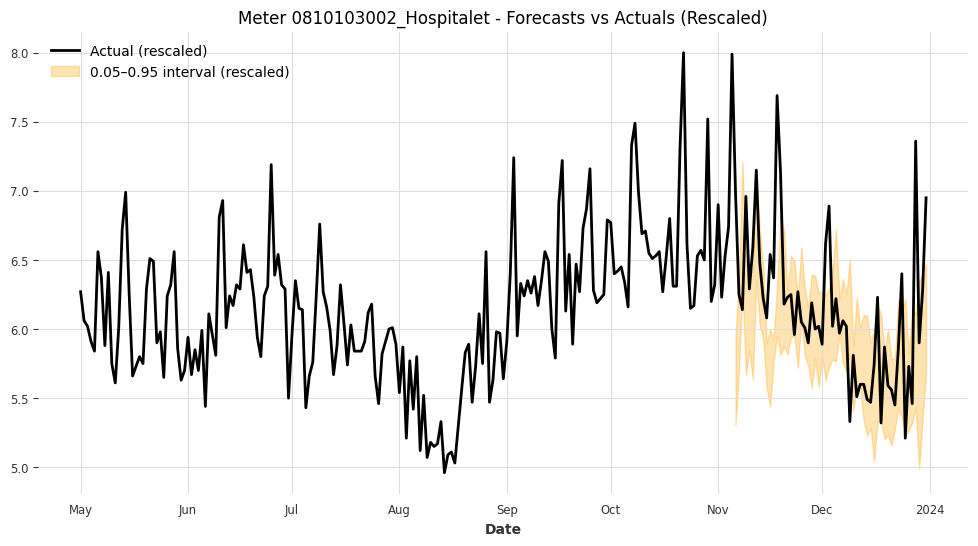

Meter 0810103002_Hospitalet - Coverage: 0.6071, Mean Interval Width (rescaled): 0.6692



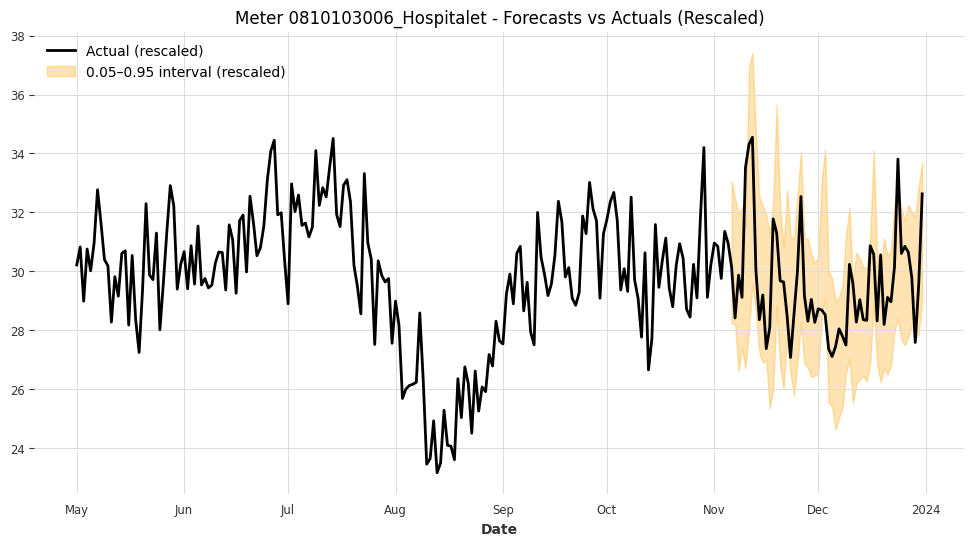

Meter 0810103006_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 4.8096



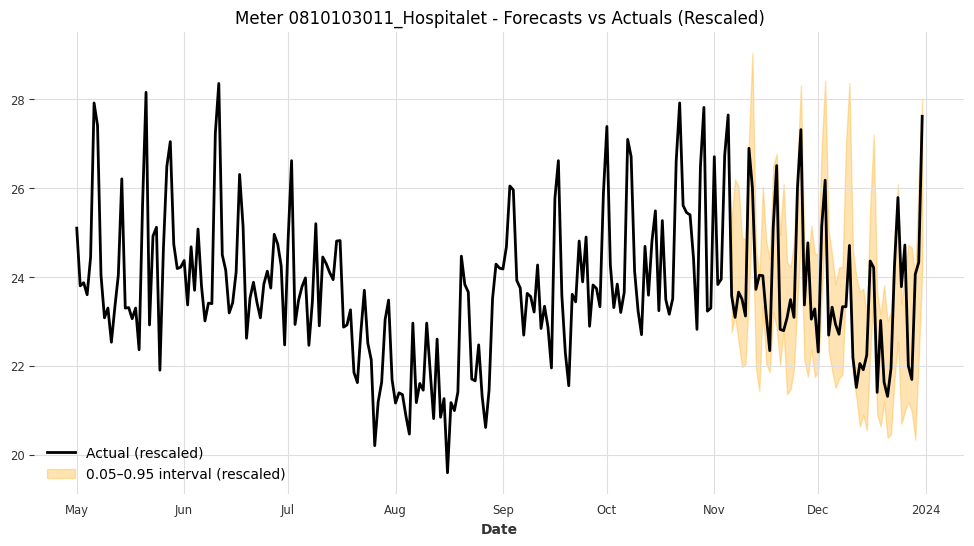

Meter 0810103011_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 3.0079



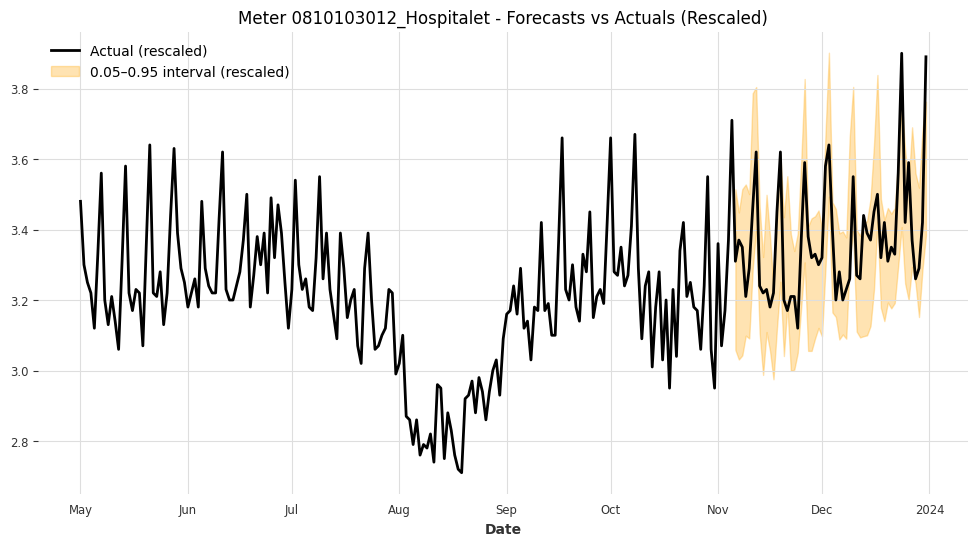

Meter 0810103012_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 0.3580



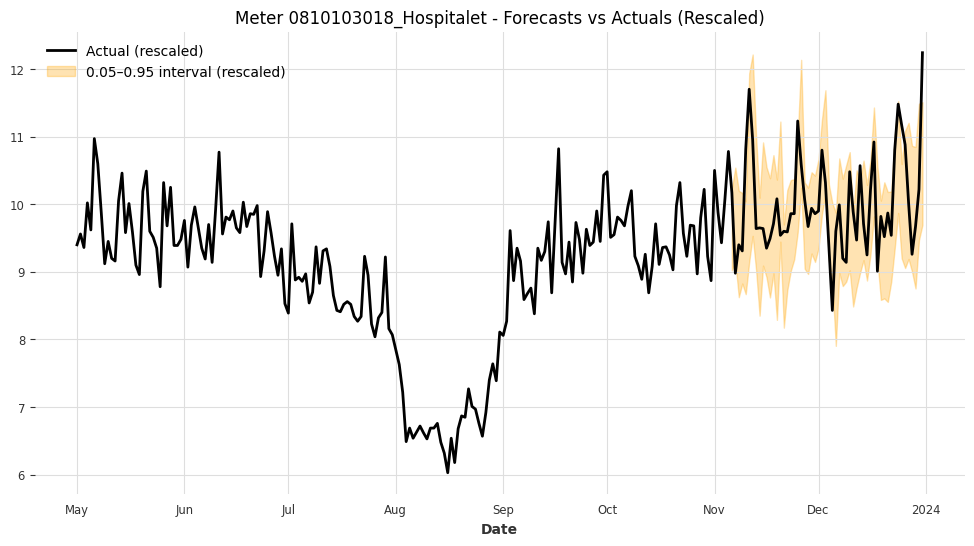

Meter 0810103018_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 1.6147



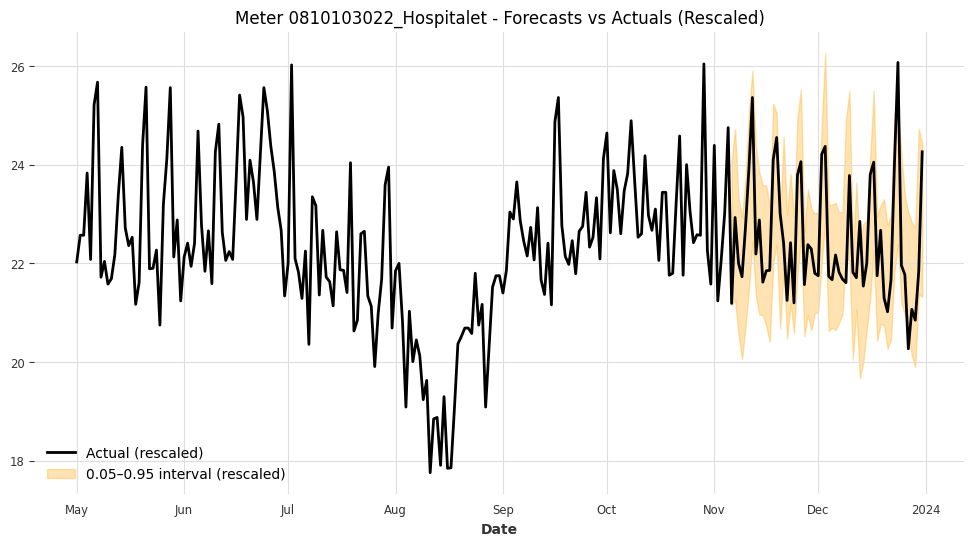

Meter 0810103022_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 2.7323



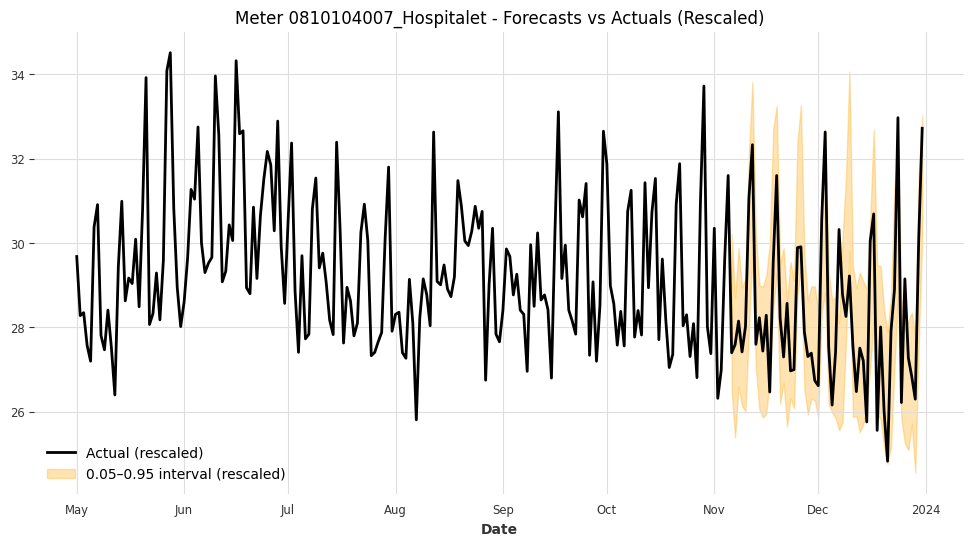

Meter 0810104007_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 3.3334



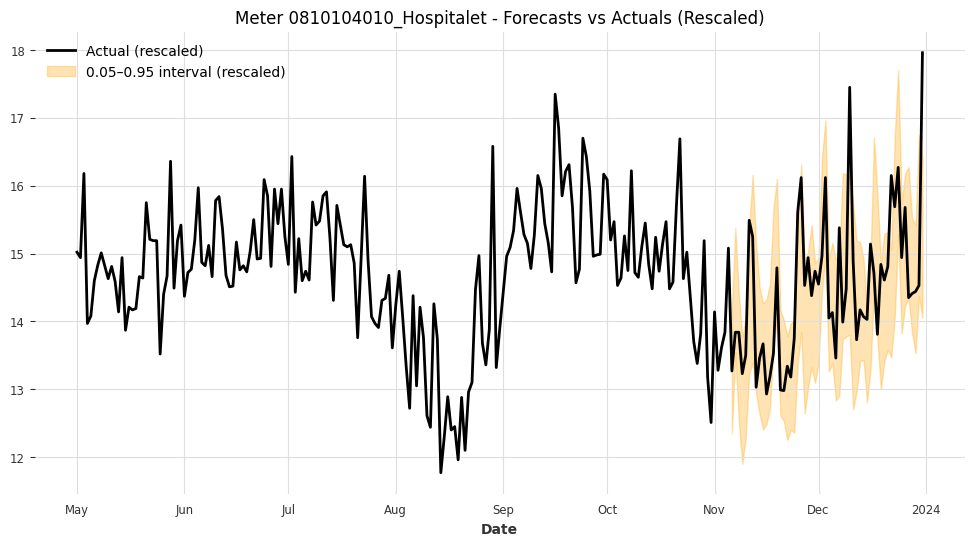

Meter 0810104010_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 1.9728



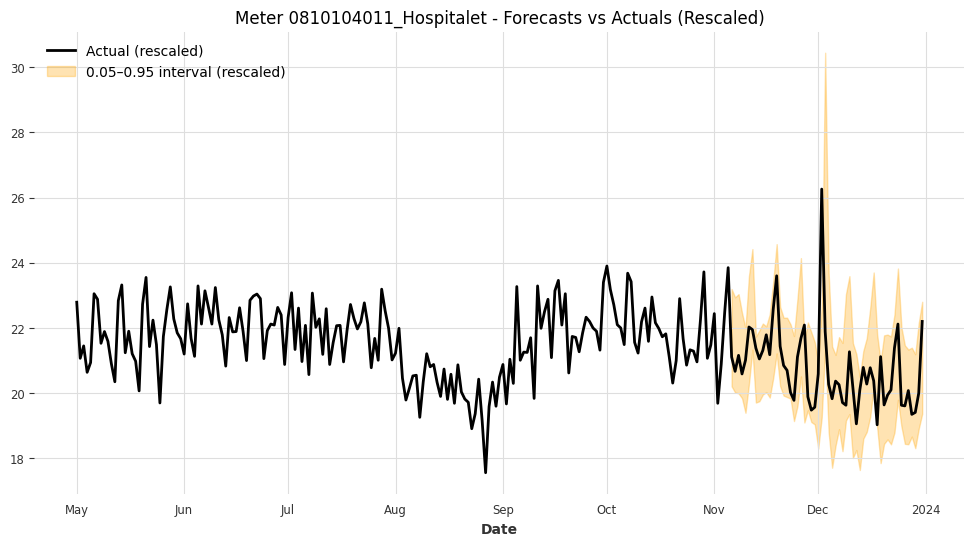

Meter 0810104011_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.1146



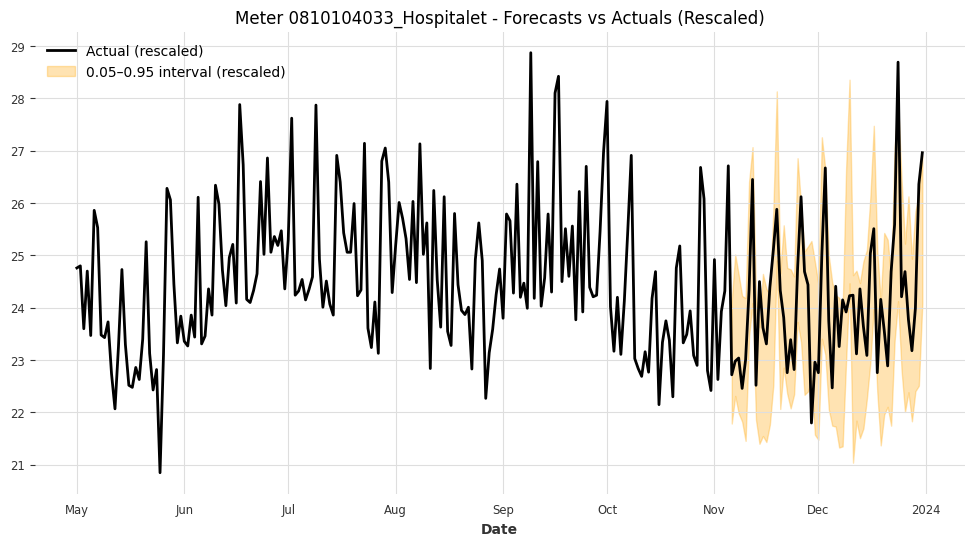

Meter 0810104033_Hospitalet - Coverage: 0.7679, Mean Interval Width (rescaled): 2.9966



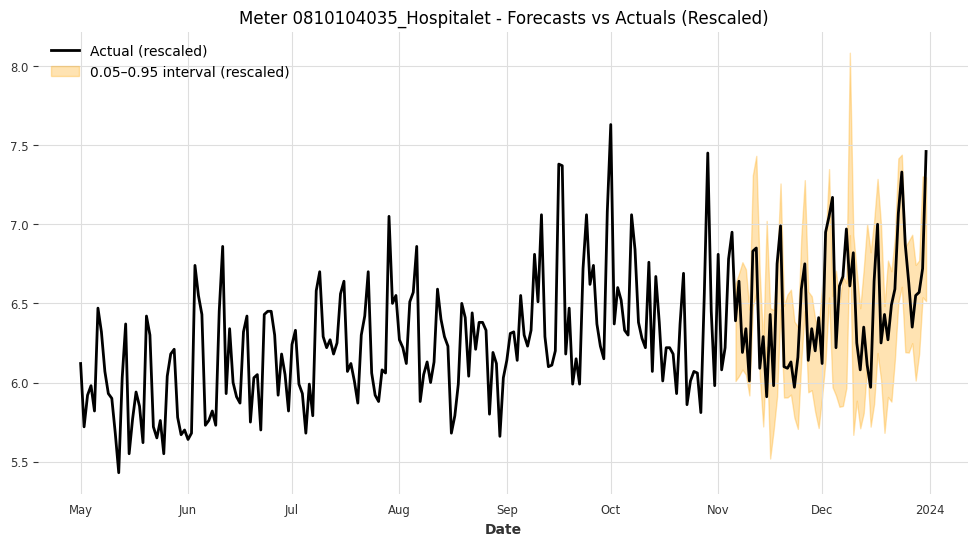

Meter 0810104035_Hospitalet - Coverage: 0.7857, Mean Interval Width (rescaled): 0.7704



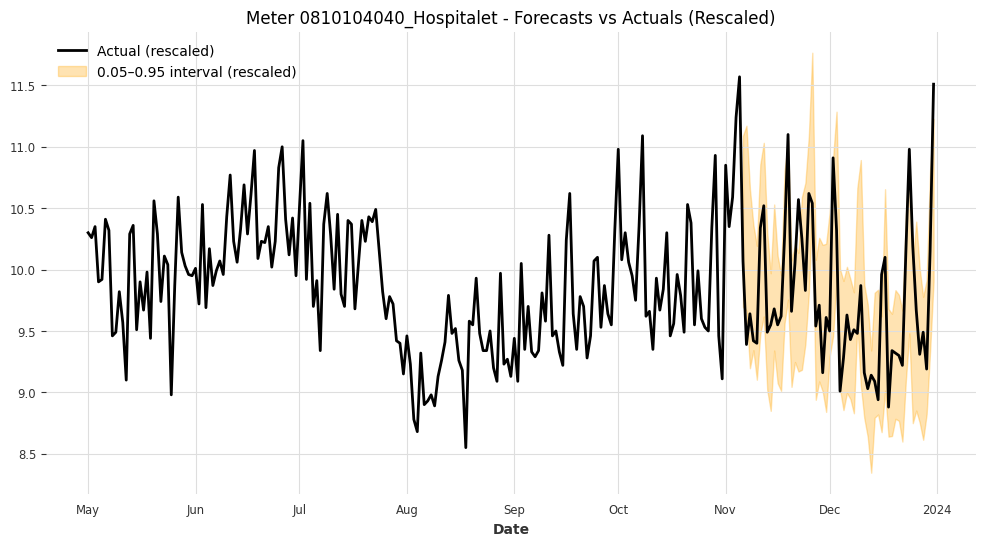

Meter 0810104040_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 1.2011



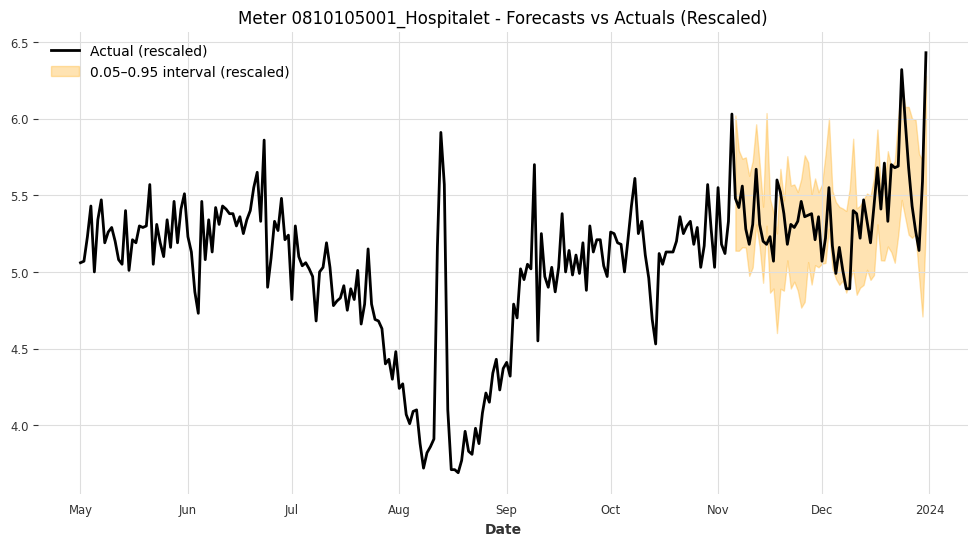

Meter 0810105001_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 0.6494



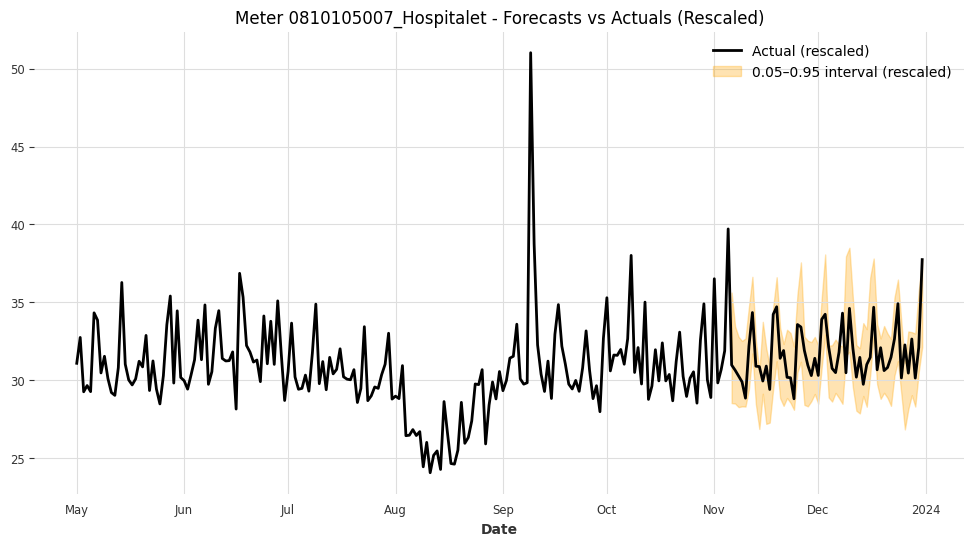

Meter 0810105007_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 4.6202



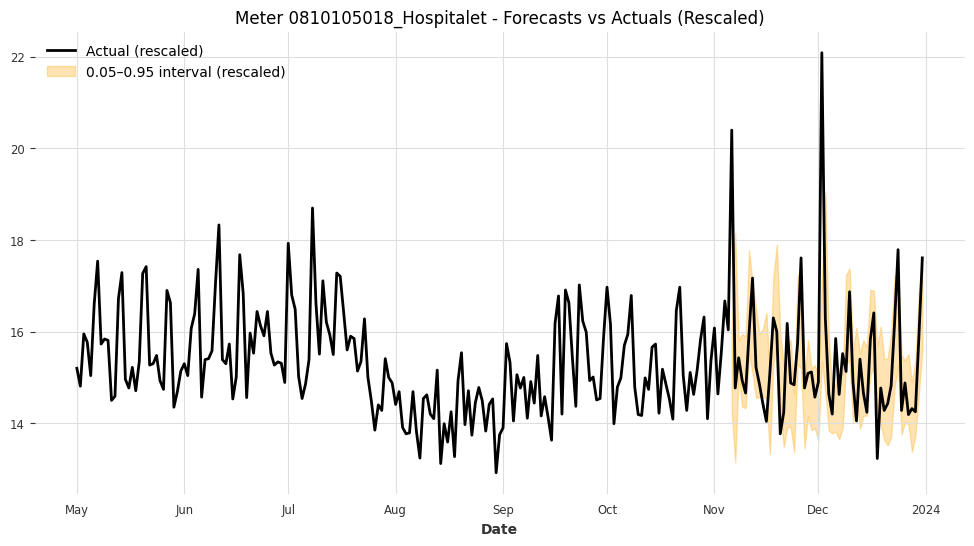

Meter 0810105018_Hospitalet - Coverage: 0.6964, Mean Interval Width (rescaled): 1.8056



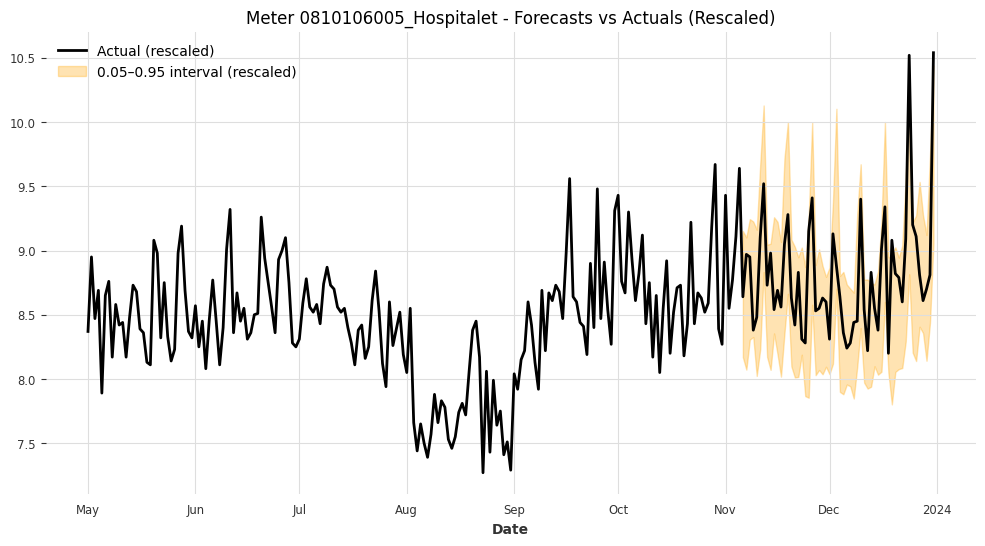

Meter 0810106005_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 1.0413



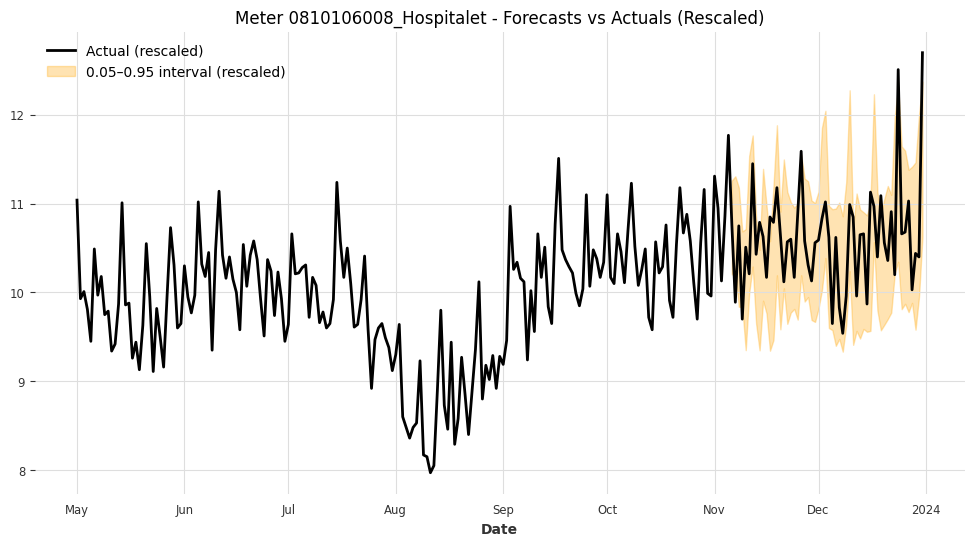

Meter 0810106008_Hospitalet - Coverage: 0.8036, Mean Interval Width (rescaled): 1.4618



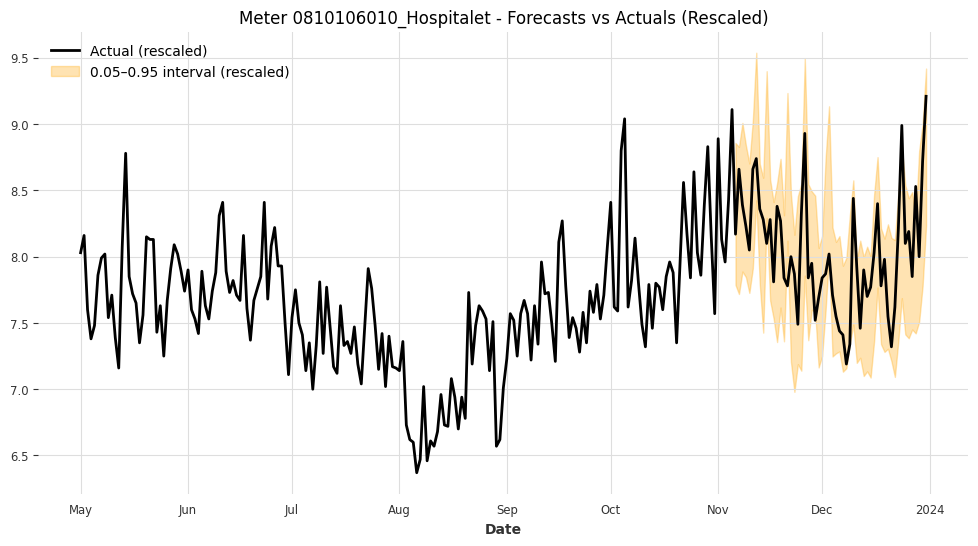

Meter 0810106010_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 1.0387



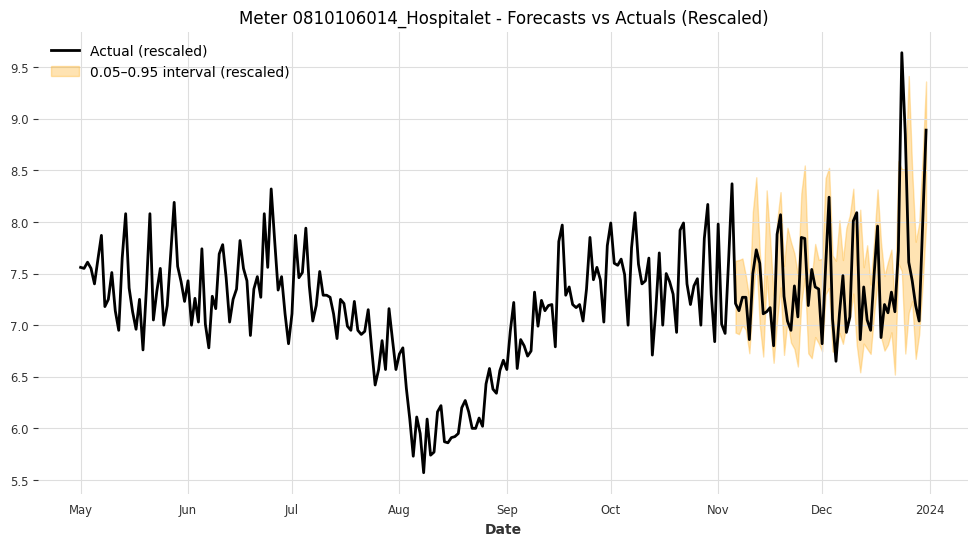

Meter 0810106014_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 0.9359



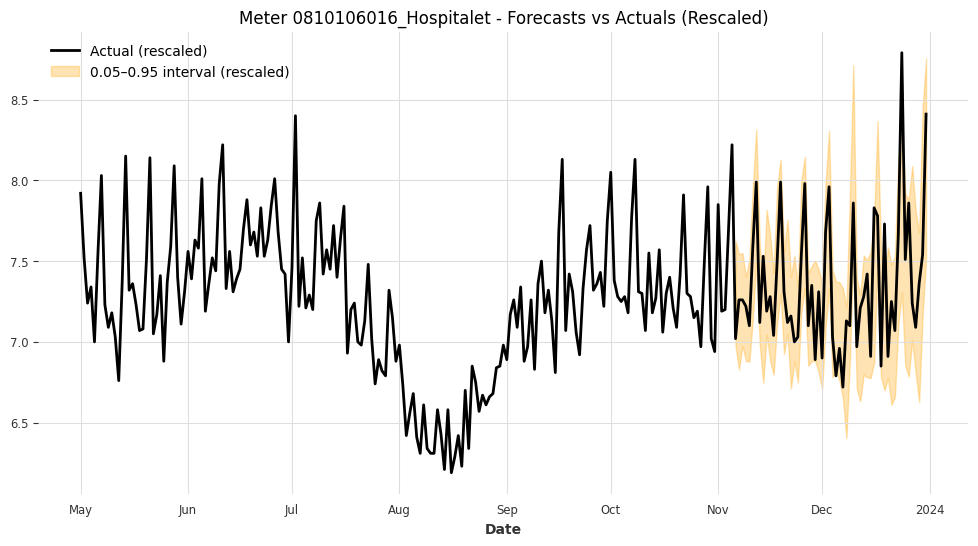

Meter 0810106016_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 0.7943



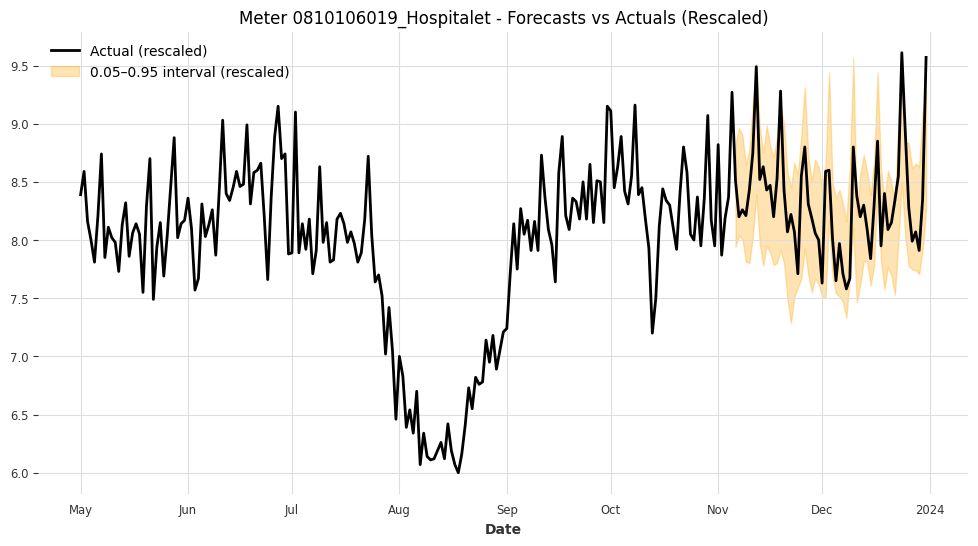

Meter 0810106019_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 0.9821



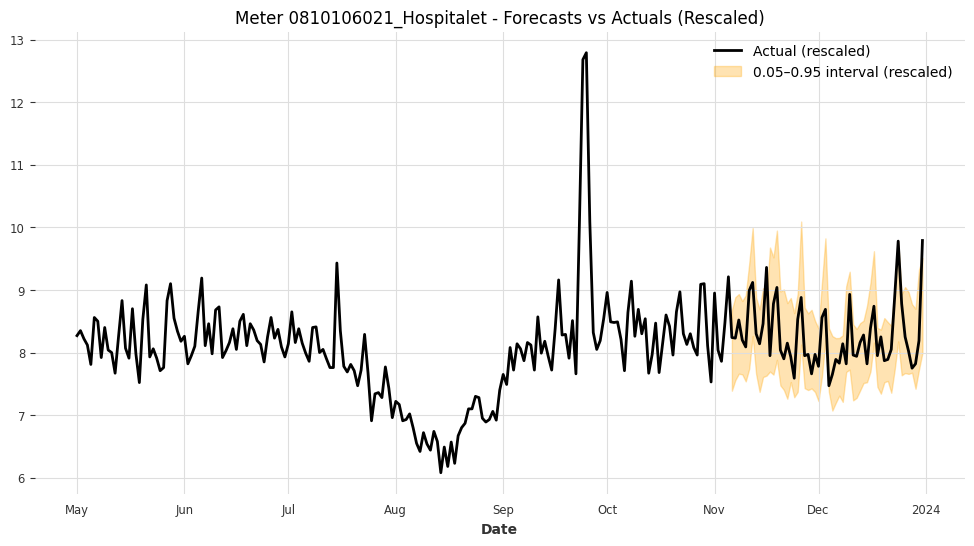

Meter 0810106021_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 1.3395



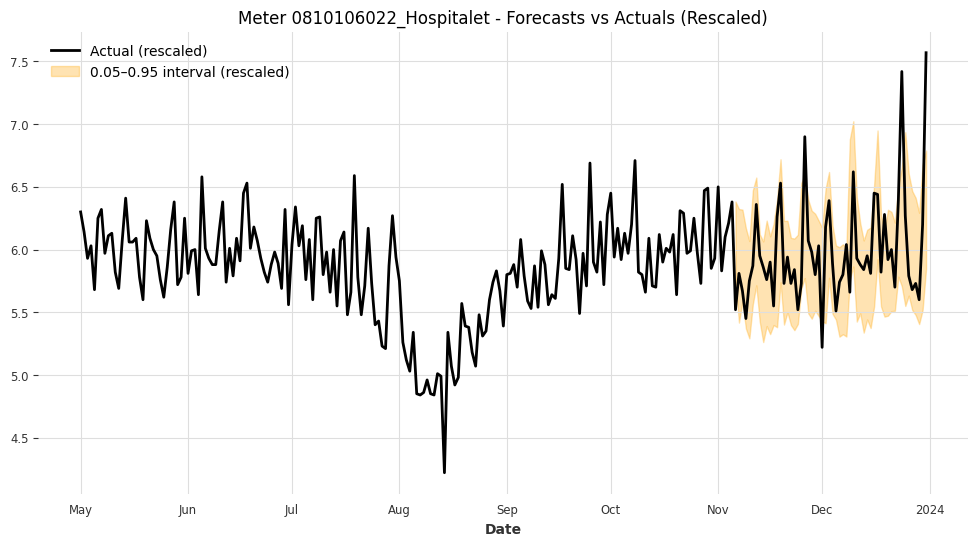

Meter 0810106022_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 0.8425



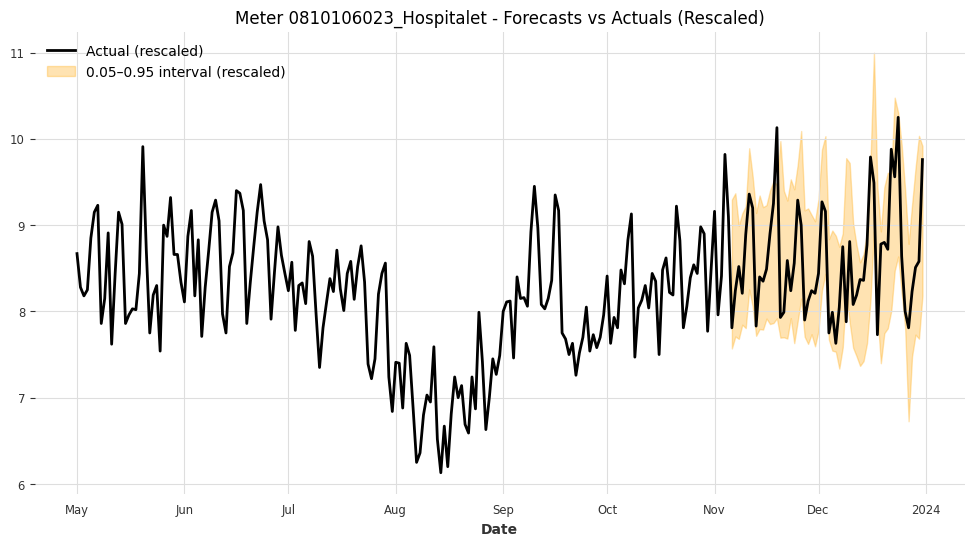

Meter 0810106023_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 1.5960



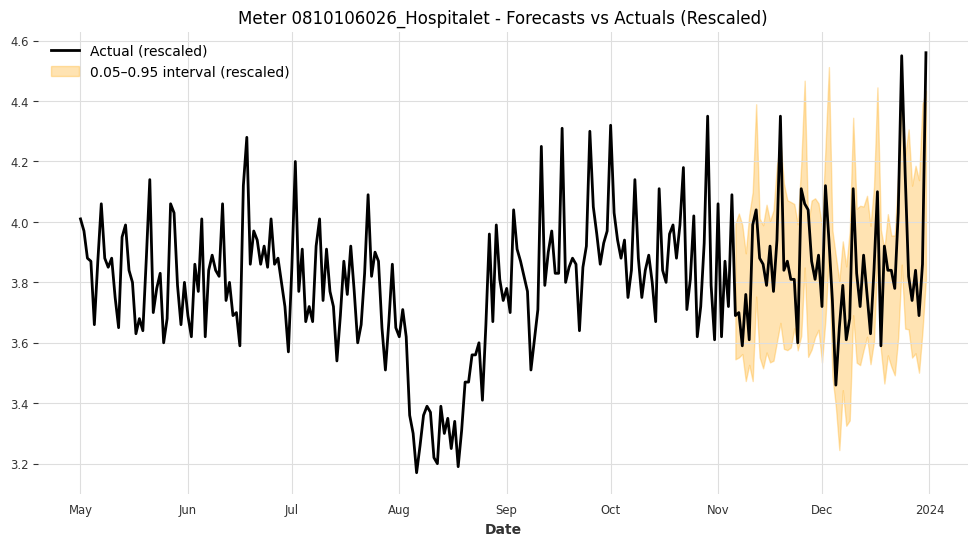

Meter 0810106026_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 0.5211



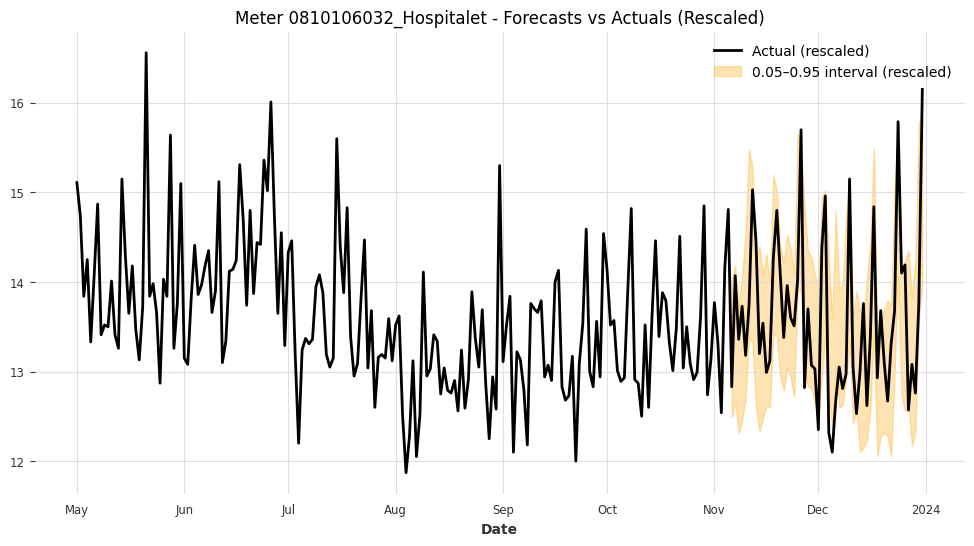

Meter 0810106032_Hospitalet - Coverage: 0.7500, Mean Interval Width (rescaled): 1.6323



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # We use this to merge forecast segments

for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")
